# Modelagem Preditiva para Análise de Crédito utilizando Aprendizado Sensível a Custo

# Resumo

# Introdução

# Instalando Pacotes

In [78]:
#pip install xgboost
#pip install hyperopt
#pip install shap

# Importando as bibliotecas

In [79]:
# Manipulação de Dados
import numpy as np
import pandas as pd


# Visualização
import matplotlib.pyplot as plt
import seaborn as sns


# Modelagem, Validação e Pipelines
from sklearn.model_selection import (
    train_test_split,
    StratifiedKFold,
    KFold,
    cross_val_score,
    cross_validate,
    cross_val_predict,
    RandomizedSearchCV,
    GridSearchCV
)

# Baseline
from sklearn.dummy import DummyClassifier

# Pipelines
from sklearn.pipeline import Pipeline
from imblearn.pipeline import Pipeline as ImbPipeline


# Modelos
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import (
    BaggingClassifier,
    RandomForestClassifier,
    AdaBoostClassifier,
    GradientBoostingClassifier
)
from xgboost import XGBClassifier


# Feature Selection
from sklearn.feature_selection import RFE, mutual_info_classif


# Pré-processamento
from sklearn.preprocessing import (
    StandardScaler,
    RobustScaler,
    MinMaxScaler,
    PowerTransformer
)


# Métricas e Avaliação
from sklearn.metrics import (
    roc_auc_score,
    roc_curve,
    precision_score,
    recall_score,
    f1_score,
    confusion_matrix,
    ConfusionMatrixDisplay,
    PrecisionRecallDisplay,
    RocCurveDisplay,
    average_precision_score,
    make_scorer,
    auc,
    precision_recall_curve
)


# Estatística
from scipy.stats import ks_2samp, randint, uniform


# Calibração
from sklearn.calibration import (
    calibration_curve,
    CalibratedClassifierCV
)


# Interpretação de Modelo
import shap


# Balanceamento de Classes
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler, TomekLinks
from imblearn.combine import SMOTETomek


# Otimização Bayesiana
from hyperopt import hp, fmin, tpe, Trials, STATUS_OK, space_eval


# Funções Auxiliares
import utils.aux_func as af
from utils.paths import DATA_RAW

# Configurações Gerais
import warnings
warnings.filterwarnings("ignore")

plt.rcParams["figure.dpi"] = 400
pd.set_option("display.max_columns", None)


# Importando a Base

In [80]:
df = pd.read_excel(DATA_RAW / "Base_Inadimplencia.xlsx", sheet_name="Base")
df.head(10)

,Idade,Sexo,Escolaridade,Tipo_Moradia,Saldo_Investimento,Saldo_Conta_Corrente,Valor_Emprestimo,Duracao_Emprestimo,Inadimplencia
0,67,M,Graduacao,Propria,Sem investimento,Pouco,1169,6,0
1,22,H,Graduacao,Propria,Pouco,Moderado,5951,48,1
2,49,M,Pos Graduacao,Propria,Pouco,Sem conta,2096,12,0
3,45,M,Graduacao,De favor,Pouco,Pouco,7882,42,0
4,53,M,Graduacao,De favor,Pouco,Pouco,4870,24,1
5,35,M,Pos Graduacao,De favor,Sem investimento,Sem conta,9055,36,0
6,53,M,Graduacao,Propria,Alto,Sem conta,2835,24,0
7,35,M,Ensino Medio,Alugada,Pouco,Moderado,6948,36,0
8,61,M,Pos Graduacao,Propria,Alto,Sem conta,3059,12,0
9,28,M,Ensino Medio,Propria,Pouco,Moderado,5234,30,1


In [81]:
df.shape

(1000, 9)

# Funções Auxiliares

In [82]:
# Seleção de Modelos
def ranking_resumido(df, metricas_interesse):
    """
    df = busca_modelo
    metricas_interesse = lista de métricas (ex: ["AUCROC", "KS", "F1"])
    
    Retorna DF no formato:
    | Modelo | Rank_AUCROC | Rank_KS | Rank_F1 | Total |
    """

    ranking_list = []

    # Copia para evitar modificar o original
    df_copy = df.copy()

    for metrica in metricas_interesse:

        col_teste = f"{metrica}_Teste"

        if col_teste not in df_copy.columns:
            raise ValueError(f"Coluna '{col_teste}' não encontrada no DF!")

        # Criando coluna de rank (maior valor é melhor)
        df_copy[f"Rank_{metrica}"] = df_copy[col_teste].rank(
            ascending=False, method="dense"
        ).astype(int)

        # Salva apenas o modelo e o rank
        ranking_list.append(df_copy[["Modelo", f"Rank_{metrica}"]])

    # Junta todos os ranks por "Modelo"
    df_merged = ranking_list[0]
    for df_next in ranking_list[1:]:
        df_merged = df_merged.merge(df_next, on="Modelo", how="inner")

    # Soma total de ranks
    col_rank_names = [f"Rank_{m}" for m in metricas_interesse]
    df_merged["Total"] = df_merged[col_rank_names].sum(axis=1)

    # Ordena pelo total (menor é melhor)
    df_merged = df_merged.sort_values("Total").reset_index(drop=True)

    return df_merged

# Pré-Processamento Básico

## Removendo Feature `Sexo` (Questões Éticas)

In [83]:
df.drop(columns=['Sexo'], inplace=True)

## Identificando as Variáveis

In [84]:
target = 'Inadimplencia'
num_vars = [col for col in df.columns if df[col].dtype in ['int64', 'float64'] and col != target]
cat_vars = [col for col in df.columns if (df[col].dtype == 'object' or str(df[col].dtype) == 'category') and col != target]

In [85]:
num_vars

['Idade', 'Valor_Emprestimo', 'Duracao_Emprestimo']

In [86]:
cat_vars

[]

In [87]:
dummy_vars = ['Saldo_Investimento', 'Saldo_Conta_Corrente']
ordinal_vars = ['Escolaridade', 'Tipo_Moradia']

## Codificando as Variáveis Categóricas

### Variáveis Dummy

In [88]:
df_dummies = pd.get_dummies(df[dummy_vars], drop_first=True, dtype=int)
df_dummies

,Saldo_Investimento_Moderado,Saldo_Investimento_Pouco,Saldo_Investimento_Sem investimento,Saldo_Conta_Corrente_Moderado,Saldo_Conta_Corrente_Pouco,Saldo_Conta_Corrente_Sem conta
0,0,0,1,0,1,0
1,0,1,0,1,0,0
2,0,1,0,0,0,1
3,0,1,0,0,1,0
4,0,1,0,0,1,0
...,...,...,...,...,...,...
995,0,1,0,0,0,1
996,0,1,0,0,1,0
997,0,1,0,0,0,1
998,0,1,0,0,1,0


### Mapeando as Variáveis Ordinais

In [89]:
# Dicionários de mapeamento conforme a ordem natural
map_escolaridade = {'Pos Graduacao':0, 'Graduacao':1, 'Ensino Medio':2}
map_tipo_moradia = {"Propria": 0, "Alugada": 1, "De favor": 2}


In [90]:
df_ordinals = df[ordinal_vars].copy()
df_ordinals['Escolaridade'] = df_ordinals['Escolaridade'].map(map_escolaridade)
df_ordinals['Tipo_Moradia'] = df_ordinals['Tipo_Moradia'].map(map_tipo_moradia)

In [91]:
df_ordinals

,Escolaridade,Tipo_Moradia
0,1,0
1,1,0
2,0,0
3,1,2
4,1,2
...,...,...
995,0,0
996,2,0
997,1,0
998,1,2


### Concatenando os DataFrames

In [92]:
df_final = pd.concat([df[num_vars], df_ordinals, df_dummies, df[target]], axis=1)
df_final

,Idade,Valor_Emprestimo,Duracao_Emprestimo,Escolaridade,Tipo_Moradia,Saldo_Investimento_Moderado,Saldo_Investimento_Pouco,Saldo_Investimento_Sem investimento,Saldo_Conta_Corrente_Moderado,Saldo_Conta_Corrente_Pouco,Saldo_Conta_Corrente_Sem conta,Inadimplencia
0,67,1169,6,1,0,0,0,1,0,1,0,0
1,22,5951,48,1,0,0,1,0,1,0,0,1
2,49,2096,12,0,0,0,1,0,0,0,1,0
3,45,7882,42,1,2,0,1,0,0,1,0,0
4,53,4870,24,1,2,0,1,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...
995,31,1736,12,0,0,0,1,0,0,0,1,0
996,40,3857,30,2,0,0,1,0,0,1,0,0
997,38,804,12,1,0,0,1,0,0,0,1,0
998,23,1845,45,1,2,0,1,0,0,1,0,1


In [93]:
# features
X = df_final.drop(target, axis=1)

# target
y = df_final[target]

In [94]:
X.shape

(1000, 11)

In [95]:
y.shape

(1000,)

## Separação das Bases Treino e Teste

In [96]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=42)

In [97]:
X_train.shape

(700, 11)

In [98]:
X_test.shape

(300, 11)

In [99]:
y_train.shape

(700,)

In [100]:
y_test.shape

(300,)

# Análise do Cenário Atual -> Aprovou crédito com 30% de Taxa de Inadimplência

A área de negócio forneceu estimativas financeiras consolidadas para cada tipo de resultado possível, permitindo construir uma matriz de custos (ou matriz de payoff) que representa o impacto monetário direto de cada decisão. Essas estimativas incorporam margem do produto, perdas esperadas por inadimplência, custo de cobrança e oportunidade de receita perdida. Com base nessas informações, a matriz de payoff adotada é a seguinte:

| Tipo de Decisão              | Descrição                                                                                                                                                                                                      | Valor (R$)    |
| ---------------------------- | -------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------- | ------------- |
| **Verdadeiro Positivo (TP)** | O modelo **aprova um cliente que realmente pagaria**, gerando lucro líquido médio equivalente à margem financeira da operação.                                                                                 | **+327,13**   |
| **Falso Positivo (FP)**      | O modelo **aprova um cliente que se tornará inadimplente**, resultando em prejuízo líquido composto pela perda do principal não recuperado (80% do valor médio) acrescida do custo administrativo de cobrança. | **–2.717,01**|
| **Falso Negativo (FN)**      | O modelo **nega um cliente que pagaria**, gerando um custo de oportunidade equivalente ao lucro líquido que teria sido obtido com a concessão do crédito.                                                      | **–327,13**   |
| **Verdadeiro Negativo (TN)** | O modelo **nega corretamente um cliente inadimplente**. Não há desembolso nem perda financeira adicional, sendo o impacto econômico tratado como neutro.                                                       | **0,00**      |


## Definindo a Matriz de Payoff

In [101]:
# PREMISSAS ECONÔMICAS DO MODELO

# Valor médio do empréstimo / limite concedido
VALOR_MEDIO_EMPRESTIMO = 3271.26  # R$

# Margem líquida média quando o cliente paga (juros + tarifas - custos)
MARGEM_LIQUIDA = 0.10  # 10%

# Recuperação média em casos de inadimplência
RECOVERY_RATE = 0.20  # 20%

# Custo médio administrativo / cobrança por default
CUSTO_COBRANCA = 100.00  # R$


In [102]:
# COMPONENTES DE GANHO / PERDA

# Lucro líquido esperado ao aprovar um cliente adimplente
LUCRO_CLIENTE_BOM = MARGEM_LIQUIDA * VALOR_MEDIO_EMPRESTIMO

# Prejuízo líquido ao aprovar um cliente inadimplente:
# - perda do principal não recuperado
# - custo administrativo de cobrança
PREJUIZO_CLIENTE_MAU = (
    (1 - RECOVERY_RATE) * VALOR_MEDIO_EMPRESTIMO
    + CUSTO_COBRANCA
)


In [103]:
# Matriz de Ganho de Crédito

CREDIT_GAIN_MATRIX = np.array([
    [  LUCRO_CLIENTE_BOM,   -LUCRO_CLIENTE_BOM],   # y_true = 0 → [Aprova, Nega]
    [ -PREJUIZO_CLIENTE_MAU,           0.00]       # y_true = 1 → [Aprova, Nega]
])


In [104]:
CREDIT_GAIN_MATRIX

array([[  327.126,  -327.126],
       [-2717.008,     0.   ]])

## Avaliando o cenário real

In [105]:
N = 1000
default_rate = 0.30
B = int(default_rate * N)
G = N - B

# cenário: aprovar tudo -> y_pred = 0 para todos
gain_total = LUCRO_CLIENTE_BOM * G + (-PREJUIZO_CLIENTE_MAU) * B
gain_mean = gain_total / N

print(f"Ganho total (aprovar tudo) = R$ {gain_total:,.2f}")
print(f"Ganho médio por cliente = R$ {gain_mean:,.2f}")

Ganho total (aprovar tudo) = R$ -586,114.20
Ganho médio por cliente = R$ -586.11


Como ponto de partida da análise, foi avaliado o cenário real atual de concessão de crédito, no qual 1.000 clientes são aprovados sem qualquer política de seleção, resultando em uma taxa de inadimplência de aproximadamente 30%. Ao aplicar a matriz de custos definida para o problema, esse cenário de aprovação irrestrita apresentou um ganho total negativo de `R$ −586.114,20`, o que corresponde a um prejuízo médio de `R$ −586,11` por cliente aprovado.

Esse resultado evidencia que, mesmo em um volume relativamente moderado de operações, a ausência de uma política de decisão baseada em risco gera uma destruição estrutural de valor. A análise reforça que o problema central não está apenas na existência de inadimplência, mas na falta de discriminação entre bons e maus pagadores, levando à alocação ineficiente de capital e à amplificação das perdas econômicas.

Esse diagnóstico inicial estabelece de forma clara a motivação para o desenvolvimento do modelo preditivo: substituir uma política de concessão indiferenciada por uma estratégia orientada a risco, capaz de reduzir perdas médias por cliente e melhorar a sustentabilidade econômica da carteira ao longo do tempo.

# Definindo a Métrica de Custo

No contexto de concessão de crédito, o problema de modelagem preditiva não envolve apenas a acurácia estatística, mas principalmente o impacto financeiro associado às decisões de aprovar ou negar um cliente. Trata-se, portanto, de um problema com **custos fixos por decisão**, no qual cada combinação entre previsão do modelo e comportamento real do cliente resulta em um ganho ou uma perda mensurável.

In [106]:
# Calcula o ganho financeiro total
def credit_gain_score(y_true, y_score, threshold=0.5, payoff_matrix=CREDIT_GAIN_MATRIX):
    """
    Calcula o ganho financeiro total usando probabilidades do modelo.
    Compatível com sklearn >= 1.4 (y_score vem via predict_proba).
    """

    y_true = np.asarray(y_true).astype(int)

    # Se y_score tiver shape (n,2), pegar prob. da classe positiva
    if y_score.ndim == 2:
        y_score = y_score[:, 1]

    y_pred = (y_score >= threshold).astype(int)

    gains = payoff_matrix[y_true, y_pred]

    return gains.sum()   # ganho total
    

# Criando o scorer 
def make_credit_gain_scorer(threshold=0.5, payoff_matrix=CREDIT_GAIN_MATRIX):
    """
    Retorna um scorer compatível com sklearn >= 1.4.
    Usa response_method="predict_proba".
    """

    def scorer_fn(y_true, y_score):
        return credit_gain_score(
            y_true=y_true,
            y_score=y_score,
            threshold=threshold,
            payoff_matrix=payoff_matrix
        )

    return make_scorer(
        scorer_fn,
        greater_is_better=True,
        response_method="predict_proba"   # substitui needs_proba
    )


# scorer pronto
credit_gain_scorer = make_credit_gain_scorer(threshold=0.5)

# Definindo um dicionário de scores

In [107]:
# definindo o score KS
ks_scorer = make_scorer(
    af.ks_stat,
    response_method="predict_proba"
)

# Controlando divisões por zero (evitando Warnings desnecessários)
precision_scorer = make_scorer(precision_score, zero_division=0)
recall_scorer = make_scorer(recall_score, zero_division=0)
f1_scorer = make_scorer(f1_score, zero_division=0)


# Dicionário de scores
scoring = {
    'AUC': 'roc_auc',
    'KS': ks_scorer,
    'F1': f1_scorer,
    'Recall': recall_scorer,
    'Precision': precision_scorer,
    'Credit_Gain': credit_gain_scorer
}

# Definindo a Estratégia de Validação para as análises

In [108]:
# Bases Estratificadas para classes desbalanceadas
cv = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

# Seleção do Modelo (Model Selection)

In [109]:
modelos = {
    "LogReg": LogisticRegression(max_iter=1000, random_state=42),
    "DecisionTree": DecisionTreeClassifier(random_state=42),
    "RandomForest": RandomForestClassifier(random_state=42),
    "BaggingLogReg": BaggingClassifier(estimator=LogisticRegression(max_iter=1000), random_state=42),
    "GradientBoost": GradientBoostingClassifier(random_state=42),
    "AdaBoost": AdaBoostClassifier(random_state=42),
    "XGBoost": XGBClassifier(eval_metric="logloss", random_state=42)
}

In [110]:
resultados = []

for nome, modelo in modelos.items():
    print(f"Rodando CV para modelo: {nome}...")
    
    res = cross_validate(
        modelo,
        X, y,
        cv=cv,
        scoring=scoring,
        return_train_score=True,
        n_jobs=-1,
    )
    
    linha = {"modelo": nome}

    linha["fit_time_mean"]  = np.mean(res["fit_time"])
    linha["fit_time_std"]   = np.std(res["fit_time"])

    linha["score_time_mean"] = np.mean(res["score_time"])
    linha["score_time_std"]  = np.std(res["score_time"])

    # Para cada métrica no scoring, salvar média e std
    for metric in scoring:
        
        linha[f"{metric}_train_mean"] = np.mean(res[f"train_{metric}"])
        linha[f"{metric}_train_std"]  = np.std(res[f"train_{metric}"])
        
        linha[f"{metric}_test_mean"]  = np.mean(res[f"test_{metric}"])
        linha[f"{metric}_test_std"]   = np.std(res[f"test_{metric}"])

    
    resultados.append(linha)

# tranansformar em dataframe
sel_modelo = pd.DataFrame(resultados)

Rodando CV para modelo: LogReg...
Rodando CV para modelo: DecisionTree...
Rodando CV para modelo: RandomForest...
Rodando CV para modelo: BaggingLogReg...
Rodando CV para modelo: GradientBoost...
Rodando CV para modelo: AdaBoost...
Rodando CV para modelo: XGBoost...


In [111]:
sel_modelo.T

,0,1,2,3,4,5,6
modelo,LogReg,DecisionTree,RandomForest,BaggingLogReg,GradientBoost,AdaBoost,XGBoost
fit_time_mean,0.0641,0.002534,0.09478,0.573165,0.084385,0.044341,0.086642
fit_time_std,0.004365,0.000639,0.009693,0.014881,0.005473,0.005483,0.077603
score_time_mean,0.006155,0.005837,0.015935,0.005543,0.006135,0.011609,0.008245
score_time_std,0.001286,0.00073,0.003376,0.003879,0.001767,0.002678,0.003143
AUC_train_mean,0.771565,1.0,1.0,0.770637,0.92516,0.792396,0.999939
AUC_train_std,0.00437,0.0,0.0,0.004336,0.003414,0.003918,0.00005
AUC_test_mean,0.751381,0.628571,0.746738,0.754381,0.756214,0.756,0.737286
AUC_test_std,0.038912,0.044999,0.023446,0.03722,0.038911,0.036492,0.028302
KS_train_mean,0.427831,1.0,1.0,0.430212,0.711746,0.483439,0.99545


In [112]:
# Ordenar 
sel_modelo = (
    sel_modelo
    .sort_values(by="Credit_Gain_test_mean", ascending=False)
    .reset_index(drop=True)
)

sel_modelo

,modelo,fit_time_mean,fit_time_std,score_time_mean,score_time_std,AUC_train_mean,AUC_train_std,AUC_test_mean,AUC_test_std,KS_train_mean,KS_train_std,KS_test_mean,KS_test_std,F1_train_mean,F1_train_std,F1_test_mean,F1_test_std,Recall_train_mean,Recall_train_std,Recall_test_mean,Recall_test_std,Precision_train_mean,Precision_train_std,Precision_test_mean,Precision_test_std,Credit_Gain_train_mean,Credit_Gain_train_std,Credit_Gain_test_mean,Credit_Gain_test_std
0,RandomForest,0.094780,0.009693,0.015935,0.003376,1.000000,0.000000,0.746738,0.023446,1.000000,0.000000,0.438095,0.045175,1.000000,0.000000,0.515787,0.076355,1.000000,0.000000,0.456667,0.102252,1.000000,0.000000,0.607139,0.036995,206089.3800,2.435001e-11,-26255.3004,6853.880636
1,XGBoost,0.086642,0.077603,0.008245,0.003143,0.999939,0.000050,0.737286,0.028302,0.995450,0.002976,0.443333,0.040093,0.995162,0.001490,0.516657,0.042523,0.990741,0.002485,0.470000,0.064031,0.999627,0.001119,0.582402,0.046762,199231.4348,1.881022e+03,-27040.4028,4447.513033
2,GradientBoost,0.084385,0.005473,0.006135,0.001767,0.925160,0.003414,0.756214,0.038911,0.711746,0.012206,0.463333,0.053199,0.747524,0.013174,0.520555,0.062940,0.650000,0.016993,0.446667,0.070238,0.879916,0.015508,0.629468,0.063181,-66369.9240,1.253239e+04,-27372.1036,5850.387435
3,DecisionTree,0.002534,0.000639,0.005837,0.000730,1.000000,0.000000,0.628571,0.044999,1.000000,0.000000,0.257143,0.089999,1.000000,0.000000,0.480168,0.059104,1.000000,0.000000,0.480000,0.076303,1.000000,0.000000,0.489932,0.076320,206089.3800,2.435001e-11,-29692.8360,6220.361387
4,LogReg,0.064100,0.004365,0.006155,0.001286,0.771565,0.004370,0.751381,0.038912,0.427831,0.012364,0.453810,0.081707,0.491198,0.009308,0.456899,0.081884,0.400000,0.009658,0.370000,0.083600,0.636356,0.007793,0.608608,0.084699,-274433.2644,7.275656e+03,-33097.8204,6815.816118
5,AdaBoost,0.044341,0.005483,0.011609,0.002678,0.792396,0.003918,0.756000,0.036492,0.483439,0.008436,0.464286,0.085110,0.508419,0.017531,0.450163,0.048547,0.431852,0.023669,0.376667,0.051747,0.619205,0.015854,0.566873,0.069994,-257674.9408,1.541637e+04,-33666.6472,4235.116291
6,BaggingLogReg,0.573165,0.014881,0.005543,0.003879,0.770637,0.004336,0.754381,0.037220,0.430212,0.013984,0.460476,0.070792,0.484630,0.012509,0.447033,0.064607,0.394074,0.017931,0.360000,0.066332,0.630435,0.012935,0.599426,0.074568,-279303.8788,1.064955e+04,-34043.7732,5447.001933


In [113]:
import matplotlib.pyplot as plt

def plot_metricas_modelos(df, metrica):
    """
    Gera dois gráficos para uma métrica:
    - Gráfico 1: média da métrica (Treino e Teste)
    - Gráfico 2: desvio padrão da métrica (Treino e Teste)
    
    df: DataFrame no formato da saída consolidada do cross_validate
    metrica: string do nome da métrica, exemplo 'AUC', 'F1', 'KS', etc.
    """

    # ========= CONFIGURAÇÕES =========
    model_names = df["modelo"]

    # valores médios
    train_mean = df[f"{metrica}_train_mean"]
    test_mean  = df[f"{metrica}_test_mean"]

    # desvios padrão
    train_std = df[f"{metrica}_train_std"]
    test_std  = df[f"{metrica}_test_std"]

    # ========= FIGURA / SUBPLOTS =========
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    # =====================================================
    #  GRÁFICO 1 — MÉDIA DAS MÉTRICAS (treino vs teste)
    # =====================================================
    axes[0].plot(model_names, train_mean, linestyle="--", marker="o",
                 color="orange", label="Treino")
    axes[0].plot(model_names, test_mean, linestyle="-", marker="o",
                 color="blue", label="Teste")

    axes[0].set_title(f"Média da Métrica: {metrica}")
    axes[0].set_xlabel("Modelos")
    axes[0].set_ylabel(metrica)
    axes[0].legend()
    axes[0].grid(True, linestyle="--", alpha=0.4)
    axes[0].tick_params(axis='x', rotation=45)

    # =====================================================
    #  GRÁFICO 2 — DESVIO PADRÃO (treino vs teste)
    # =====================================================
    axes[1].plot(model_names, train_std, linestyle="--", marker="o",
                 color="orange", label="Treino Std")
    axes[1].plot(model_names, test_std, linestyle="-", marker="o",
                 color="blue", label="Teste Std")

    axes[1].set_title(f"Desvio Padrão da Métrica: {metrica}")
    axes[1].set_xlabel("Modelos")
    axes[1].set_ylabel("Desvio Padrão")
    axes[1].legend()
    axes[1].grid(True, linestyle="--", alpha=0.4)
    axes[1].tick_params(axis='x', rotation=45)

    plt.tight_layout()
    plt.show()


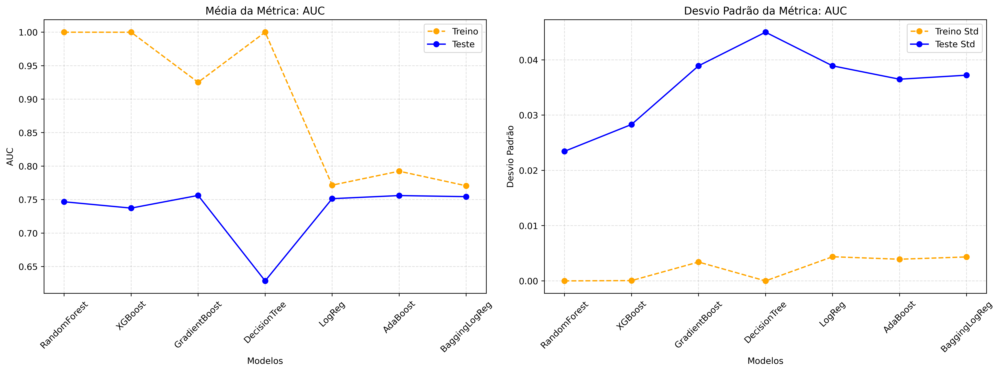

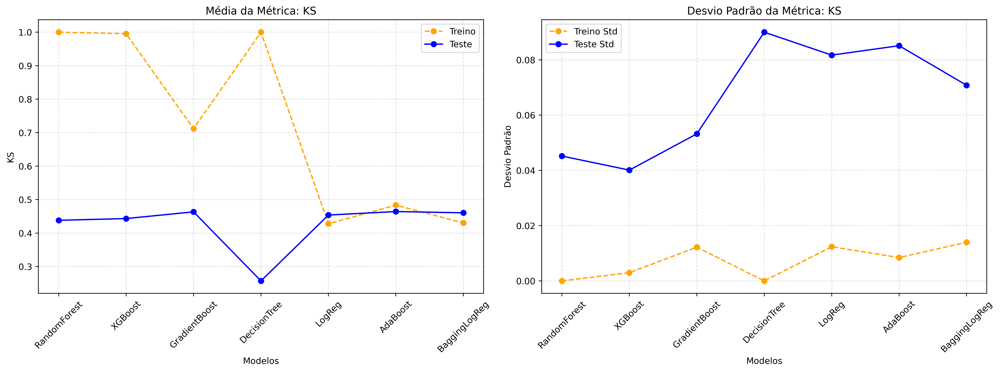

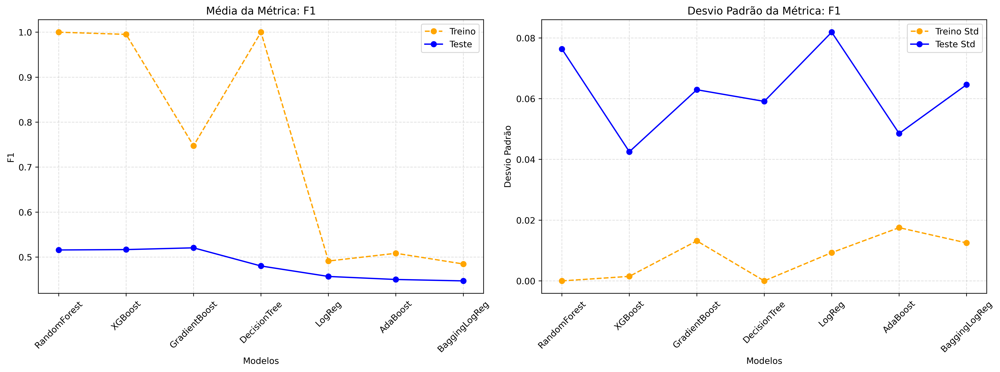

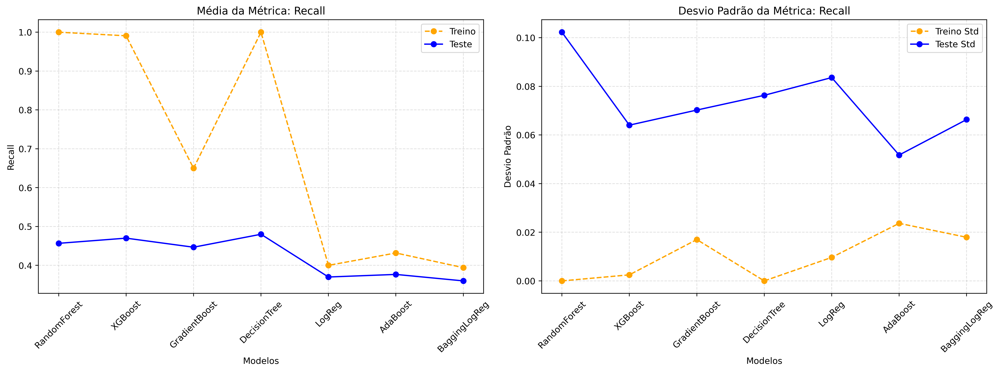

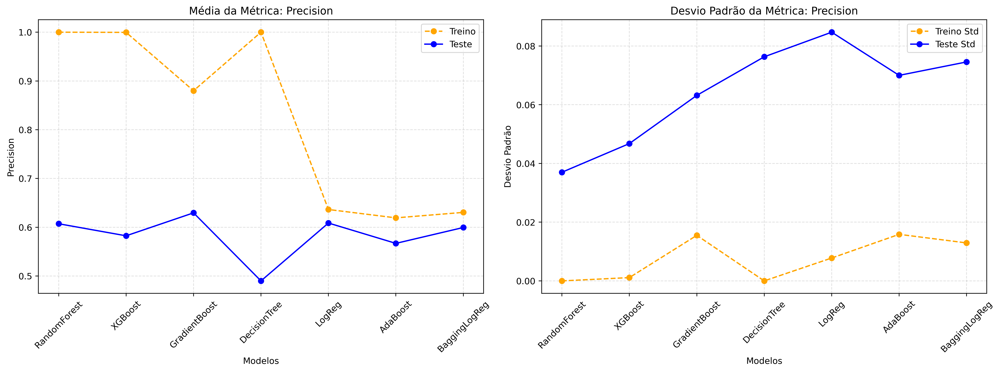

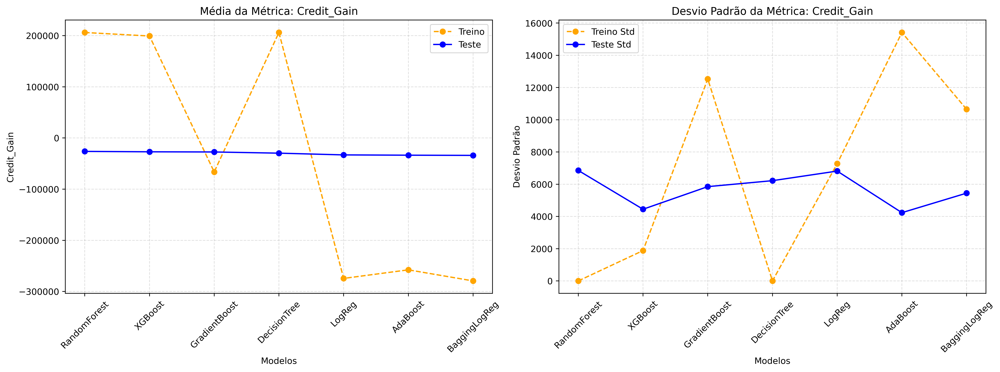

In [114]:
metricas = ["AUC", "KS", "F1", "Recall", "Precision", "Credit_Gain"]

for m in metricas:
    plot_metricas_modelos(sel_modelo, m)


In [115]:
def plot_times_line_advanced(df):
    model_names = df["modelo"]

    fit_mean = df["fit_time_mean"]
    fit_std  = df["fit_time_std"]

    score_mean = df["score_time_mean"]
    score_std  = df["score_time_std"]

    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    # ====================================================
    # FIT TIME
    # ====================================================
    axes[0].plot(model_names, fit_mean, marker="o", linestyle="-", color="orange", label="Fit Time")
    axes[0].fill_between(model_names, fit_mean-fit_std, fit_mean+fit_std, 
                         color="orange", alpha=0.2)

    axes[0].set_title("Fit Time (Treinamento)")
    axes[0].set_ylabel("Tempo (s)")
    axes[0].tick_params(axis="x", rotation=45)
    axes[0].grid(True, linestyle="--", alpha=0.4)

    # log scale se necessário
    if fit_mean.max() / fit_mean.min() > 5:
        axes[0].set_yscale("log")

    # ====================================================
    # SCORE TIME
    # ====================================================
    axes[1].plot(model_names, score_mean, marker="o", linestyle="-", color="blue", label="Score Time")
    axes[1].fill_between(model_names, score_mean-score_std, score_mean+score_std, 
                         color="blue", alpha=0.2)

    axes[1].set_title("Score Time (Predição)")
    axes[1].set_ylabel("Tempo (s)")
    axes[1].tick_params(axis="x", rotation=45)
    axes[1].grid(True, linestyle="--", alpha=0.4)

    if score_mean.max() / score_mean.min() > 5:
        axes[1].set_yscale("log")

    plt.tight_layout()
    plt.show()


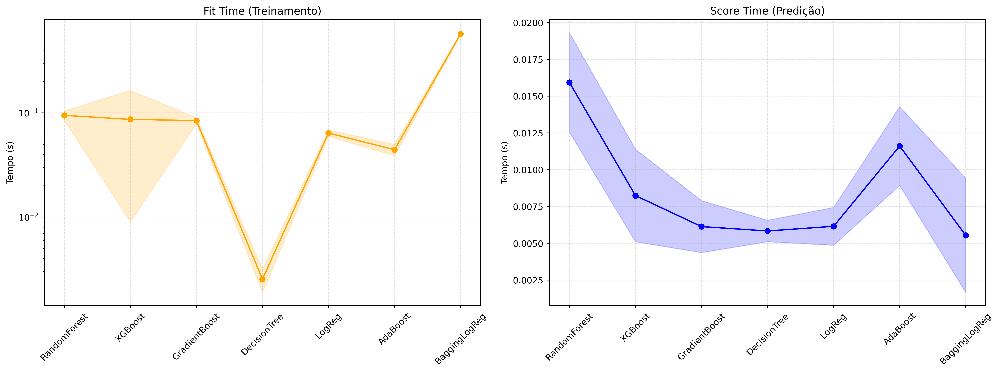

In [116]:
plot_times_line_advanced(sel_modelo)

## Modelo de Regressão Logística

In [117]:
# Definindo o grid de parâmetros
C_values = [0.01, 0.1, 1, 10, 100]

param_grid_rlog = [

    # ---------------------------------------------
    # L1 + solver compatível: liblinear ou saga
    # ---------------------------------------------
    {
        "penalty": ["l1"],
        "solver": ["liblinear", "saga"],
        "C": C_values,
        "max_iter": [200, 300, 500, 800]
    },

    # ---------------------------------------------
    # L2 + solvers mais estáveis
    # ---------------------------------------------
    {
        "penalty": ["l2"],
        "solver": ["lbfgs", "newton-cg", "sag", "saga"],
        "C": C_values,
        "max_iter": [200, 300, 500, 800]
    },

    # ---------------------------------------------
    # ElasticNet → precisa do solver saga
    # ---------------------------------------------
    {
        "penalty": ["elasticnet"],
        "solver": ["saga"],
        "l1_ratio": uniform(0, 1),
        "C": C_values,
        "max_iter": [200, 300, 500, 800]
    }
]

In [118]:
# 
scaler = StandardScaler()
scaler.fit(X_train)
X_train_s = scaler.transform(X_train)
X_test_s = scaler.transform(X_test)

In [119]:
# Instanciando o Modelo
clf_rlog = LogisticRegression(
    max_iter=4000,
    random_state=42
)

rs_logit = RandomizedSearchCV(
    estimator=clf_rlog,
    param_distributions=param_grid_rlog,
    n_iter=50,                   
    scoring=scoring,
    cv=cv,
    refit="Credit_Gain",
    random_state=42,
    n_jobs=-1
)


# Ajustando o Modelo
rs_logit.fit(X_train_s, y_train)

# Avaliando o Desempenho do Modelo
rlog_desempenho = af.calcula_desempenho(
    rs_logit.best_estimator_,
    X_train_s, y_train,
    X_test_s, y_test
)

rlog_desempenho

,Treino,Teste,Variação
Acurácia,0.750000,0.740000,-0.01
AUCROC,0.767658,0.772063,0.01
KS,0.418367,0.453968,0.09
Precision,0.642276,0.607143,-0.05
Recall,0.376190,0.377778,0.00
F1,0.474474,0.465753,-0.02


## Métodos Ensemble - Boosting

#### AdaBoost

In [120]:
# definindo
param_grid_ada = {
    "n_estimators": randint(50, 400),
    "learning_rate": uniform(0.01, 1.0),
    "estimator__max_depth": randint(1, 4),
    "estimator__min_samples_split": randint(2, 20),
    "estimator__min_samples_leaf": randint(1, 10),
}


In [121]:
# iniciando a árvore base
base_tree = DecisionTreeClassifier(
    random_state=42
)

# Definindo o AdaBoost
clf_ada = AdaBoostClassifier(
    estimator=base_tree,
    random_state=42
)

# Buscando os Melhores  Parâmetros
rs_ada = RandomizedSearchCV(
    estimator=clf_ada,
    n_iter=50,
    param_distributions=param_grid_ada,
    scoring=scoring,
    refit='Credit_Gain',
    cv=cv,
    n_jobs=-1,
)

# Treinando o modelo
rs_ada.fit(X_train, y_train)

# Avaliando o Desempenho
ada_desempenho = af.calcula_desempenho(
    rs_ada.best_estimator_,
    X_train, y_train,
    X_test, y_test
)

ada_desempenho

,Treino,Teste,Variação
Acurácia,0.910000,0.730000,-0.20
AUCROC,0.971555,0.725608,-0.25
KS,0.814966,0.388889,-0.52
Precision,0.893048,0.569231,-0.36
Recall,0.795238,0.411111,-0.48
F1,0.841310,0.477419,-0.43


#### XGBoost

In [122]:
param_grid_xgb = {
    "n_estimators": [50, 200, 500],
    "max_depth": randint(1,5),
    "learning_rate": [0.01, 0.05, 0.1, 1],
    "subsample": [0.5, 0.7, 1.0],
    "colsample_bytree": [0.5, 0.7, 1.0]
}

In [123]:
# Instanciando o Modelo
clf_xgb = XGBClassifier(
    eval_metric="logloss",
    random_state=42
)

# Buscando os Melhores Parametros
rs_xgb = RandomizedSearchCV(
    estimator=clf_xgb,
    param_distributions=param_grid_xgb,
    scoring=scoring,
    refit="Credit_Gain",
    cv=cv,
    n_jobs=-1
)

# Ajustando o Modelo
rs_xgb.fit(X_train, y_train)

# Avaliando o Desempenho
xgb_desempenho = af.calcula_desempenho(
    rs_xgb.best_estimator_,
    X_train, y_train,
    X_test, y_test
)

xgb_desempenho

,Treino,Teste,Variação
Acurácia,0.938571,0.740000,-0.21
AUCROC,0.975199,0.758624,-0.22
KS,0.861905,0.388889,-0.55
Precision,0.951351,0.585714,-0.38
Recall,0.838095,0.455556,-0.46
F1,0.891139,0.512500,-0.42


## Escolhendo o Modelo

In [124]:
resultados = {
    "Regressão Logistica": rlog_desempenho,
    "AdaBoost": ada_desempenho,
    "XGBoost": xgb_desempenho
}

In [125]:
dfs = []

for nome_modelo, df in resultados.items():
    df_temp = df.copy()
    df_temp["Modelo"] = nome_modelo   # Adiciona coluna do modelo
    dfs.append(df_temp)

df_desempenhos = pd.concat(dfs, axis=0)
df_desempenhos = df_desempenhos.reset_index().rename(columns={"index": "Métrica"})
df_desempenhos

,Métrica,Treino,Teste,Variação,Modelo
0,Acurácia,0.750000,0.740000,-0.01,Regressão Logistica
1,AUCROC,0.767658,0.772063,0.01,Regressão Logistica
2,KS,0.418367,0.453968,0.09,Regressão Logistica
3,Precision,0.642276,0.607143,-0.05,Regressão Logistica
4,Recall,0.376190,0.377778,0.00,Regressão Logistica
5,F1,0.474474,0.465753,-0.02,Regressão Logistica
6,Acurácia,0.910000,0.730000,-0.20,AdaBoost
7,AUCROC,0.971555,0.725608,-0.25,AdaBoost
8,KS,0.814966,0.388889,-0.52,AdaBoost
9,Precision,0.893048,0.569231,-0.36,AdaBoost


In [126]:
# Transformando os DataFrames
# Treino
desemp_treino = pd.pivot(
    data=df_desempenhos,
    index="Modelo",
    columns='Métrica',
    values='Treino'
)

desemp_treino.rename(columns={
    'AUCROC': 'AUCROC_Treino',
    'Acurácia': 'Acurácia_Treino',
    'F1':'F1_Treino',
    'KS':'KS_Treino',
    'Precision':'Precision_Treino',
    'Recall':'Recall_Treino'
}, inplace= True)

# Teste
desemp_teste = pd.pivot(
    data=df_desempenhos,
    index="Modelo",
    columns='Métrica',
    values='Teste'
)

desemp_teste.rename(columns={
    'AUCROC': 'AUCROC_Teste',
    'Acurácia': 'Acurácia_Teste',
    'F1': 'F1_Teste',
    'KS': 'KS_Teste',
    'Precision': 'Precision_Teste',
    'Recall': 'Recall_Teste'
}, inplace=True)

# Variação
desemp_variacao = pd.pivot(
    data=df_desempenhos,
    index="Modelo",
    columns='Métrica',
    values='Variação'
)

desemp_variacao.rename(columns={
    'AUCROC': 'AUCROC_Variacao',
    'Acurácia': 'Acurácia_Variacao',
    'F1': 'F1_Variacao',
    'KS': 'KS_Variacao',
    'Precision': 'Precision_Variacao',
    'Recall': 'Recall_Variacao'
}, inplace=True)


In [127]:
busca_modelo = pd.concat([desemp_treino, desemp_teste, desemp_variacao], axis=1)
busca_modelo.reset_index(inplace=True)
busca_modelo

Métrica,Modelo,AUCROC_Treino,Acurácia_Treino,F1_Treino,KS_Treino,Precision_Treino,Recall_Treino,AUCROC_Teste,Acurácia_Teste,F1_Teste,KS_Teste,Precision_Teste,Recall_Teste,AUCROC_Variacao,Acurácia_Variacao,F1_Variacao,KS_Variacao,Precision_Variacao,Recall_Variacao
0,AdaBoost,0.971555,0.910000,0.841310,0.814966,0.893048,0.795238,0.725608,0.73,0.477419,0.388889,0.569231,0.411111,-0.25,-0.20,-0.43,-0.52,-0.36,-0.48
1,Regressão Logistica,0.767658,0.750000,0.474474,0.418367,0.642276,0.376190,0.772063,0.74,0.465753,0.453968,0.607143,0.377778,0.01,-0.01,-0.02,0.09,-0.05,0.00
2,XGBoost,0.975199,0.938571,0.891139,0.861905,0.951351,0.838095,0.758624,0.74,0.512500,0.388889,0.585714,0.455556,-0.22,-0.21,-0.42,-0.55,-0.38,-0.46


In [128]:
def highlight_max(s):
    is_max = s == s.max()
    return ['background-color: #90ee90' if v else '' for v in is_max]

best_test = desemp_teste.style.apply(highlight_max, axis=0)\
                         .set_caption("Desempenho dos Modelos no Teste – Destaque para os Melhores")
best_test

Métrica,AUCROC_Teste,Acurácia_Teste,F1_Teste,KS_Teste,Precision_Teste,Recall_Teste
Modelo,,,,,,
AdaBoost,0.725608,0.730000,0.477419,0.388889,0.569231,0.411111
Regressão Logistica,0.772063,0.740000,0.465753,0.453968,0.607143,0.377778
XGBoost,0.758624,0.740000,0.512500,0.388889,0.585714,0.455556


In [129]:
def highlight_min_abs(s):
    abs_vals = s.abs()                 # calcula valor absoluto
    min_abs = abs_vals.min()           # menor valor absoluto da coluna
    return ['background-color: #add8e6' if abs(v) == min_abs else '' for v in s]


train_test_var = desemp_variacao.style.apply(highlight_min_abs, axis=0)\
                         .set_caption("Variação entre Treino e Teste – Destaque para os Melhores")

train_test_var

Métrica,AUCROC_Variacao,Acurácia_Variacao,F1_Variacao,KS_Variacao,Precision_Variacao,Recall_Variacao
Modelo,,,,,,
AdaBoost,-0.250000,-0.200000,-0.430000,-0.520000,-0.360000,-0.480000
Regressão Logistica,0.010000,-0.010000,-0.020000,0.090000,-0.050000,0.000000
XGBoost,-0.220000,-0.210000,-0.420000,-0.550000,-0.380000,-0.460000


In [130]:
metricas = ["AUCROC","Acurácia", "KS", "F1", "Precision", "Recall"]
df_rank_final = ranking_resumido(busca_modelo, metricas)
df_rank_final

Métrica,Modelo,Rank_AUCROC,Rank_Acurácia,Rank_KS,Rank_F1,Rank_Precision,Rank_Recall,Total
0,XGBoost,2,1,2,1,2,1,9
1,Regressão Logistica,1,1,1,3,1,3,10
2,AdaBoost,3,2,2,2,3,2,14


In [131]:
import matplotlib.pyplot as plt

def plot_metricas_modelo_simples(df, metrica):
    """
    Plota APENAS os dois gráficos para uma métrica específica:
    - Treino vs Teste
    - Variação
    
    df: DataFrame no formato busca_modelo
    metrica: string (ex: "AUCROC", "KS", "F1")
    """

    # Nomes das colunas esperadas
    col_train = f"{metrica}_Treino"
    col_test  = f"{metrica}_Teste"
    col_var   = f"{metrica}_Variacao"

    # Validando existência das colunas
    for col in [col_train, col_test, col_var]:
        if col not in df.columns:
            raise ValueError(f"Coluna '{col}' não encontrada no DF!")

    modelos = df["Modelo"].tolist()

    # Criando a figura com dimensão maior
    fig, axes = plt.subplots(1, 2, figsize=(18, 6))
    fig.suptitle(f"Métrica: {metrica}", fontsize=18)
    plt.subplots_adjust(top=0.88, wspace=0.25)

    # --- GRÁFICO 1: TREINO VS TESTE ---
    ax1 = axes[0]
    ax1.plot(modelos, df[col_train], marker="o", label="Treino")
    ax1.plot(modelos, df[col_test], marker="o", label="Teste")
    ax1.set_title(f"{metrica} – Treino vs Teste")
    ax1.set_xlabel("Modelos")
    ax1.set_ylabel(metrica)
    ax1.grid(True)
    ax1.legend()
    ax1.tick_params(axis='x', rotation=45)

    # --- GRÁFICO 2: VARIAÇÃO ---
    ax2 = axes[1]
    ax2.plot(modelos, df[col_var], marker="o", color="tab:green")
    ax2.axhline(0, linestyle="--", linewidth=1)
    ax2.axhline(0.05, linestyle="--", linewidth=1)
    ax2.axhline(-0.05, linestyle="--", linewidth=1)
    ax2.set_title(f"{metrica} – Variação (Teste - Treino)")
    ax2.set_xlabel("Modelos")
    ax2.set_ylabel("Variação")
    ax2.grid(True)
    ax2.tick_params(axis='x', rotation=45)

    plt.show()


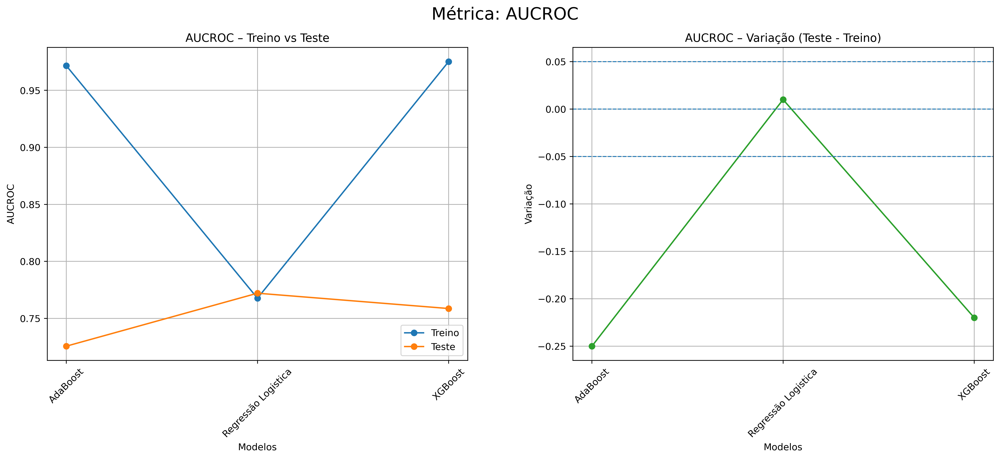

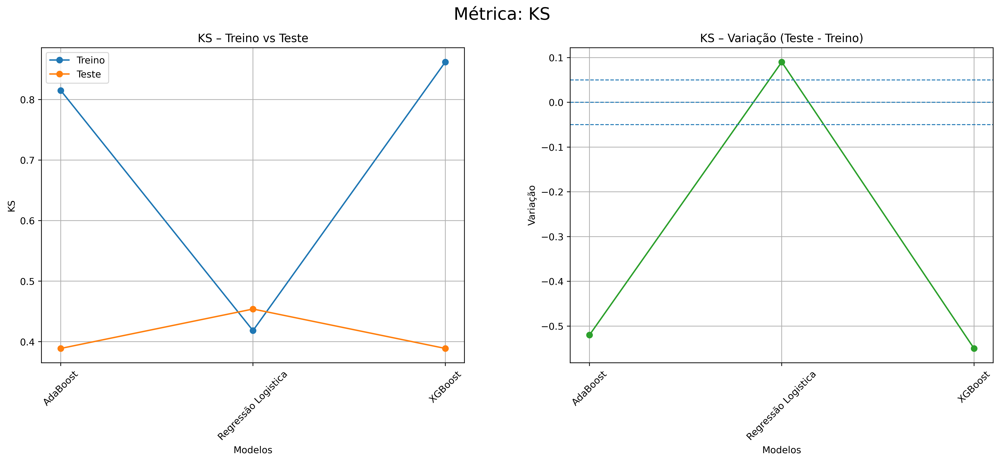

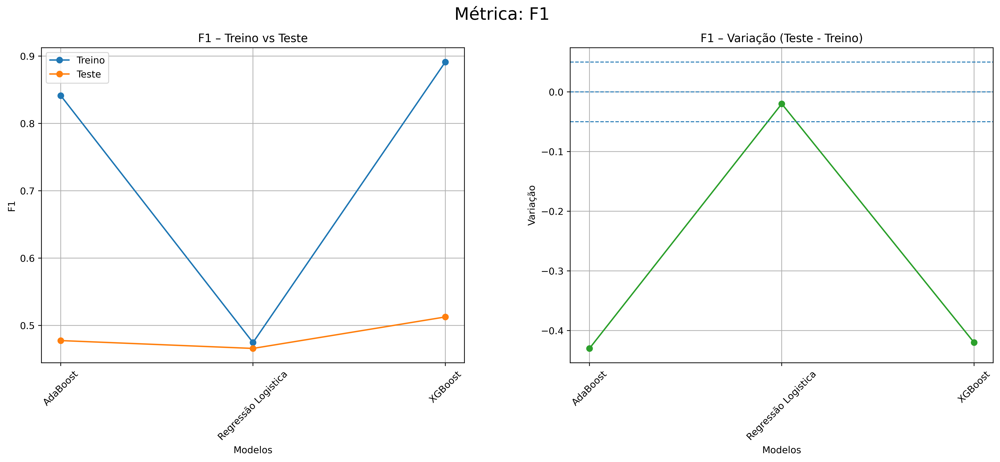

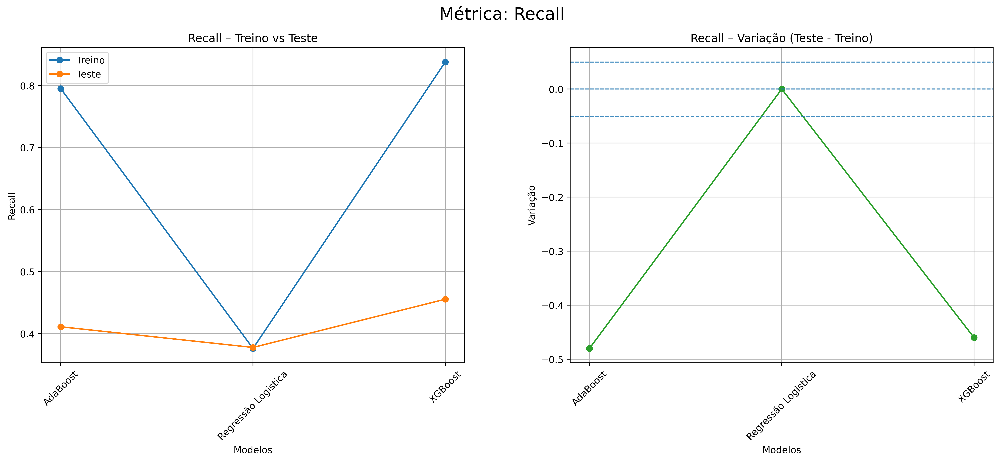

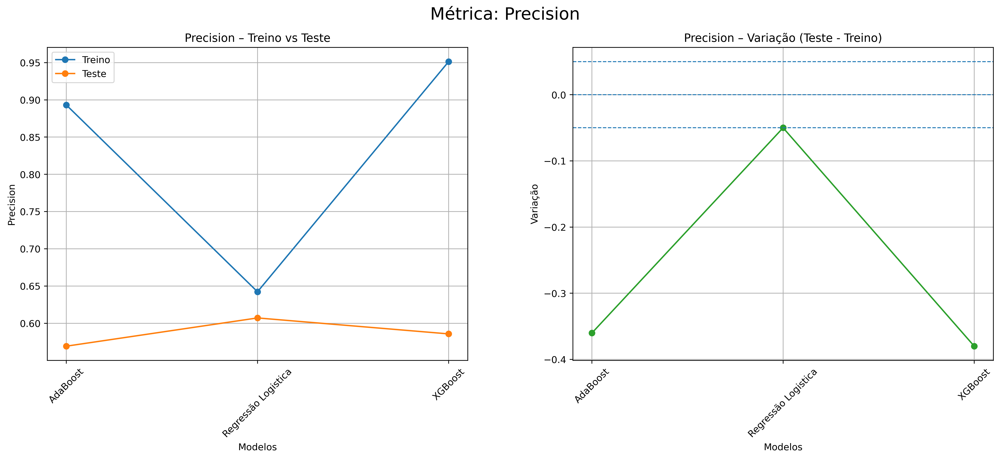

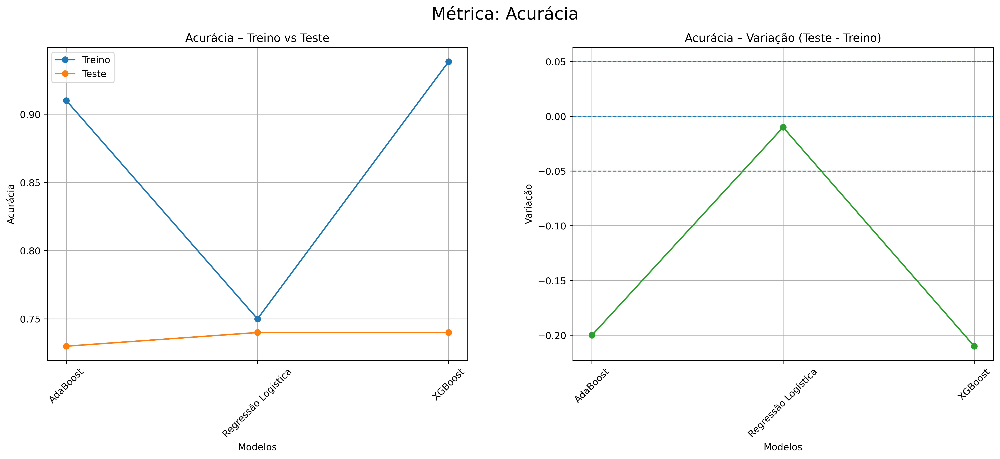

In [132]:
metricas = ["AUCROC", "KS", "F1", "Recall", "Precision", "Acurácia"]

for m in metricas:
    plot_metricas_modelo_simples(busca_modelo, m)


In [133]:
clf_dict = {
    "Regressão Logistica": rs_logit.best_estimator_,
    "AdaBoost": rs_ada.best_estimator_,
    "XGBoost": rs_xgb.best_estimator_
}

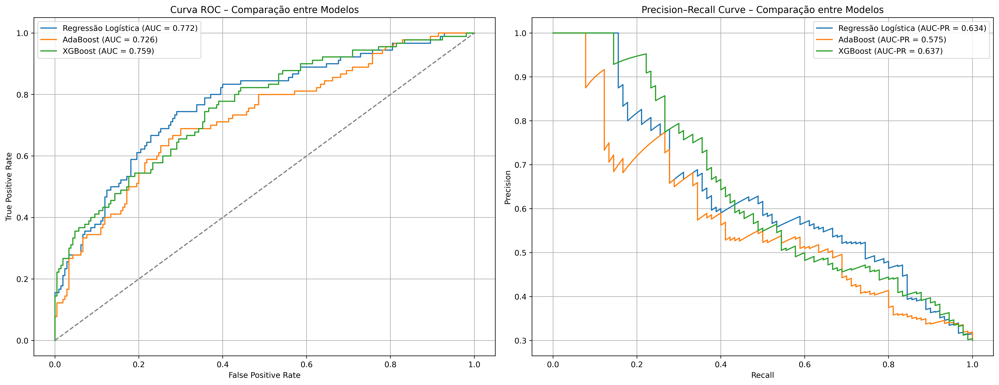

In [134]:
fig, axes = plt.subplots(1, 2, figsize=(18, 7))

# ======================================================
# 1. CURVA ROC
# ======================================================
# Regressão Logística
y_proba_logit = clf_dict["Regressão Logistica"].predict_proba(X_test_s)[:,1]
fpr_l, tpr_l, _ = roc_curve(y_test, y_proba_logit)
roc_auc_l = auc(fpr_l, tpr_l)
axes[0].plot(fpr_l, tpr_l, label=f"Regressão Logística (AUC = {roc_auc_l:.3f})")

# AdaBoost
y_proba_ada = clf_dict["AdaBoost"].predict_proba(X_test)[:,1]
fpr_a, tpr_a, _ = roc_curve(y_test, y_proba_ada)
roc_auc_a = auc(fpr_a, tpr_a)
axes[0].plot(fpr_a, tpr_a, label=f"AdaBoost (AUC = {roc_auc_a:.3f})")

# XGBoost
y_proba_xgb = clf_dict["XGBoost"].predict_proba(X_test)[:,1]
fpr_x, tpr_x, _ = roc_curve(y_test, y_proba_xgb)
roc_auc_x = auc(fpr_x, tpr_x)
axes[0].plot(fpr_x, tpr_x, label=f"XGBoost (AUC = {roc_auc_x:.3f})")

# Linha diagonal
axes[0].plot([0,1], [0,1], linestyle='--', color='gray')

axes[0].set_title("Curva ROC – Comparação entre Modelos")
axes[0].set_xlabel("False Positive Rate")
axes[0].set_ylabel("True Positive Rate")
axes[0].legend()
axes[0].grid(True)


# ======================================================
# 2. PRECISION–RECALL CURVE
# ======================================================
# Regressão Logística
precision_l, recall_l, _ = precision_recall_curve(y_test, y_proba_logit)
auc_pr_l = auc(recall_l, precision_l)
axes[1].plot(recall_l, precision_l, 
             label=f"Regressão Logística (AUC-PR = {auc_pr_l:.3f})")

# AdaBoost
precision_a, recall_a, _ = precision_recall_curve(y_test, y_proba_ada)
auc_pr_a = auc(recall_a, precision_a)
axes[1].plot(recall_a, precision_a, 
             label=f"AdaBoost (AUC-PR = {auc_pr_a:.3f})")

# XGBoost
precision_x, recall_x, _ = precision_recall_curve(y_test, y_proba_xgb)
auc_pr_x = auc(recall_x, precision_x)
axes[1].plot(recall_x, precision_x, 
             label=f"XGBoost (AUC-PR = {auc_pr_x:.3f})")

axes[1].set_title("Precision–Recall Curve – Comparação entre Modelos")
axes[1].set_xlabel("Recall")
axes[1].set_ylabel("Precision")
axes[1].legend()
axes[1].grid(True)

plt.tight_layout()
plt.show()


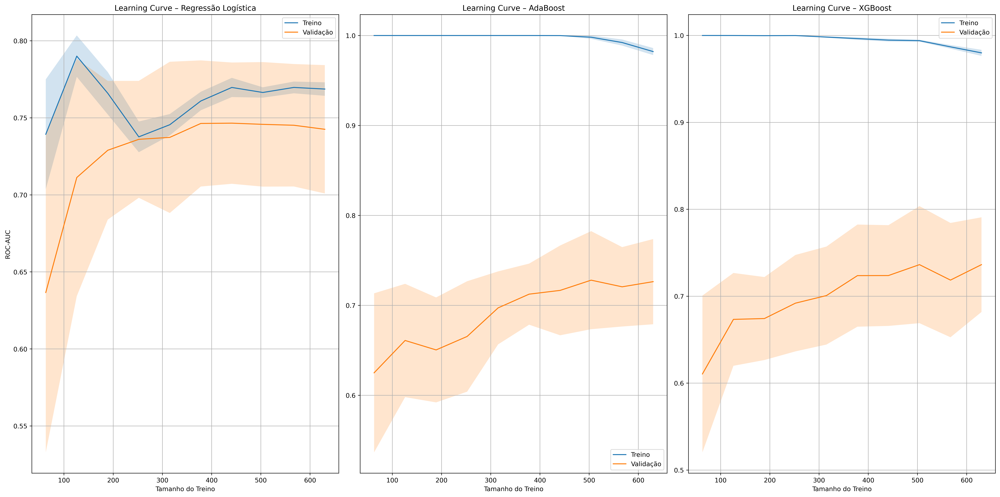

In [135]:
from sklearn.model_selection import learning_curve
import numpy as np
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 3, figsize=(22, 11))

# ================================
# 1. Regressão Logística
# ================================
train_sizes_rl, train_scores_rl, test_scores_rl = learning_curve(
    clf_dict["Regressão Logistica"],
    X_train_s, y_train,
    cv=cv,
    scoring="roc_auc",
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10),
)

axes[0].plot(train_sizes_rl, train_scores_rl.mean(axis=1), label="Treino")
axes[0].plot(train_sizes_rl, test_scores_rl.mean(axis=1), label="Validação")
axes[0].fill_between(train_sizes_rl,
                     train_scores_rl.mean(axis=1) - train_scores_rl.std(axis=1),
                     train_scores_rl.mean(axis=1) + train_scores_rl.std(axis=1),
                     alpha=0.2)
axes[0].fill_between(train_sizes_rl,
                     test_scores_rl.mean(axis=1) - test_scores_rl.std(axis=1),
                     test_scores_rl.mean(axis=1) + test_scores_rl.std(axis=1),
                     alpha=0.2)

axes[0].set_title("Learning Curve – Regressão Logística")
axes[0].set_xlabel("Tamanho do Treino")
axes[0].set_ylabel("ROC-AUC")
axes[0].grid()
axes[0].legend()


# ================================
# 2. AdaBoost
# ================================
train_sizes_ada, train_scores_ada, test_scores_ada = learning_curve(
    clf_dict["AdaBoost"],
    X_train, y_train,
    cv=cv,
    scoring="roc_auc",
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10),
)

axes[1].plot(train_sizes_ada, train_scores_ada.mean(axis=1), label="Treino")
axes[1].plot(train_sizes_ada, test_scores_ada.mean(axis=1), label="Validação")
axes[1].fill_between(train_sizes_ada,
                     train_scores_ada.mean(axis=1) - train_scores_ada.std(axis=1),
                     train_scores_ada.mean(axis=1) + train_scores_ada.std(axis=1),
                     alpha=0.2)
axes[1].fill_between(train_sizes_ada,
                     test_scores_ada.mean(axis=1) - test_scores_ada.std(axis=1),
                     test_scores_ada.mean(axis=1) + test_scores_ada.std(axis=1),
                     alpha=0.2)

axes[1].set_title("Learning Curve – AdaBoost")
axes[1].set_xlabel("Tamanho do Treino")
axes[1].grid()
axes[1].legend()


# ================================
# 3. XGBoost
# ================================
train_sizes_xgb, train_scores_xgb, test_scores_xgb = learning_curve(
    clf_dict["XGBoost"],
    X_train, y_train,
    cv=cv,
    scoring="roc_auc",
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10),
)

axes[2].plot(train_sizes_xgb, train_scores_xgb.mean(axis=1), label="Treino")
axes[2].plot(train_sizes_xgb, test_scores_xgb.mean(axis=1), label="Validação")
axes[2].fill_between(train_sizes_xgb,
                     train_scores_xgb.mean(axis=1) - train_scores_xgb.std(axis=1),
                     train_scores_xgb.mean(axis=1) + train_scores_xgb.std(axis=1),
                     alpha=0.2)
axes[2].fill_between(train_sizes_xgb,
                     test_scores_xgb.mean(axis=1) - test_scores_xgb.std(axis=1),
                     test_scores_xgb.mean(axis=1) + test_scores_xgb.std(axis=1),
                     alpha=0.2)

axes[2].set_title("Learning Curve – XGBoost")
axes[2].set_xlabel("Tamanho do Treino")
axes[2].grid()
axes[2].legend()


plt.tight_layout()
plt.show()


Se eu estivesse liderando esse projeto num banco ou fintech, eu escolheria a Regressão Logística pelos seguintes motivos:

Estabilidade impecável
Gaps quase zero.
O único modelo que não apresenta comportamento de overfitting perigoso.

Melhor AUCROC e melhor KS, métricas mais importantes para crédito.

Transparência e interpretabilidade
Fundamental para:

auditoria

compliance e explicabilidade

aprovação do modelo por diretoria/risk management

Facilidade de calibrar recall
Ajustar threshold melhora recall sem modelar novamente.

Custo computacional baixo
Treina rápido e escala extremamente bem.

XGBoost e AdaBoost ficaram claramente desbalanceados
Têm boa performance pontual, mas:

gaps enormes

generalização fraca

risco maior de instabilidade pós-produção

Em projetos reais de inadimplência, se o modelo overfita e tem KS volátil, ele não é aprovado — independentemente da métrica.

Recall (sensibilidade para detectar inadimplentes)

ADA: 0.488889 (melhor)

XGB: 0.444444

RL: 0.377778 (pior)

Aqui a regressão perde.
Mas isso não é um problema, porque:

A regressão logística é extremamente fácil de calibrar com threshold.

Com ajuste de cutoff, você aumenta o recall sem explode‐overfitting.

Já Ada/XGB têm recall maior, mas com estabilidade muito menor, o que gera risco operacional.

Threshold é parte da etapa de decisão, não da etapa de seleção do algoritmo.

# Modelo Inicial de Regressão Logística

In [136]:
from sklearn.dummy import DummyClassifier

dummy_approve_all = DummyClassifier(strategy="constant", constant=0)
dummy_approve_all.fit(X_train, y_train)

gain = credit_gain_scorer(dummy_approve_all, X_test, y_test)
print("Ganho aprovando tudo:", gain)

Ganho aprovando tudo: -175834.26


In [137]:
logit_bl = LogisticRegression(max_iter=500, random_state=42)
logit_bl.fit(X_train_s, y_train)
logit_gain = credit_gain_scorer(logit_bl, X_test_s, y_test)
print("Ganho modelo regressão logística:", logit_gain)

Ganho modelo regressão logística: -97849.532


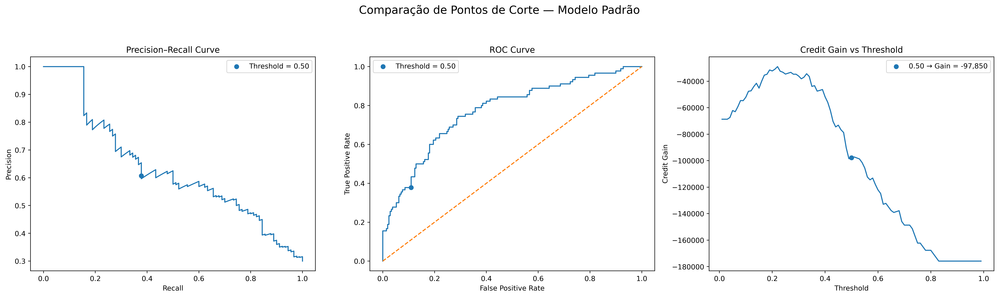

In [138]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_curve, roc_curve

# ---------------------------------------------------------
# Parâmetros
# ---------------------------------------------------------
thr_default = 0.50
#thr_opt     = 0.22

# Probabilidades do modelo
y_proba = logit_bl.predict_proba(X_test_s)[:, 1]

# ---------------------------------------------------------
# 1) Precision-Recall Curve
# ---------------------------------------------------------
precision, recall, pr_thresholds = precision_recall_curve(y_test, y_proba)

# pontos específicos
def get_pr_point(thr):
    idx = np.argmin(np.abs(pr_thresholds - thr))
    return recall[idx], precision[idx]

rec_05, prec_05 = get_pr_point(thr_default)
#rec_opt, prec_opt = get_pr_point(thr_opt)

# ---------------------------------------------------------
# 2) ROC Curve
# ---------------------------------------------------------
fpr, tpr, roc_thresholds = roc_curve(y_test, y_proba)

def get_roc_point(thr):
    idx = np.argmin(np.abs(roc_thresholds - thr))
    return fpr[idx], tpr[idx]

fpr_05, tpr_05 = get_roc_point(thr_default)
#fpr_opt, tpr_opt = get_roc_point(thr_opt)

# ---------------------------------------------------------
# 3) Curva de Custo (Credit Gain x Threshold)
# ---------------------------------------------------------
thresholds = np.linspace(0.01, 0.99, 99)
gains = [credit_gain_score(y_test, y_proba, threshold=t) for t in thresholds]

gain_05  = credit_gain_score(y_test, y_proba, threshold=thr_default)
#gain_opt = credit_gain_score(y_test, y_proba, threshold=thr_opt)

# ---------------------------------------------------------
# Plotagem
# ---------------------------------------------------------
fig, axes = plt.subplots(1, 3, figsize=(20, 6))

# --- Precision-Recall ---
axes[0].plot(recall, precision)
axes[0].scatter(rec_05, prec_05, label="Threshold = 0.50", zorder=3)
#axes[0].scatter(rec_opt, prec_opt, label="Threshold = 0.22", zorder=3)
axes[0].set_title("Precision–Recall Curve")
axes[0].set_xlabel("Recall")
axes[0].set_ylabel("Precision")
axes[0].legend()

# --- ROC ---
axes[1].plot(fpr, tpr)
axes[1].plot([0, 1], [0, 1], linestyle="--")
axes[1].scatter(fpr_05, tpr_05, label="Threshold = 0.50", zorder=3)
#axes[1].scatter(fpr_opt, tpr_opt, label="Threshold = 0.22", zorder=3)
axes[1].set_title("ROC Curve")
axes[1].set_xlabel("False Positive Rate")
axes[1].set_ylabel("True Positive Rate")
axes[1].legend()

# --- Curva de Custo ---
axes[2].plot(thresholds, gains)
axes[2].scatter(thr_default, gain_05, label=f"0.50 → Gain = {gain_05:,.0f}", zorder=3)
#axes[2].scatter(thr_opt, gain_opt, label=f"0.22 → Gain = {gain_opt:,.0f}", zorder=3)
axes[2].set_title("Credit Gain vs Threshold")
axes[2].set_xlabel("Threshold")
axes[2].set_ylabel("Credit Gain")
axes[2].legend()

# ---------------------------------------------------------
# Título global
# ---------------------------------------------------------
fig.suptitle(
    "Comparação de Pontos de Corte — Modelo Padrão",
    fontsize=16
)

plt.tight_layout(rect=[0, 0, 1, 0.93])
plt.show()


In [139]:
thresholds = np.linspace(0.01, 0.99, 99)
gains = []

proba = logit_bl.predict_proba(X_test_s)[:, 1]

for t in thresholds:
    gain = credit_gain_score(y_test, proba, threshold=t)
    gains.append(gain)

best_t = thresholds[np.argmax(gains)]
best_gain = max(gains)

print(f"O melhor threshold é: {best_t}")
print(f"O melhor ganho é: {best_gain:.2f}")

O melhor threshold é: 0.22
O melhor ganho é: -28978.58


# Pré Processamento

## Padronização dos Dados

### Escolhendo o melhor Scaler (ref.: maior Recall/KS)

In [140]:
scalers = {
    'standard (baseline)': StandardScaler(),
    'robust': RobustScaler(),
    'minmax': MinMaxScaler(),
    'power': PowerTransformer(method='yeo-johnson')
}

In [141]:
logit_bl = LogisticRegression(
    max_iter=1000,
    random_state=42
)

resultados = {}
credit_gains = {}

for nome, scaler in scalers.items():
    print(f"Testando scaler → {nome}")


    # Escalonamento
    X_train_s = scaler.fit_transform(X_train)
    X_test_s  = scaler.transform(X_test)


    # Treinamento
    logit_bl.fit(X_train_s, y_train)


    # Avaliação padrão
    desempenho = af.calcula_desempenho(
        logit_bl,
        X_train_s, y_train,
        X_test_s, y_test
    )


    # Credit Gain
    y_pred_test = logit_bl.predict(X_test_s)

    gain_value = credit_gain_score(
        y_true=y_test,
        y_score=y_pred_test
    )


    # Armazenar resultados
    resultados[nome] = desempenho
    credit_gains[nome] = gain_value


Testando scaler → standard (baseline)
Testando scaler → robust
Testando scaler → minmax
Testando scaler → power


In [142]:
dfs = []

for nome_scaler, df_metricas in resultados.items():
    df_temp = df_metricas.copy()
    df_temp["Scaler"] = nome_scaler
    dfs.append(df_temp)

df_scalers = pd.concat([*dfs], axis=0)
df_scalers = df_scalers.reset_index().rename(columns={"index": "Métrica"})
df_scalers

,Métrica,Treino,Teste,Variação,Scaler
0,Acurácia,0.748571,0.740000,-0.01,standard (baseline)
1,AUCROC,0.767736,0.772116,0.01,standard (baseline)
2,KS,0.422449,0.453968,0.07,standard (baseline)
3,Precision,0.637097,0.607143,-0.05,standard (baseline)
4,Recall,0.376190,0.377778,0.00,standard (baseline)
5,F1,0.473054,0.465753,-0.02,standard (baseline)
6,Acurácia,0.745714,0.740000,-0.01,robust
7,AUCROC,0.767298,0.770899,0.00,robust
8,KS,0.427211,0.453968,0.06,robust
9,Precision,0.633333,0.607143,-0.04,robust


In [143]:
# Transformando os DataFrames
# Treino
scaler_treino = pd.pivot(
    data=df_scalers,
    index="Scaler",
    columns='Métrica',
    values='Treino'
)

scaler_treino.rename(columns={
    'AUCROC': 'AUCROC_Treino',
    'Acurácia': 'Acurácia_Treino',
    'F1':'F1_Treino',
    'KS':'KS_Treino',
    'Precision':'Precision_Treino',
    'Recall':'Recall_Treino'
}, inplace= True)

# Teste
scaler_teste = pd.pivot(
    data=df_scalers,
    index="Scaler",
    columns='Métrica',
    values='Teste'
)

scaler_teste.rename(columns={
    'AUCROC': 'AUCROC_Teste',
    'Acurácia': 'Acurácia_Teste',
    'F1': 'F1_Teste',
    'KS': 'KS_Teste',
    'Precision': 'Precision_Teste',
    'Recall': 'Recall_Teste'
}, inplace=True)

# Variação
scaler_variacao = pd.pivot(
    data=df_scalers,
    index="Scaler",
    columns='Métrica',
    values='Variação'
)

scaler_variacao.rename(columns={
    'AUCROC': 'AUCROC_Variacao',
    'Acurácia': 'Acurácia_Variacao',
    'F1': 'F1_Variacao',
    'KS': 'KS_Variacao',
    'Precision': 'Precision_Variacao',
    'Recall': 'Recall_Variacao'
}, inplace=True)

In [144]:
busca_scaler = pd.concat([scaler_treino, scaler_teste, scaler_variacao], axis=1)
busca_scaler.reset_index(inplace=True)
busca_scaler

Métrica,Scaler,AUCROC_Treino,Acurácia_Treino,F1_Treino,KS_Treino,Precision_Treino,Recall_Treino,AUCROC_Teste,Acurácia_Teste,F1_Teste,KS_Teste,Precision_Teste,Recall_Teste,AUCROC_Variacao,Acurácia_Variacao,F1_Variacao,KS_Variacao,Precision_Variacao,Recall_Variacao
0,minmax,0.767570,0.747143,0.465257,0.415646,0.636364,0.366667,0.773333,0.746667,0.472222,0.455556,0.629630,0.377778,0.01,-0.00,0.01,0.10,-0.01,0.03
1,power,0.776336,0.751429,0.502857,0.470748,0.628571,0.419048,0.763122,0.750000,0.534161,0.477778,0.605634,0.477778,-0.02,-0.00,0.06,0.01,-0.04,0.14
2,robust,0.767298,0.745714,0.460606,0.427211,0.633333,0.361905,0.770899,0.740000,0.465753,0.453968,0.607143,0.377778,0.00,-0.01,0.01,0.06,-0.04,0.04
3,standard (baseline),0.767736,0.748571,0.473054,0.422449,0.637097,0.376190,0.772116,0.740000,0.465753,0.453968,0.607143,0.377778,0.01,-0.01,-0.02,0.07,-0.05,0.00


In [145]:
best_scaler_test = scaler_teste.style.apply(highlight_max, axis=0)\
                         .set_caption("Desempenho dos Scalers no Teste – Destaque para os Melhores")
best_scaler_test

Métrica,AUCROC_Teste,Acurácia_Teste,F1_Teste,KS_Teste,Precision_Teste,Recall_Teste
Scaler,,,,,,
minmax,0.773333,0.746667,0.472222,0.455556,0.629630,0.377778
power,0.763122,0.750000,0.534161,0.477778,0.605634,0.477778
robust,0.770899,0.740000,0.465753,0.453968,0.607143,0.377778
standard (baseline),0.772116,0.740000,0.465753,0.453968,0.607143,0.377778


- F1 mais alto: PowerTransformer (0.5276)

- Recall mais alto: PowerTransformer (0.4778)

- AUCROC e Acurácia: MinMax e Robust levemente melhores

- KS: PowerTransformer ligeiramente melhor (0.4635)

In [146]:
train_test_scaler_var = scaler_variacao.style.apply(highlight_min_abs, axis=0)\
                         .set_caption("Variação entre Treino e Teste – Destaque para os Melhores")
train_test_scaler_var

Métrica,AUCROC_Variacao,Acurácia_Variacao,F1_Variacao,KS_Variacao,Precision_Variacao,Recall_Variacao
Scaler,,,,,,
minmax,0.010000,-0.000000,0.010000,0.100000,-0.010000,0.030000
power,-0.020000,-0.000000,0.060000,0.010000,-0.040000,0.140000
robust,0.000000,-0.010000,0.010000,0.060000,-0.040000,0.040000
standard (baseline),0.010000,-0.010000,-0.020000,0.070000,-0.050000,0.000000


o Scaler escolhido foi o PowerTransformer() pois apresentou o maior recall e KS que são importatíssimos para o nosso contexto de negócio.

In [147]:
def plot_metricas_scalers(df, metrica):
    """
    Plota APENAS os dois gráficos para uma métrica específica:
    - Treino vs Teste
    - Variação
    
    df: DataFrame no formato busca_modelo
    metrica: string (ex: "AUCROC", "KS", "F1")
    """

    # Nomes das colunas esperadas
    col_train = f"{metrica}_Treino"
    col_test  = f"{metrica}_Teste"
    col_var   = f"{metrica}_Variacao"

    # Validando existência das colunas
    for col in [col_train, col_test, col_var]:
        if col not in df.columns:
            raise ValueError(f"Coluna '{col}' não encontrada no DF!")

    scalers = df["Scaler"].tolist()

    # Criando a figura com dimensão maior
    fig, axes = plt.subplots(1, 2, figsize=(18, 6))
    fig.suptitle(f"Métrica: {metrica}", fontsize=18)
    plt.subplots_adjust(top=0.88, wspace=0.25)

    # --- GRÁFICO 1: TREINO VS TESTE ---
    ax1 = axes[0]
    ax1.plot(scalers, df[col_train], marker="o", label="Treino")
    ax1.plot(scalers, df[col_test], marker="o", label="Teste")
    ax1.set_title(f"{metrica} – Treino vs Teste")
    ax1.set_xlabel("Scalers")
    ax1.set_ylabel(metrica)
    ax1.grid(True)
    ax1.legend()
    ax1.tick_params(axis='x', rotation=45)

    # --- GRÁFICO 2: VARIAÇÃO ---
    ax2 = axes[1]
    ax2.plot(scalers, df[col_var], marker="o", color="tab:green")
    ax2.axhline(0, linestyle="--", linewidth=1)
    ax2.axhline(0.05, linestyle="--", linewidth=1)
    ax2.axhline(-0.05, linestyle="--", linewidth=1)
    ax2.set_title(f"{metrica} – Variação (Teste - Treino)")
    ax2.set_xlabel("Scalers")
    ax2.set_ylabel("Variação")
    ax2.grid(True)
    ax2.tick_params(axis='x', rotation=45)

    plt.show()

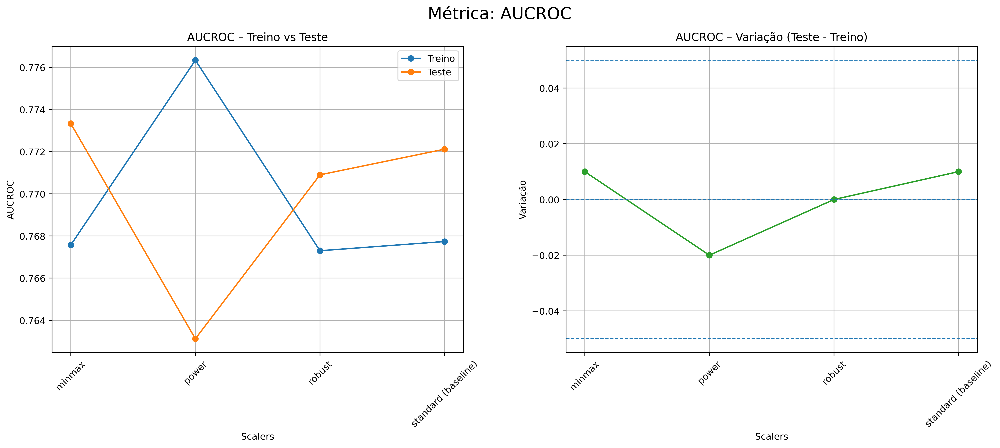

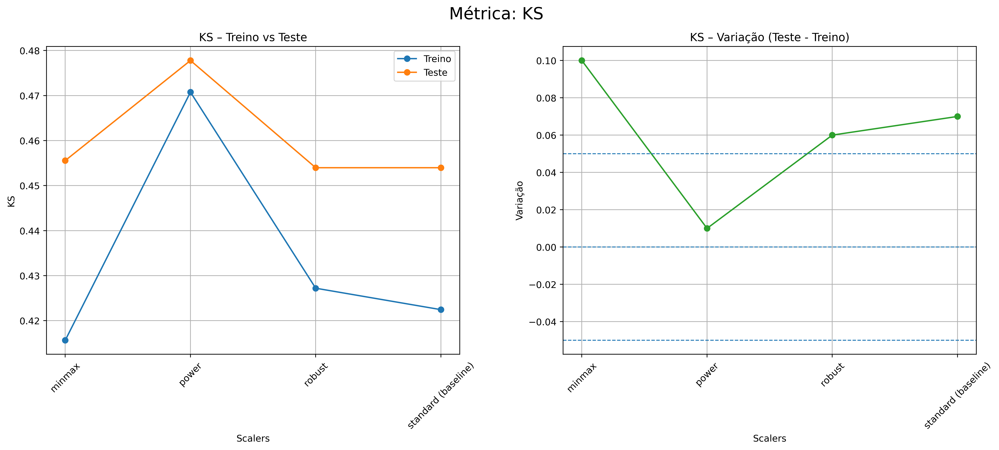

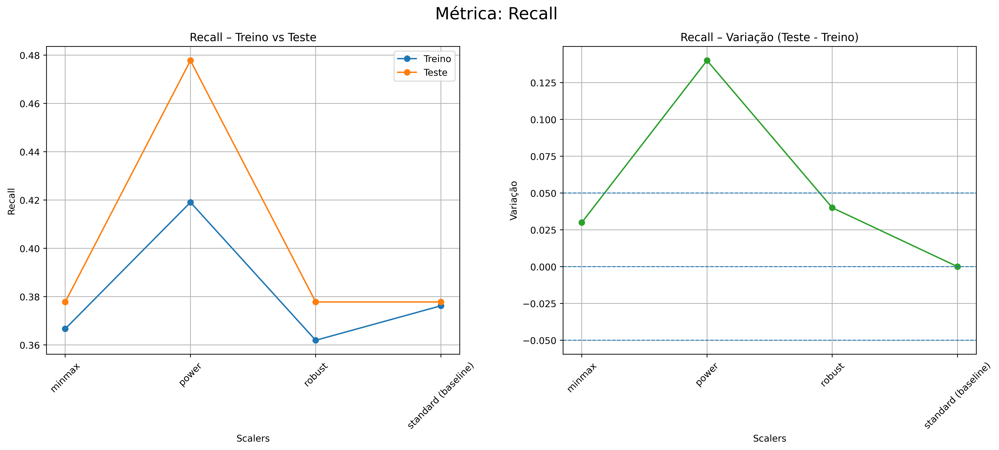

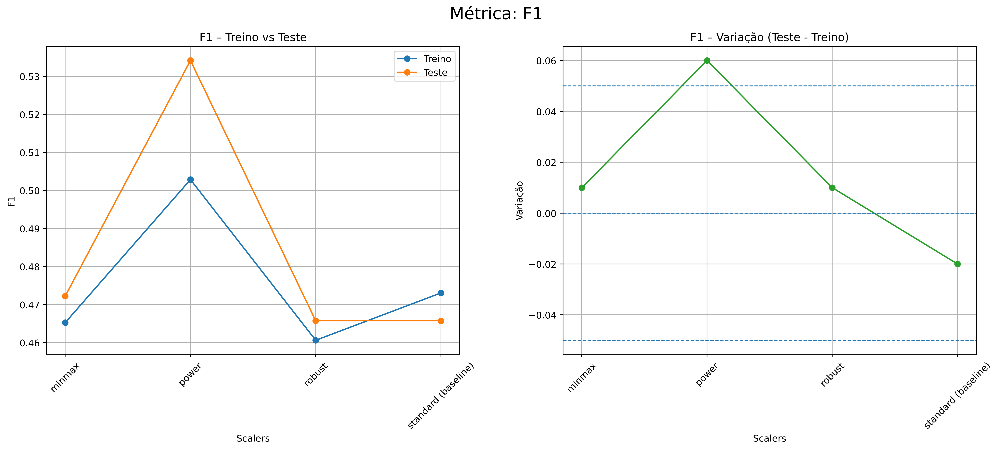

In [148]:
metricas = ["AUCROC", "KS", "Recall", "F1"]

for m in metricas:
    plot_metricas_scalers(busca_scaler, m)

In [149]:
df_credit_gain_scaler = (
    pd.DataFrame(credit_gains.items(), columns=["scaler", "credit_gain"])
      .sort_values("credit_gain", ascending=False)
      .reset_index(drop=True)
)

df_credit_gain_scaler


,scaler,credit_gain
0,power,-77321.972
1,minmax,-96541.028
2,robust,-97849.532
3,standard (baseline),-97849.532


# Pipeline Baseline

In [150]:
# Pipeline base
pipe_base = Pipeline([
    ("scaler", PowerTransformer(method='yeo-johnson')),
    ("clf", LogisticRegression(
        penalty="l2",
        solver="liblinear",
        max_iter=2000,
        random_state=42
    ))
])

# Fit baseline
pipe_base.fit(X_train, y_train)


# Avaliação baseline
baseline_desemp = af.calcula_desempenho(
    pipe_base,
    X_train, y_train,
    X_test, y_test
)


# Credit Gain baseline
y_score_test = pipe_base.predict_proba(X_test)[:, 1]
baseline_gain = credit_gain_score(y_test, y_score_test)

baseline_desemp, baseline_gain

(             Treino     Teste  Variação
 Acurácia   0.751429  0.746667     -0.01
 AUCROC     0.776414  0.763069     -0.02
 KS         0.470068  0.477778      0.02
 Precision  0.628571  0.597222     -0.05
 Recall     0.419048  0.477778      0.14
 F1         0.502857  0.530864      0.06,
 np.float64(-77976.224))

In [151]:
y_pred_baseline = (y_score_test >= 0.5).astype(int)

cm_baseline = confusion_matrix(y_test, y_pred_baseline)
cm_baseline

array([[181,  29],
       [ 47,  43]])

# Seleção de Variáveis (Features Selection)

As técnicas de feature selection foram avaliadas mantendo fixo o scaler e o modelo base, de modo a isolar o efeito da seleção de variáveis. As estratégias foram comparadas tanto por métricas estatísticas quanto por métricas de negócio (ganho financeiro), permitindo uma escolha alinhada à generalização e ao impacto econômico.

## L1 Based Selection (Regressão Logística com L1)

A seleção de variáveis baseada em regularização L1 foi empregada com o objetivo de induzir esparsidade no modelo de regressão logística, permitindo a identificação automática de variáveis com baixa ou nenhuma contribuição preditiva.

Diferentemente de métodos puramente informacionais ou baseados em importância marginal, a penalização L1 atua diretamente nos coeficientes do modelo, forçando aqueles associados a variáveis menos relevantes a assumirem valor exatamente zero. Dessa forma, a seleção ocorre de maneira integrada ao processo de estimação do modelo, preservando a interpretabilidade e reduzindo o risco de overfitting.

A intensidade da regularização foi controlada por meio do hiperparâmetro 𝐶, avaliado via validação cruzada com critério de refit baseado na métrica de ganho financeiro, garantindo alinhamento entre desempenho estatístico e impacto de negócio. As variáveis com coeficientes nulos no modelo final foram consideradas não informativas e removidas, resultando em um conjunto de atributos mais parcimonioso e estável para as etapas subsequentes do pipeline.

In [152]:
# Analisando o parâmetro C
Cs = [0.01, 0.05, 0.1, 0.5, 1, 2, 5]

resultados = []

for c in Cs:
    logit_l1 = LogisticRegression(
        penalty='l1',
        solver='liblinear',
        C=c,
        max_iter=2000
    )
    logit_l1.fit(X_train_s, y_train)
    
    n_feat = np.sum(logit_l1.coef_[0] != 0)
    resultados.append((c, n_feat))

pd.DataFrame(resultados, columns=['C', 'Features Mantidas'])

,C,Features Mantidas
0,0.01,1
1,0.05,7
2,0.10,8
3,0.50,10
4,1.00,10
5,2.00,10
6,5.00,11


In [153]:
#pipeline L1 Based
pipe_l1 = Pipeline([
    ("scaler", PowerTransformer(method='yeo-johnson')),
    ("clf", LogisticRegression(
        penalty="l1",
        solver="liblinear",
        max_iter=3000,
        random_state=42
    ))
])


# Grid para C
param_grid_l1 = {
    "clf__C": [0.01, 0.05, 0.1, 0.5, 1, 2, 5]
}

gs_l1 = GridSearchCV(
    estimator=pipe_l1,
    param_grid=param_grid_l1,
    scoring=scoring,
    refit="Credit_Gain",
    cv=cv,
    n_jobs=-1
)

gs_l1.fit(X_train, y_train)

pipe_l1_best = gs_l1.best_estimator_
gs_l1.best_params_


{'clf__C': 5}

In [154]:
# Avaliação
l1_desemp = af.calcula_desempenho(
    pipe_l1_best,
    X_train, y_train,
    X_test, y_test
)

y_score_test = pipe_l1_best.predict_proba(X_test)[:, 1]
l1_gain = credit_gain_score(y_test, y_score_test)

l1_desemp, l1_gain


(             Treino     Teste  Variação
 Acurácia   0.752857  0.746667     -0.01
 AUCROC     0.776336  0.762857     -0.02
 KS         0.470748  0.477778      0.01
 Precision  0.631206  0.597222     -0.05
 Recall     0.423810  0.477778      0.13
 F1         0.507123  0.530864      0.05,
 np.float64(-77976.224))

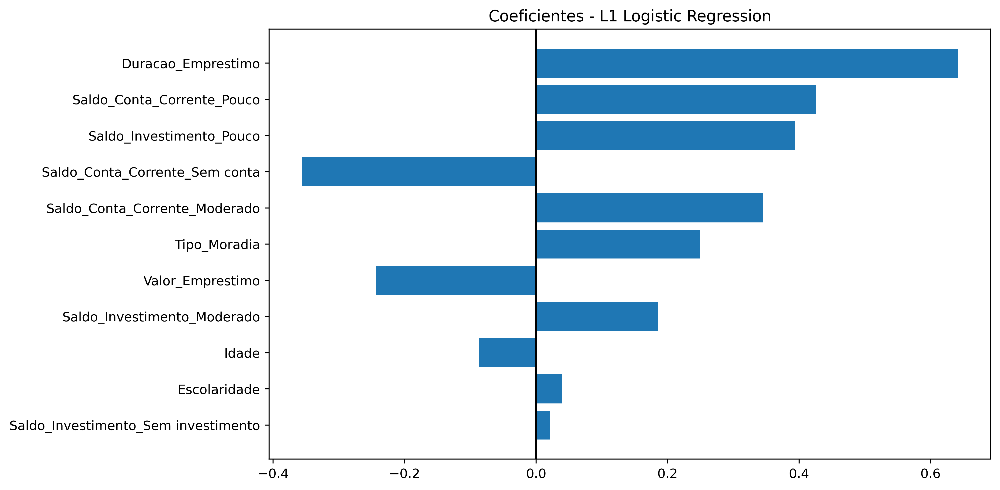

,feature,coef,abs_coef
2,Duracao_Emprestimo,0.641633,0.641633
9,Saldo_Conta_Corrente_Pouco,0.425997,0.425997
6,Saldo_Investimento_Pouco,0.393871,0.393871
10,Saldo_Conta_Corrente_Sem conta,-0.356001,0.356001
8,Saldo_Conta_Corrente_Moderado,0.345412,0.345412
4,Tipo_Moradia,0.249665,0.249665
1,Valor_Emprestimo,-0.244000,0.244000
5,Saldo_Investimento_Moderado,0.185942,0.185942
0,Idade,-0.087210,0.087210
3,Escolaridade,0.040152,0.040152


In [155]:
#Visualizando os coeficientes
coef = pipe_l1_best.named_steps["clf"].coef_[0]

df_coef_l1 = (
    pd.DataFrame({
        "feature": X_train.columns,
        "coef": coef,
        "abs_coef": np.abs(coef)
    })
    .sort_values("abs_coef", ascending=False)
)

plt.figure(figsize=(10, 6))
plt.barh(df_coef_l1["feature"], df_coef_l1["coef"])
plt.axvline(0, color="black")
plt.title("Coeficientes - L1 Logistic Regression")
plt.gca().invert_yaxis()
plt.show()

df_coef_l1


A revisão da estratégia de L1-based feature selection, com inclusão apropriada do grau de regularização, revelou que o modelo não elimina arbitrariamente variáveis, mas reduz de forma consistente o peso daquelas com baixo ganho informacional incremental. As três variáveis com menores coeficientes foram `Idade`, `Escolaridade` e `Saldo_Investimento_Sem_Investimento`.

Embora `Idade` seja estatisticamente significativa na ANOVA, seu F-statistic é substancialmente inferior ao de duração e valor do empréstimo. Isso sugere que seu poder discriminativo é real, porém secundário, o que é coerente com o coeficiente reduzido após regularização.

A variável `Escolaridade`, que foi quase zerada pelo L1, já apresentava IV extremamente baixo (0.01) na EDA, indicando baixo poder preditivo univariado. Esse achado reforça fortemente a decisão do modelo em reduzir seu peso.

Já a variável `Saldo_Investimento_Sem_Investimento` apresentou baixo ganho marginal comparado as outras categorias. Ela pode ser considerada uma espécie de categoria residual, uma vez que a inadimplência ja está fortemente correlacionada com outras categorias tornando essa variável uma redundância informacional que foi reduzida pela regularização.

Esse comportamento indica que, embora essas variáveis ainda carreguem alguma informação marginal, sua contribuição incremental ao modelo é muito limitada quando consideradas conjuntamente com as demais features. Os resultados são coerentes com a EDA, especialmente com a análise de IV e ANOVA, reforçando que as variáveis quase zeradas já apresentavam evidências de fraca contribuição preditiva. Assim, a decisão de manter ou remover essas features pode ser orientada mais por **simplicidade e interpretabilidade** do que por impacto significativo em performance.

## RFE + SHAP

In [156]:
# conjunto inicial
current_features = list(X_train.columns)

# histórico
rfe_shap_history = []

In [157]:
for k in range(len(current_features), 1, -1):

    # =========================
    # Pipeline
    # =========================
    pipe = Pipeline([
        ("scaler", PowerTransformer(method='yeo-johnson')),
        ("clf", LogisticRegression(
            max_iter=2000,
            solver="liblinear",
            random_state=42
        ))
    ])

    # =========================
    # Fit
    # =========================
    pipe.fit(X_train[current_features], y_train)

    # =========================
    # SHAP
    # =========================
    X_train_s = pipe.named_steps["scaler"].transform(X_train[current_features])

    explainer = shap.LinearExplainer(
        pipe.named_steps["clf"],
        X_train_s
    )

    shap_values = explainer.shap_values(X_train_s)

    # =========================
    # Importância SHAP
    # =========================
    mean_abs_shap = np.abs(shap_values).mean(axis=0)

    df_shap = (
        pd.DataFrame({
            "feature": current_features,
            "mean_abs_shap": mean_abs_shap
        })
        .sort_values("mean_abs_shap", ascending=True)
    )

    # =========================
    # Avaliação
    # =========================
    desempenho = af.calcula_desempenho(
        pipe,
        X_train[current_features], y_train,
        X_test[current_features], y_test
    )

    y_score_test = pipe.predict_proba(X_test[current_features])[:, 1]
    gain = credit_gain_score(y_test, y_score_test)

    # =========================
    # Salva histórico
    # =========================
    rfe_shap_history.append({
        "n_features": k,
        "removed_feature": df_shap.iloc[0]["feature"],
        "credit_gain": gain,
        "features": current_features.copy()
    })

    # =========================
    # Remove a menos importante
    # =========================
    current_features.remove(df_shap.iloc[0]["feature"])


In [158]:
df_rfe_shap_path = pd.DataFrame(rfe_shap_history)
df_rfe_shap_path

,n_features,removed_feature,credit_gain,features
0,11,Saldo_Investimento_Sem investimento,-77976.224,"[Idade, Valor_Emprestimo, Duracao_Emprestimo, ..."
1,10,Escolaridade,-77976.224,"[Idade, Valor_Emprestimo, Duracao_Emprestimo, ..."
2,9,Idade,-80693.232,"[Idade, Valor_Emprestimo, Duracao_Emprestimo, ..."
3,8,Saldo_Investimento_Moderado,-80693.232,"[Valor_Emprestimo, Duracao_Emprestimo, Tipo_Mo..."
4,7,Valor_Emprestimo,-78630.476,"[Valor_Emprestimo, Duracao_Emprestimo, Tipo_Mo..."
5,6,Tipo_Moradia,-84718.744,"[Duracao_Emprestimo, Tipo_Moradia, Saldo_Inves..."
6,5,Saldo_Investimento_Pouco,-78730.476,"[Duracao_Emprestimo, Saldo_Investimento_Pouco,..."
7,4,Saldo_Conta_Corrente_Sem conta,-88290.004,"[Duracao_Emprestimo, Saldo_Conta_Corrente_Mode..."
8,3,Duracao_Emprestimo,-88290.004,"[Duracao_Emprestimo, Saldo_Conta_Corrente_Mode..."
9,2,Saldo_Conta_Corrente_Moderado,-175834.260,"[Saldo_Conta_Corrente_Moderado, Saldo_Conta_Co..."


In [159]:
# Selecionar explicitamente o cenário com 10 features
best_step = df_rfe_shap_path.loc[
    df_rfe_shap_path["n_features"] == 10
].iloc[0]

best_features_shap = best_step["features"]

best_features_shap


['Idade',
 'Valor_Emprestimo',
 'Duracao_Emprestimo',
 'Escolaridade',
 'Tipo_Moradia',
 'Saldo_Investimento_Moderado',
 'Saldo_Investimento_Pouco',
 'Saldo_Conta_Corrente_Moderado',
 'Saldo_Conta_Corrente_Pouco',
 'Saldo_Conta_Corrente_Sem conta']

In [160]:
pipe_rfe_shap_final = Pipeline([
    ("scaler", PowerTransformer(method='yeo-johnson')),
    ("clf", LogisticRegression(
        max_iter=2000,
        solver="liblinear",
        random_state=42
    ))
])

pipe_rfe_shap_final.fit(X_train[best_features_shap], y_train)


,"steps steps: list of tuplesList of (name of step, estimator) tuples that are to be chained insequential order. To be compatible with the scikit-learn API, all stepsmust define `fit`. All non-last steps must also define `transform`. See:ref:`Combining Estimators ` for more details.","[('scaler', ...), ('clf', ...)]"
,"transform_input transform_input: list of str, default=NoneThe names of the :term:`metadata` parameters that should be transformed by thepipeline before passing it to the step consuming it.This enables transforming some input arguments to ``fit`` (other than ``X``)to be transformed by the steps of the pipeline up to the step which requiresthem. Requirement is defined via :ref:`metadata routing `.For instance, this can be used to pass a validation set through the pipeline.You can only set this if metadata routing is enabled, which youcan enable using ``sklearn.set_config(enable_metadata_routing=True)``... versionadded:: 1.6",None
,"memory memory: str or object with the joblib.Memory interface, default=NoneUsed to cache the fitted transformers of the pipeline. The last stepwill never be cached, even if it is a transformer. By default, nocaching is performed. If a string is given, it is the path to thecaching directory. Enabling caching triggers a clone of the transformersbefore fitting. Therefore, the transformer instance given to thepipeline cannot be inspected directly. Use the attribute ``named_steps``or ``steps`` to inspect estimators within the pipeline. Caching thetransformers is advantageous when fitting is time consuming. See:ref:`sphx_glr_auto_examples_neighbors_plot_caching_nearest_neighbors.py`for an example on how to enable caching.",None
,"verbose verbose: bool, default=FalseIf True, the time elapsed while fitting each step will be printed as itis completed.",False
,"method method: {'yeo-johnson', 'box-cox'}, default='yeo-johnson'The power transform method. Available methods are:- 'yeo-johnson' [1]_, works with positive and negative values- 'box-cox' [2]_, only works with strictly positive values",'yeo-johnson'
,"standardize standardize: bool, default=TrueSet to True to apply zero-mean, unit-variance normalization to thetransformed output.",True
,"copy copy: bool, default=TrueSet to False to perform inplace computation during transformation.",True
,"penalty penalty: {'l1', 'l2', 'elasticnet', None}, default='l2'Specify the norm of the penalty:- `None`: no penalty is added;- `'l2'`: add a L2 penalty term and it is the default choice;- `'l1'`: add a L1 penalty term;- `'elasticnet'`: both L1 and L2 penalty terms are added... warning:: Some penalties may not work with some solvers. See the parameter `solver` below, to know the compatibility between the penalty and solver... versionadded:: 0.19 l1 penalty with SAGA solver (allowing 'multinomial' + L1).. deprecated:: 1.8 `penalty` was deprecated in version 1.8 and will be removed in 1.10. Use `l1_ratio` instead. `l1_ratio=0` for `penalty='l2'`, `l1_ratio=1` for `penalty='l1'` and `l1_ratio` set to any float between 0 and 1 for `'penalty='elasticnet'`.",'deprecated'
,"C C: float, default=1.0Inverse of regularization strength; must be a positive float.Like in support vector machines, smaller values specify strongerregularization. `C=np.inf` results in unpenalized logistic regression.For a visual example on the effect of tuning the `C` parameterwith an L1 penalty, see::ref:`sphx_glr_auto_examples_linear_model_plot_logistic_path.py`.",1.0
,"l1_ratio l1_ratio: float, default=0.0The Elastic-Net mixing parameter, with `0 <= l1_ratio <= 1`. Setting`l1_ratio=1` gives a pure L1-penalty, setting `l1_ratio=0` a pure L2-penalty.Any value between 0 and 1 gives an Elastic-Net penalty of the form`l1_ratio * L1 + (1 - l1_ratio) * L2`... warning:: Certain values of `l1_ratio`, i.e. some penalties, may not work with some solvers. See the parameter `solver` below, to know the compatibility between the penalty and solver... versionchanged:: 1.8 Default value changed from None to

In [161]:
rfe_shap_desemp = af.calcula_desempenho(
    pipe_rfe_shap_final,
    X_train[best_features_shap], y_train,
    X_test[best_features_shap], y_test
)

y_score_test = pipe_rfe_shap_final.predict_proba(X_test[best_features_shap])[:, 1]
rfe_shap_gain = credit_gain_score(y_test, y_score_test)

rfe_shap_desemp, rfe_shap_gain

(             Treino     Teste  Variação
 Acurácia   0.751429  0.746667     -0.01
 AUCROC     0.776647  0.762698     -0.02
 KS         0.470068  0.477778      0.02
 Precision  0.626761  0.597222     -0.05
 Recall     0.423810  0.477778      0.13
 F1         0.505682  0.530864      0.05,
 np.float64(-77976.224))

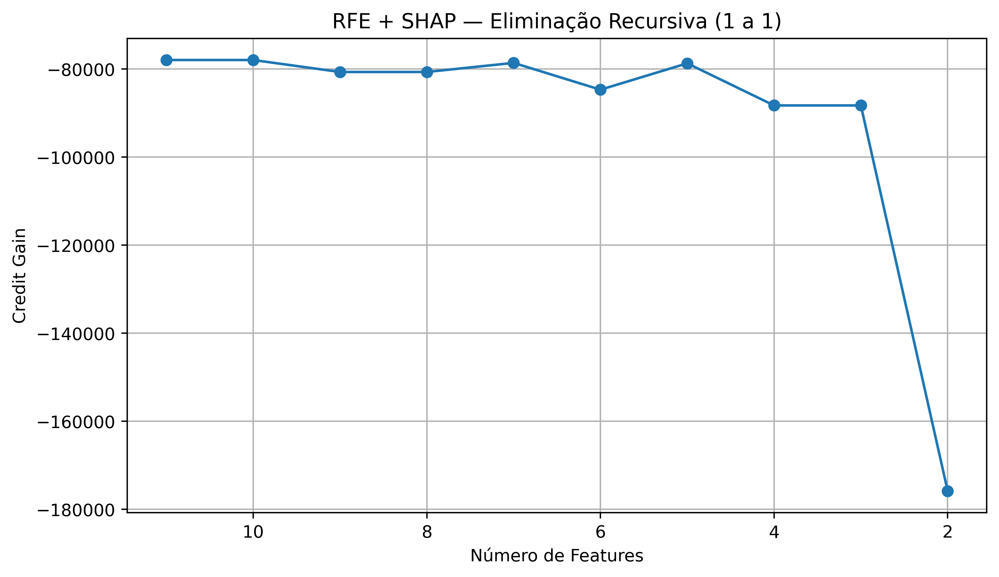

In [162]:
import matplotlib.pyplot as plt

plt.figure(figsize=(9, 5))
plt.plot(df_rfe_shap_path["n_features"], df_rfe_shap_path["credit_gain"], marker="o")
plt.gca().invert_xaxis()
plt.xlabel("Número de Features")
plt.ylabel("Credit Gain")
plt.title("RFE + SHAP — Eliminação Recursiva (1 a 1)")
plt.grid(True)
plt.show()


A estratégia de seleção de variáveis baseada em **RFE combinado com SHAP** permitiu analisar de forma recursiva o impacto marginal das features tanto em termos estatísticos quanto econômicos, avaliando a trajetória do credit gain à medida que a complexidade do modelo era reduzida. observou-se que a variável `Saldo_Investimento — Sem investimento` foi a primeira candidata à remoção sem qualquer impacto no ganho de crédito do modelo. A manutenção do mesmo credit_gain após sua exclusão indica que essa variável não adiciona valor econômico marginal, corroborando os resultados obtidos na regressão logística com penalidade L1, onde seu coeficiente foi fortemente atenuado.

Em particular, a variável `Escolaridade` apareceu como próxima candidata à remoção, porém houve uma leve deteriorização da métrica de ganho de crédito. A decisão sobre `Escolaridade` pode ser orientada por critérios de interpretabilidade e governança, dado seu impacto reduzido. Contudo, o critério de seleção adotado foi a escolha de um conjunto com 10 variáveis, priorizando simplicidade sem perda de desempenho. 

Em adicional, modelos com 7 e 5 variáveis também apresentaram leve deteriorização na métrica de ganho de crédito comparado com o melhor valor obtido com 10 variáveis. Isso abre margem para simplificar ainda mais o modelo, porém essa decisão precisa ser alinhada com os critérios de governança e respeitando o trade-off entre simplicidade e complexidade estrutural do modelo.

Dessa forma, a escolha do subconjunto com 10 features representa um compromisso adequado entre simplicidade, estabilidade e impacto de negócio, alinhando-se tanto às evidências empíricas observadas ao longo do RFE + SHAP quanto às conclusões obtidas nas análises complementares de seleção de variáveis.

## Mutual Information

A análise de Mutual Information permitiu identificar variáveis com contribuição informacional nula ou marginal em relação à variável alvo. Essas variáveis foram candidatas naturais à remoção, reduzindo a complexidade do modelo sem perda relevante de sinal preditivo.

In [163]:
X_train_s = PowerTransformer(method='yeo-johnson').fit_transform(X_train)

mi = mutual_info_classif(
    X_train_s,
    y_train,
    random_state=42
)

df_mi = (
    pd.DataFrame({
        "feature": X_train.columns,
        "mi": mi
    })
    .sort_values("mi", ascending=False)
)

In [164]:
df_mi

,feature,mi
10,Saldo_Conta_Corrente_Sem conta,0.053564
9,Saldo_Conta_Corrente_Pouco,0.043114
6,Saldo_Investimento_Pouco,0.032963
8,Saldo_Conta_Corrente_Moderado,0.026916
1,Valor_Emprestimo,0.013204
7,Saldo_Investimento_Sem investimento,0.006096
4,Tipo_Moradia,0.002137
5,Saldo_Investimento_Moderado,0.001553
0,Idade,0.000000
2,Duracao_Emprestimo,0.000000


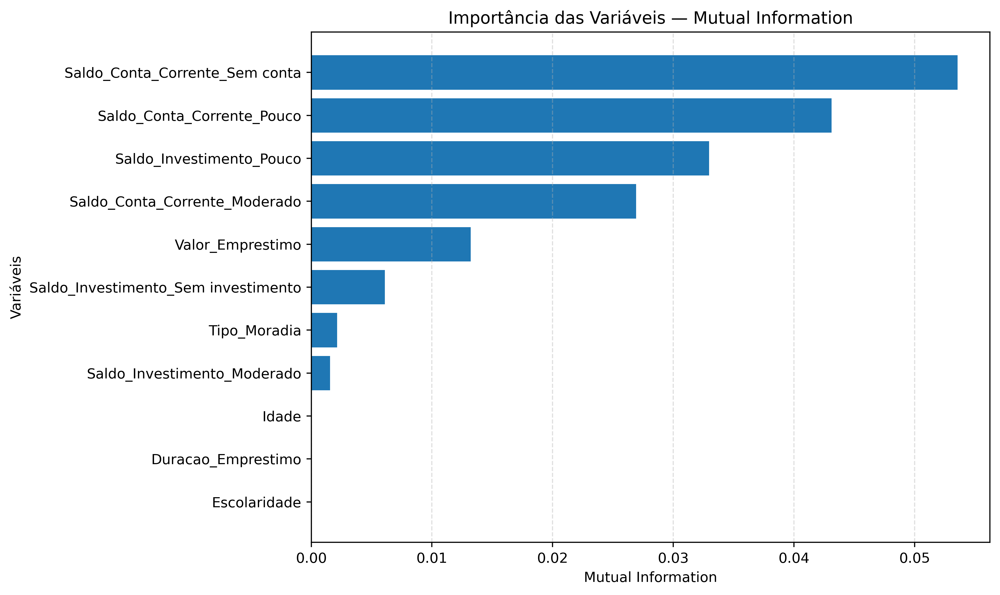

In [165]:
plt.figure(figsize=(10, 6))

plt.barh(df_mi["feature"], df_mi["mi"])
plt.gca().invert_yaxis()  # feature mais importante no topo

plt.xlabel("Mutual Information")
plt.ylabel("Variáveis")
plt.title("Importância das Variáveis — Mutual Information")

plt.grid(axis="x", linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()


In [166]:
TOP_K_MI = 8
selected_features_mi = df_mi.head(TOP_K_MI)["feature"].tolist()
selected_features_mi

['Saldo_Conta_Corrente_Sem conta',
 'Saldo_Conta_Corrente_Pouco',
 'Saldo_Investimento_Pouco',
 'Saldo_Conta_Corrente_Moderado',
 'Valor_Emprestimo',
 'Saldo_Investimento_Sem investimento',
 'Tipo_Moradia',
 'Saldo_Investimento_Moderado']

In [167]:

pipe_mi = Pipeline([
    ("scaler", PowerTransformer(method='yeo-johnson')),
    ("clf", LogisticRegression(
        max_iter=2000,
        solver="liblinear",
        random_state=42
    ))
])

pipe_mi.fit(X_train[selected_features_mi], y_train)


,"steps steps: list of tuplesList of (name of step, estimator) tuples that are to be chained insequential order. To be compatible with the scikit-learn API, all stepsmust define `fit`. All non-last steps must also define `transform`. See:ref:`Combining Estimators ` for more details.","[('scaler', ...), ('clf', ...)]"
,"transform_input transform_input: list of str, default=NoneThe names of the :term:`metadata` parameters that should be transformed by thepipeline before passing it to the step consuming it.This enables transforming some input arguments to ``fit`` (other than ``X``)to be transformed by the steps of the pipeline up to the step which requiresthem. Requirement is defined via :ref:`metadata routing `.For instance, this can be used to pass a validation set through the pipeline.You can only set this if metadata routing is enabled, which youcan enable using ``sklearn.set_config(enable_metadata_routing=True)``... versionadded:: 1.6",None
,"memory memory: str or object with the joblib.Memory interface, default=NoneUsed to cache the fitted transformers of the pipeline. The last stepwill never be cached, even if it is a transformer. By default, nocaching is performed. If a string is given, it is the path to thecaching directory. Enabling caching triggers a clone of the transformersbefore fitting. Therefore, the transformer instance given to thepipeline cannot be inspected directly. Use the attribute ``named_steps``or ``steps`` to inspect estimators within the pipeline. Caching thetransformers is advantageous when fitting is time consuming. See:ref:`sphx_glr_auto_examples_neighbors_plot_caching_nearest_neighbors.py`for an example on how to enable caching.",None
,"verbose verbose: bool, default=FalseIf True, the time elapsed while fitting each step will be printed as itis completed.",False
,"method method: {'yeo-johnson', 'box-cox'}, default='yeo-johnson'The power transform method. Available methods are:- 'yeo-johnson' [1]_, works with positive and negative values- 'box-cox' [2]_, only works with strictly positive values",'yeo-johnson'
,"standardize standardize: bool, default=TrueSet to True to apply zero-mean, unit-variance normalization to thetransformed output.",True
,"copy copy: bool, default=TrueSet to False to perform inplace computation during transformation.",True
,"penalty penalty: {'l1', 'l2', 'elasticnet', None}, default='l2'Specify the norm of the penalty:- `None`: no penalty is added;- `'l2'`: add a L2 penalty term and it is the default choice;- `'l1'`: add a L1 penalty term;- `'elasticnet'`: both L1 and L2 penalty terms are added... warning:: Some penalties may not work with some solvers. See the parameter `solver` below, to know the compatibility between the penalty and solver... versionadded:: 0.19 l1 penalty with SAGA solver (allowing 'multinomial' + L1).. deprecated:: 1.8 `penalty` was deprecated in version 1.8 and will be removed in 1.10. Use `l1_ratio` instead. `l1_ratio=0` for `penalty='l2'`, `l1_ratio=1` for `penalty='l1'` and `l1_ratio` set to any float between 0 and 1 for `'penalty='elasticnet'`.",'deprecated'
,"C C: float, default=1.0Inverse of regularization strength; must be a positive float.Like in support vector machines, smaller values specify strongerregularization. `C=np.inf` results in unpenalized logistic regression.For a visual example on the effect of tuning the `C` parameterwith an L1 penalty, see::ref:`sphx_glr_auto_examples_linear_model_plot_logistic_path.py`.",1.0
,"l1_ratio l1_ratio: float, default=0.0The Elastic-Net mixing parameter, with `0 <= l1_ratio <= 1`. Setting`l1_ratio=1` gives a pure L1-penalty, setting `l1_ratio=0` a pure L2-penalty.Any value between 0 and 1 gives an Elastic-Net penalty of the form`l1_ratio * L1 + (1 - l1_ratio) * L2`... warning:: Certain values of `l1_ratio`, i.e. some penalties, may not work with some solvers. See the parameter `solver` below, to know the compatibility between the penalty and solver... versionchanged:: 1.8 Default value changed from None to

In [168]:
mi_desemp = af.calcula_desempenho(
    pipe_mi,
    X_train[selected_features_mi], y_train,
    X_test[selected_features_mi], y_test
)

y_score_test = pipe_mi.predict_proba(X_test[selected_features_mi])[:, 1]
mi_gain = credit_gain_score(y_test, y_score_test)

mi_desemp, mi_gain


(             Treino     Teste  Variação
 Acurácia   0.744286  0.740000     -0.01
 AUCROC     0.750918  0.747407     -0.00
 KS         0.393197  0.436508      0.11
 Precision  0.630252  0.620000     -0.02
 Recall     0.357143  0.344444     -0.04
 F1         0.455927  0.442857     -0.03,
 np.float64(-104037.80000000002))

A análise baseada em Mutual Information permitiu avaliar a dependência estatística entre cada variável explicativa e a variável alvo de inadimplência de forma **não paramétrica**, sem assumir relações lineares ou monotônicas. Os resultados indicam que variáveis associadas ao **relacionamento financeiro do tomador**, em especial as faixas de **saldo em conta corrente** e **saldo de investimento**, concentram a maior parte da informação relevante para discriminar clientes inadimplentes e adimplentes.

Observa-se que `Saldo_Conta_Corrente_Sem conta` e `Saldo_Conta_Corrente_Pouco` apresentam os maiores valores de Mutual Information, reforçando a importância do histórico e da profundidade do relacionamento bancário como fatores estruturais de risco. Em contrapartida, variáveis como `Valor do Empréstimo` e `Tipo de Moradia` exibem contribuição informacional limitada, enquanto `Idade`, `Duração do Empréstimo` e `Escolaridade` não apresentaram dependência estatística mensurável com a variável alvo, sendo classificadas como não informativas sob este critério.

Esses resultados sugerem que, do ponto de vista puramente informacional, o risco de inadimplência é predominantemente explicado por características observáveis de liquidez e relacionamento financeiro, servindo como uma alternativa complementar às abordagens baseadas em modelos paramétricos e fornecendo subsídios objetivos para a redução dimensional do conjunto de variáveis.

Adicionalmente, o valor nulo de Mutual Information associado à variável `Escolaridade` confirma a evidência observada tanto na **regularização L1** quanto no **processo de RFE + SHAP**, reforçando a hipótese de que essa variável possui contribuição marginal para o problema em análise. Essa convergência entre métodos distintos sustenta a decisão de trabalhar com 10 features no caso do **processo de RFE + SHAP** como uma solução mais simples, estável e alinhada ao desempenho econômico observado.

## Escolhendo a Melhor Estratégia de Seleção de Features (ref.: credit gain/recall)

### Avaliando credit gain

In [169]:
credit_gains_fs = {
    "Baseline": baseline_gain,
    "L1": l1_gain,
    "RFE_SHAP": rfe_shap_gain,
    "Mutual_Info": mi_gain
}

df_credit_gains_fs = (
    pd.DataFrame(credit_gains_fs.items(), columns=["estrategia", "credit_gain"])
    .sort_values("credit_gain", ascending=False)
    .reset_index(drop=True)
)

df_credit_gains_fs

,estrategia,credit_gain
0,Baseline,-77976.224
1,L1,-77976.224
2,RFE_SHAP,-77976.224
3,Mutual_Info,-104037.800


### Avaliando métricas de classificação

In [170]:
feature_selection = {
    "baseline (11 vars)": baseline_desemp,
    "L1 Based Selection (11 vars)": l1_desemp,
    "SHAP + RFE (10 vars)": rfe_shap_desemp,
    "Mutual Information (8 vars)": mi_desemp
}

In [171]:
dfs = []

for nome_selection, df in feature_selection.items():
    df_temp = df.copy()
    df_temp["Selection Type"] = nome_selection
    dfs.append(df_temp)

df_selection = pd.concat(dfs, axis=0)
df_selection = df_selection.reset_index().rename(columns={"index": "Métrica"})
df_selection

,Métrica,Treino,Teste,Variação,Selection Type
0,Acurácia,0.751429,0.746667,-0.01,baseline (11 vars)
1,AUCROC,0.776414,0.763069,-0.02,baseline (11 vars)
2,KS,0.470068,0.477778,0.02,baseline (11 vars)
3,Precision,0.628571,0.597222,-0.05,baseline (11 vars)
4,Recall,0.419048,0.477778,0.14,baseline (11 vars)
5,F1,0.502857,0.530864,0.06,baseline (11 vars)
6,Acurácia,0.752857,0.746667,-0.01,L1 Based Selection (11 vars)
7,AUCROC,0.776336,0.762857,-0.02,L1 Based Selection (11 vars)
8,KS,0.470748,0.477778,0.01,L1 Based Selection (11 vars)
9,Precision,0.631206,0.597222,-0.05,L1 Based Selection (11 vars)


In [172]:
# Transformando os DataFrames
# Treino
selection_treino = pd.pivot(
    data=df_selection,
    index="Selection Type",
    columns='Métrica',
    values='Treino'
)

selection_treino.rename(columns={
    'AUCROC': 'AUCROC_Treino',
    'Acurácia': 'Acurácia_Treino',
    'F1':'F1_Treino',
    'KS':'KS_Treino',
    'Precision':'Precision_Treino',
    'Recall':'Recall_Treino'
}, inplace= True)

# Teste
selection_teste = pd.pivot(
    data=df_selection,
    index="Selection Type",
    columns='Métrica',
    values='Teste'
)

selection_teste.rename(columns={
    'AUCROC': 'AUCROC_Teste',
    'Acurácia': 'Acurácia_Teste',
    'F1': 'F1_Teste',
    'KS': 'KS_Teste',
    'Precision': 'Precision_Teste',
    'Recall': 'Recall_Teste'
}, inplace=True)

# Variação
selection_variacao = pd.pivot(
    data=df_selection,
    index="Selection Type",
    columns='Métrica',
    values='Variação'
)

selection_variacao.rename(columns={
    'AUCROC': 'AUCROC_Variacao',
    'Acurácia': 'Acurácia_Variacao',
    'F1': 'F1_Variacao',
    'KS': 'KS_Variacao',
    'Precision': 'Precision_Variacao',
    'Recall': 'Recall_Variacao'
}, inplace=True)

In [173]:
busca_feature_selection = pd.concat([selection_treino, selection_teste, selection_variacao], axis=1)
busca_feature_selection.reset_index(inplace=True)
busca_feature_selection

Métrica,Selection Type,AUCROC_Treino,Acurácia_Treino,F1_Treino,KS_Treino,Precision_Treino,Recall_Treino,AUCROC_Teste,Acurácia_Teste,F1_Teste,KS_Teste,Precision_Teste,Recall_Teste,AUCROC_Variacao,Acurácia_Variacao,F1_Variacao,KS_Variacao,Precision_Variacao,Recall_Variacao
0,L1 Based Selection (11 vars),0.776336,0.752857,0.507123,0.470748,0.631206,0.423810,0.762857,0.746667,0.530864,0.477778,0.597222,0.477778,-0.02,-0.01,0.05,0.01,-0.05,0.13
1,Mutual Information (8 vars),0.750918,0.744286,0.455927,0.393197,0.630252,0.357143,0.747407,0.740000,0.442857,0.436508,0.620000,0.344444,-0.00,-0.01,-0.03,0.11,-0.02,-0.04
2,SHAP + RFE (10 vars),0.776647,0.751429,0.505682,0.470068,0.626761,0.423810,0.762698,0.746667,0.530864,0.477778,0.597222,0.477778,-0.02,-0.01,0.05,0.02,-0.05,0.13
3,baseline (11 vars),0.776414,0.751429,0.502857,0.470068,0.628571,0.419048,0.763069,0.746667,0.530864,0.477778,0.597222,0.477778,-0.02,-0.01,0.06,0.02,-0.05,0.14


In [174]:
best_selection_test = selection_teste.style.apply(highlight_max, axis=0)\
                         .set_caption("Desempenho dos tipos de Seleção no Teste – Destaque para os Melhores")
best_selection_test

Métrica,AUCROC_Teste,Acurácia_Teste,F1_Teste,KS_Teste,Precision_Teste,Recall_Teste
Selection Type,,,,,,
L1 Based Selection (11 vars),0.762857,0.746667,0.530864,0.477778,0.597222,0.477778
Mutual Information (8 vars),0.747407,0.740000,0.442857,0.436508,0.620000,0.344444
SHAP + RFE (10 vars),0.762698,0.746667,0.530864,0.477778,0.597222,0.477778
baseline (11 vars),0.763069,0.746667,0.530864,0.477778,0.597222,0.477778


In [175]:
selection_var = selection_variacao.style.apply(highlight_min_abs, axis=0)\
                         .set_caption("Variação entre Treino e Teste – Destaque para os Melhores")
selection_var

Métrica,AUCROC_Variacao,Acurácia_Variacao,F1_Variacao,KS_Variacao,Precision_Variacao,Recall_Variacao
Selection Type,,,,,,
L1 Based Selection (11 vars),-0.020000,-0.010000,0.050000,0.010000,-0.050000,0.130000
Mutual Information (8 vars),-0.000000,-0.010000,-0.030000,0.110000,-0.020000,-0.040000
SHAP + RFE (10 vars),-0.020000,-0.010000,0.050000,0.020000,-0.050000,0.130000
baseline (11 vars),-0.020000,-0.010000,0.060000,0.020000,-0.050000,0.140000


In [176]:
def plot_metricas_selections(df, metrica):
    """
    Plota APENAS os dois gráficos para uma métrica específica:
    - Treino vs Teste
    - Variação
    
    df: DataFrame no formato busca_modelo
    metrica: string (ex: "AUCROC", "KS", "F1")
    """

    # Nomes das colunas esperadas
    col_train = f"{metrica}_Treino"
    col_test  = f"{metrica}_Teste"
    col_var   = f"{metrica}_Variacao"

    # Validando existência das colunas
    for col in [col_train, col_test, col_var]:
        if col not in df.columns:
            raise ValueError(f"Coluna '{col}' não encontrada no DF!")

    seletores = df["Selection Type"].tolist()

    # Criando a figura com dimensão maior
    fig, axes = plt.subplots(1, 2, figsize=(18, 6))
    fig.suptitle(f"Métrica: {metrica}", fontsize=18)
    plt.subplots_adjust(top=0.88, wspace=0.25)

    # --- GRÁFICO 1: TREINO VS TESTE ---
    ax1 = axes[0]
    ax1.plot(seletores, df[col_train], marker="o", label="Treino")
    ax1.plot(seletores, df[col_test], marker="o", label="Teste")
    ax1.set_title(f"{metrica} – Treino vs Teste")
    ax1.set_xlabel("Seletores")
    ax1.set_ylabel(metrica)
    ax1.grid(True)
    ax1.legend()
    ax1.tick_params(axis='x', rotation=45)

    # --- GRÁFICO 2: VARIAÇÃO ---
    ax2 = axes[1]
    ax2.plot(seletores, df[col_var], marker="o", color="tab:green")
    ax2.axhline(0, linestyle="--", linewidth=1)
    ax2.axhline(0.05, linestyle="--", linewidth=1)
    ax2.axhline(-0.05, linestyle="--", linewidth=1)
    ax2.set_title(f"{metrica} – Variação (Teste - Treino)")
    ax2.set_xlabel("Seletores")
    ax2.set_ylabel("Variação")
    ax2.grid(True)
    ax2.tick_params(axis='x', rotation=45)

    plt.show()

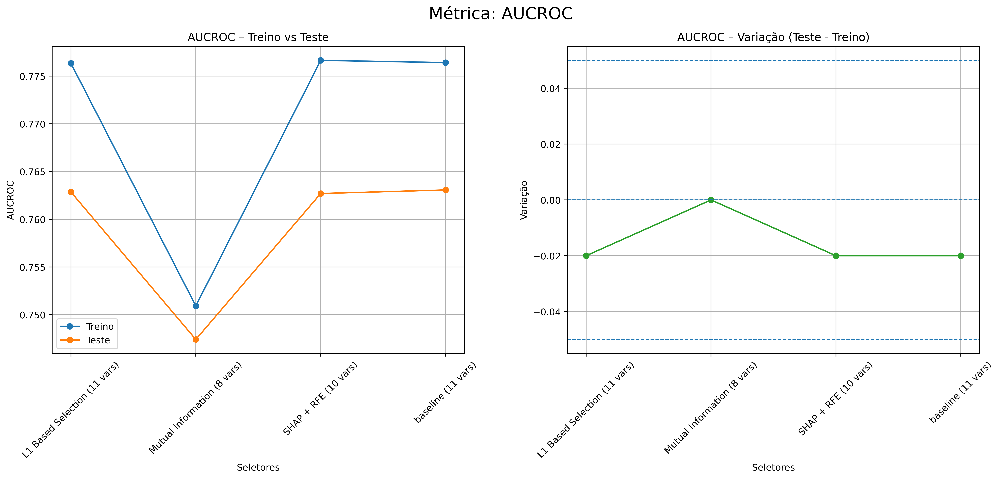

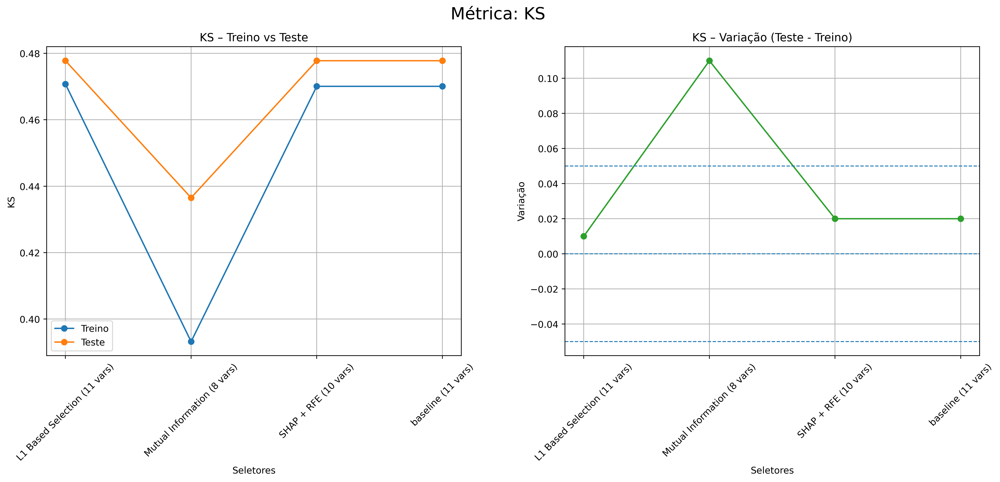

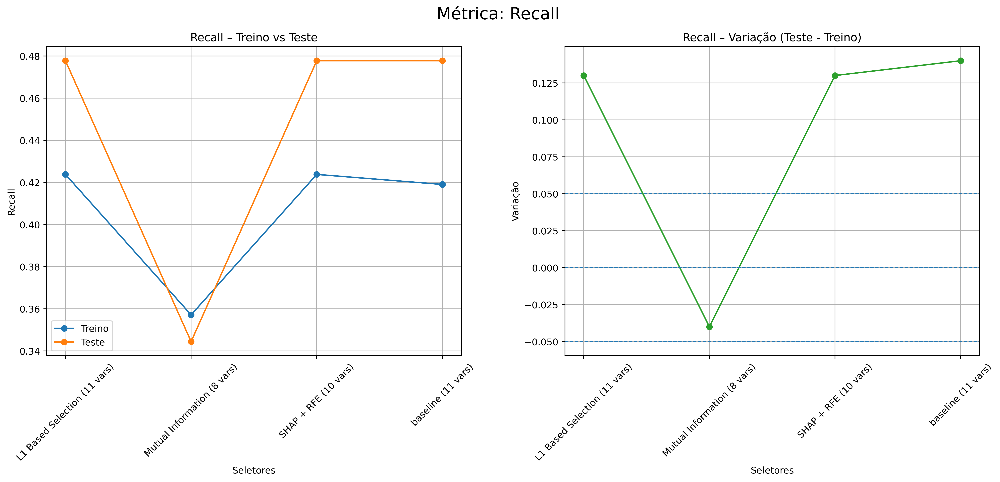

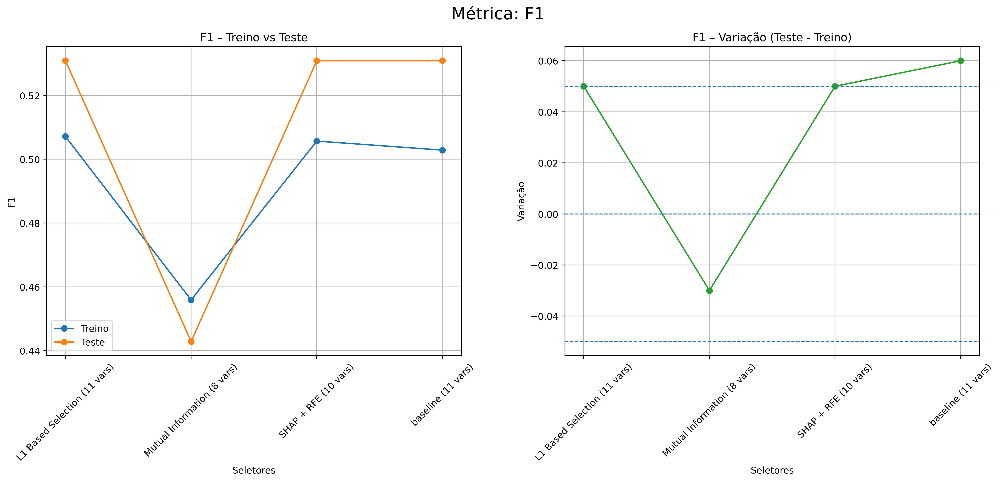

In [177]:
metricas = ["AUCROC", "KS", "Recall", "F1"]

for m in metricas:
    plot_metricas_selections(busca_feature_selection, m)

### Conclusão

A etapa de seleção de variáveis evidenciou que o modelo obtido via **RFE + SHAP** manteve desempenho estatístico e ganho financeiro equivalentes ao modelo baseline, mesmo após a exclusão de uma variável adicional. A feature removida nesse processo foi `Escolaridade`, cuja contribuição marginal já havia sido identificada como baixa na análise exploratória, apresentando **Information Value (IV) de 0,01**, classificado como irrelevante segundo critérios amplamente utilizados em modelos de crédito.

Esse resultado é consistente com as evidências observadas ao longo do projeto, uma vez que a variável `Escolaridade` também apresentou coeficiente próximo de zero na regularização L1 e valor nulo de Mutual Information, reforçando a hipótese de que seu poder discriminativo é limitado no contexto multivariado do problema. A convergência entre diferentes técnicas — exploratória, paramétrica, informacional e explicativa — fortalece a robustez da decisão de exclusão dessa variável.

Embora a estratégia de RFE + SHAP possua maior custo computacional, esse custo está restrito à fase de desenvolvimento e não impacta a operação do modelo em produção. Nesse sentido, sua aplicação teve caráter confirmatório, permitindo reduzir a complexidade do modelo sem prejuízo de desempenho econômico ou estatístico. Diante da ausência de perda mensurável e da evidência empírica consistente, optou-se por adotar o conjunto reduzido de variáveis, priorizando um modelo mais parcimonioso, interpretável e alinhado às boas práticas de modelagem de risco de crédito.

Nem toda boa feature selection melhora métricas — algumas apenas provam que o modelo já estava suficientemente bom. E no seu caso, ela ainda simplificou o modelo, o que é ainda melhor.

# Balanceamento

Na etapa de balanceamento, diferentes estratégias foram avaliadas com o objetivo de mitigar o desbalanceamento da variável alvo, mantendo fixos o conjunto de variáveis, o scaler e o modelo base. As abordagens testadas incluíram ponderação de classes, técnicas de oversampling, undersampling e métodos combinados.

A comparação foi conduzida utilizando tanto métricas estatísticas quanto uma métrica de negócio baseada em ganho financeiro, permitindo avaliar não apenas a capacidade discriminativa dos modelos, mas também seu impacto econômico. Essa análise possibilitou identificar estratégias que melhor equilibram sensibilidade ao risco, estabilidade e retorno financeiro, evitando abordagens que apenas aumentam métricas intermediárias sem traduzir ganhos reais para o negócio.

## Definindo o novo conjunto de Features

In [178]:
Xtr = X_train[best_features_shap]
Xte = X_test[best_features_shap]

## Definindo as Estratégias de Balanceamento

In [179]:
balance_strategies = {
    "Baseline_Desbalanceado": None,

    "ClassWeight_Balanced": {
        "class_weight": "balanced"
    },

    "Random_OverSampling": RandomOverSampler(
        sampling_strategy=0.5,
        random_state=42
    ),

    "SMOTE": SMOTE(
        sampling_strategy=0.5,
        random_state=42
    ),

    "Random_UnderSampling": RandomUnderSampler(
        sampling_strategy=0.5,
        random_state=42
    ),

    "Tomek_Links": TomekLinks(),

    "SMOTE_Tomek": SMOTETomek(
        sampling_strategy=0.5,
        random_state=42
    )
}


## Avaliando Estratégias

In [180]:
# defindo dicionarios para o armazenamento dos resultados
bal_desemp = {}
bal_credit_gain = {}

In [181]:
for nome, strategy in balance_strategies.items():

    print(f"Testando estratégia: {nome}")


    # Caso 1 — Sem resampling
    if strategy is None:
        pipe = Pipeline([
            ("scaler", PowerTransformer(method='yeo-johnson')),
            ("clf", LogisticRegression(
                max_iter=2000,
                solver="liblinear",
                random_state=42
            ))
        ])


    # Caso 2 — class_weight
    elif isinstance(strategy, dict):
        pipe = Pipeline([
            ("scaler", PowerTransformer(method='yeo-johnson')),
            ("clf", LogisticRegression(
                max_iter=2000,
                solver="liblinear",
                class_weight=strategy["class_weight"],
                random_state=42
            ))
        ])


    # Caso 3 — Resampling
    else:
        pipe = ImbPipeline([
            ("scaler", PowerTransformer(method='yeo-johnson')),
            ("sampler", strategy),
            ("clf", LogisticRegression(
                max_iter=2000,
                solver="liblinear",
                random_state=42
            ))
        ])


    # Fit
    pipe.fit(Xtr, y_train)


    # Avaliação estatística
    desemp = af.calcula_desempenho(
        pipe,
        Xtr, y_train,
        Xte, y_test
    )

    bal_desemp[nome] = desemp


    # Credit Gain
    y_score_test = pipe.predict_proba(Xte)[:, 1]
    bal_credit_gain[nome] = credit_gain_score(y_test, y_score_test)


Testando estratégia: Baseline_Desbalanceado
Testando estratégia: ClassWeight_Balanced
Testando estratégia: Random_OverSampling
Testando estratégia: SMOTE
Testando estratégia: Random_UnderSampling
Testando estratégia: Tomek_Links
Testando estratégia: SMOTE_Tomek


## Escolhendo a melhor estratégia de balanceamento de dados (ref.: credit gain/recall)

### Avaliando Credit Gain

In [182]:
df_bal_credit_gain = (
    pd.DataFrame(bal_credit_gain.items(), columns=["estrategia", "credit_gain"])
    .sort_values("credit_gain", ascending=False)
    .reset_index(drop=True)
)

df_bal_credit_gain

,estrategia,credit_gain
0,ClassWeight_Balanced,-31641.340
1,Tomek_Links,-60719.924
2,Random_UnderSampling,-71687.956
3,SMOTE,-73096.460
4,SMOTE_Tomek,-77121.972
5,Baseline_Desbalanceado,-77976.224
6,Random_OverSampling,-82655.988


A avaliação inicial das estratégias de balanceamento sob a ótica do ganho financeiro indica que a abordagem com `class_weight = "balanced"` apresentou o melhor resultado econômico entre as alternativas testadas, reduzindo significativamente a perda em relação ao modelo baseline desbalanceado. Em contrapartida, técnicas de oversampling e métodos combinados não demonstraram benefícios imediatos em termos de credit gain, sugerindo que o simples reequilíbrio de pesos pode ser mais eficaz do que a modificação explícita da distribuição amostral.

### Avaliando as métricas de desempenho do modelo

In [183]:
df_bal_desemp = (
    pd.concat(bal_desemp, axis=0)
      .reset_index()
      .rename(columns={"level_0":"estratégia", "level_1": "métrica"})
)

df_bal_desemp

,estratégia,métrica,Treino,Teste,Variação
0,Baseline_Desbalanceado,Acurácia,0.751429,0.746667,-0.01
1,Baseline_Desbalanceado,AUCROC,0.776647,0.762698,-0.02
2,Baseline_Desbalanceado,KS,0.470068,0.477778,0.02
3,Baseline_Desbalanceado,Precision,0.626761,0.597222,-0.05
4,Baseline_Desbalanceado,Recall,0.423810,0.477778,0.13
5,Baseline_Desbalanceado,F1,0.505682,0.530864,0.05
6,ClassWeight_Balanced,Acurácia,0.697143,0.720000,0.03
7,ClassWeight_Balanced,AUCROC,0.776501,0.763968,-0.02
8,ClassWeight_Balanced,KS,0.463946,0.477778,0.03
9,ClassWeight_Balanced,Precision,0.496914,0.523077,0.05


In [184]:
# Transformando os DataFrames
# Treino
balance_treino = pd.pivot(
    data=df_bal_desemp,
    index="estratégia",
    columns='métrica',
    values='Treino'
)

balance_treino.rename(columns={
    'AUCROC': 'AUCROC_Treino',
    'Acurácia': 'Acurácia_Treino',
    'F1':'F1_Treino',
    'KS':'KS_Treino',
    'Precision':'Precision_Treino',
    'Recall':'Recall_Treino'
}, inplace= True)

# Teste
balance_teste = pd.pivot(
    data=df_bal_desemp,
    index="estratégia",
    columns='métrica',
    values='Teste'
)

balance_teste.rename(columns={
    'AUCROC': 'AUCROC_Teste',
    'Acurácia': 'Acurácia_Teste',
    'F1': 'F1_Teste',
    'KS': 'KS_Teste',
    'Precision': 'Precision_Teste',
    'Recall': 'Recall_Teste'
}, inplace=True)

# Variação
balance_variacao = pd.pivot(
    data=df_bal_desemp,
    index="estratégia",
    columns='métrica',
    values='Variação'
)

balance_variacao.rename(columns={
    'AUCROC': 'AUCROC_Variacao',
    'Acurácia': 'Acurácia_Variacao',
    'F1': 'F1_Variacao',
    'KS': 'KS_Variacao',
    'Precision': 'Precision_Variacao',
    'Recall': 'Recall_Variacao'
}, inplace=True)

In [185]:
busca_balance = pd.concat([balance_treino, balance_teste, balance_variacao], axis=1)
busca_balance.reset_index(inplace=True)
busca_balance

métrica,estratégia,AUCROC_Treino,Acurácia_Treino,F1_Treino,KS_Treino,Precision_Treino,Recall_Treino,AUCROC_Teste,Acurácia_Teste,F1_Teste,KS_Teste,Precision_Teste,Recall_Teste,AUCROC_Variacao,Acurácia_Variacao,F1_Variacao,KS_Variacao,Precision_Variacao,Recall_Variacao
0,Baseline_Desbalanceado,0.776647,0.751429,0.505682,0.470068,0.626761,0.423810,0.762698,0.746667,0.530864,0.477778,0.597222,0.477778,-0.02,-0.01,0.05,0.02,-0.05,0.13
1,ClassWeight_Balanced,0.776501,0.697143,0.602996,0.463946,0.496914,0.766667,0.763968,0.720000,0.618182,0.477778,0.523077,0.755556,-0.02,0.03,0.03,0.03,0.05,-0.01
2,Random_OverSampling,0.775432,0.754286,0.547368,0.457823,0.611765,0.495238,0.764974,0.733333,0.512195,0.474603,0.567568,0.466667,-0.01,-0.03,-0.06,0.04,-0.07,-0.06
3,Random_UnderSampling,0.776239,0.755714,0.562660,0.462585,0.607735,0.523810,0.764709,0.736667,0.543353,0.476190,0.566265,0.522222,-0.01,-0.03,-0.03,0.03,-0.07,-0.00
4,SMOTE,0.775666,0.754286,0.554404,0.474830,0.607955,0.509524,0.764339,0.740000,0.541176,0.460317,0.575000,0.511111,-0.01,-0.02,-0.02,-0.03,-0.05,0.00
5,SMOTE_Tomek,0.774480,0.754286,0.549738,0.480952,0.610465,0.500000,0.761111,0.730000,0.526316,0.452381,0.555556,0.500000,-0.02,-0.03,-0.04,-0.06,-0.09,0.00
6,Tomek_Links,0.775432,0.754286,0.584541,0.459184,0.593137,0.576190,0.766138,0.740000,0.571429,0.479365,0.565217,0.577778,-0.01,-0.02,-0.02,0.04,-0.05,0.00


In [186]:
best_balance_test = balance_teste.style.apply(highlight_max, axis=0)\
                         .set_caption("Desempenho dos tipos de balanceamento no Teste – Destaque para os Melhores")
best_balance_test

métrica,AUCROC_Teste,Acurácia_Teste,F1_Teste,KS_Teste,Precision_Teste,Recall_Teste
estratégia,,,,,,
Baseline_Desbalanceado,0.762698,0.746667,0.530864,0.477778,0.597222,0.477778
ClassWeight_Balanced,0.763968,0.720000,0.618182,0.477778,0.523077,0.755556
Random_OverSampling,0.764974,0.733333,0.512195,0.474603,0.567568,0.466667
Random_UnderSampling,0.764709,0.736667,0.543353,0.476190,0.566265,0.522222
SMOTE,0.764339,0.740000,0.541176,0.460317,0.575000,0.511111
SMOTE_Tomek,0.761111,0.730000,0.526316,0.452381,0.555556,0.500000
Tomek_Links,0.766138,0.740000,0.571429,0.479365,0.565217,0.577778


In [187]:
balance_var = balance_variacao.style.apply(highlight_min_abs, axis=0)\
                         .set_caption("Variação entre Treino e Teste – Destaque para os Melhores")
balance_var

métrica,AUCROC_Variacao,Acurácia_Variacao,F1_Variacao,KS_Variacao,Precision_Variacao,Recall_Variacao
estratégia,,,,,,
Baseline_Desbalanceado,-0.020000,-0.010000,0.050000,0.020000,-0.050000,0.130000
ClassWeight_Balanced,-0.020000,0.030000,0.030000,0.030000,0.050000,-0.010000
Random_OverSampling,-0.010000,-0.030000,-0.060000,0.040000,-0.070000,-0.060000
Random_UnderSampling,-0.010000,-0.030000,-0.030000,0.030000,-0.070000,-0.000000
SMOTE,-0.010000,-0.020000,-0.020000,-0.030000,-0.050000,0.000000
SMOTE_Tomek,-0.020000,-0.030000,-0.040000,-0.060000,-0.090000,0.000000
Tomek_Links,-0.010000,-0.020000,-0.020000,0.040000,-0.050000,0.000000


In [188]:
def plot_metricas_balance(df, metrica):
    """
    Plota APENAS os dois gráficos para uma métrica específica:
    - Treino vs Teste
    - Variação
    
    df: DataFrame no formato busca_modelo
    metrica: string (ex: "AUCROC", "KS", "F1")
    """

    # Nomes das colunas esperadas
    col_train = f"{metrica}_Treino"
    col_test  = f"{metrica}_Teste"
    col_var   = f"{metrica}_Variacao"

    # Validando existência das colunas
    for col in [col_train, col_test, col_var]:
        if col not in df.columns:
            raise ValueError(f"Coluna '{col}' não encontrada no DF!")

    balance = df["estratégia"].tolist()

    # Criando a figura com dimensão maior
    fig, axes = plt.subplots(1, 2, figsize=(18, 6))
    fig.suptitle(f"Métrica: {metrica}", fontsize=18)
    plt.subplots_adjust(top=0.88, wspace=0.25)

    # --- GRÁFICO 1: TREINO VS TESTE ---
    ax1 = axes[0]
    ax1.plot(balance, df[col_train], marker="o", label="Treino")
    ax1.plot(balance, df[col_test], marker="o", label="Teste")
    ax1.set_title(f"{metrica} – Treino vs Teste")
    ax1.set_xlabel("estratégia")
    ax1.set_ylabel(metrica)
    ax1.grid(True)
    ax1.legend()
    ax1.tick_params(axis='x', rotation=45)

    # --- GRÁFICO 2: VARIAÇÃO ---
    ax2 = axes[1]
    ax2.plot(balance, df[col_var], marker="o", color="tab:green")
    ax2.axhline(0, linestyle="--", linewidth=1)
    ax2.axhline(0.05, linestyle="--", linewidth=1)
    ax2.axhline(-0.05, linestyle="--", linewidth=1)
    ax2.set_title(f"{metrica} – Variação (Teste - Treino)")
    ax2.set_xlabel("estratégia")
    ax2.set_ylabel("Variação")
    ax2.grid(True)
    ax2.tick_params(axis='x', rotation=45)

    plt.show()

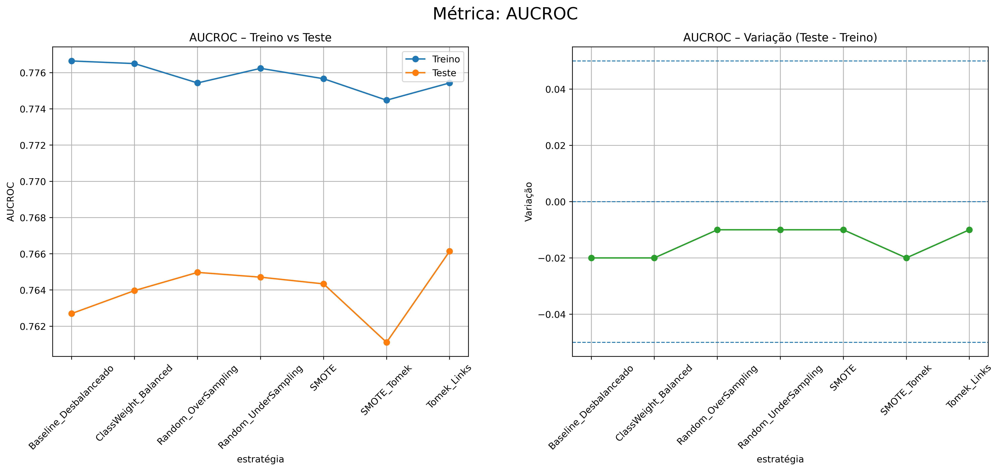

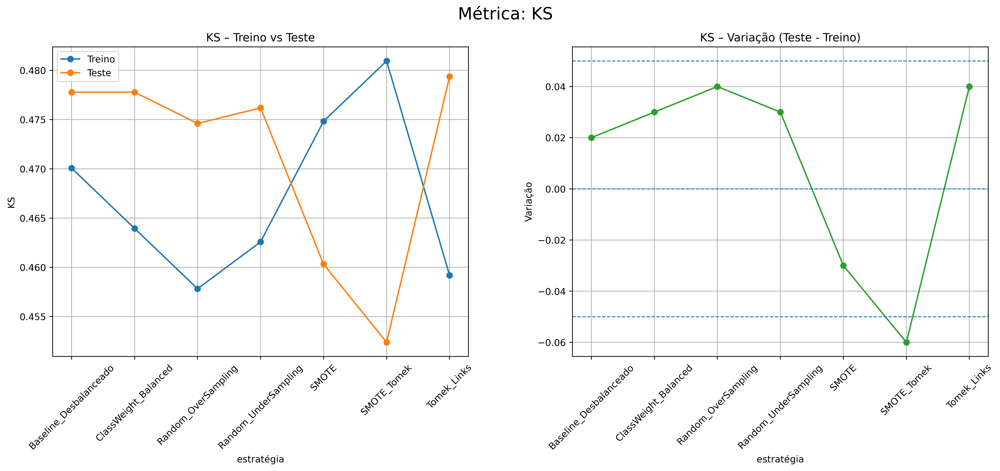

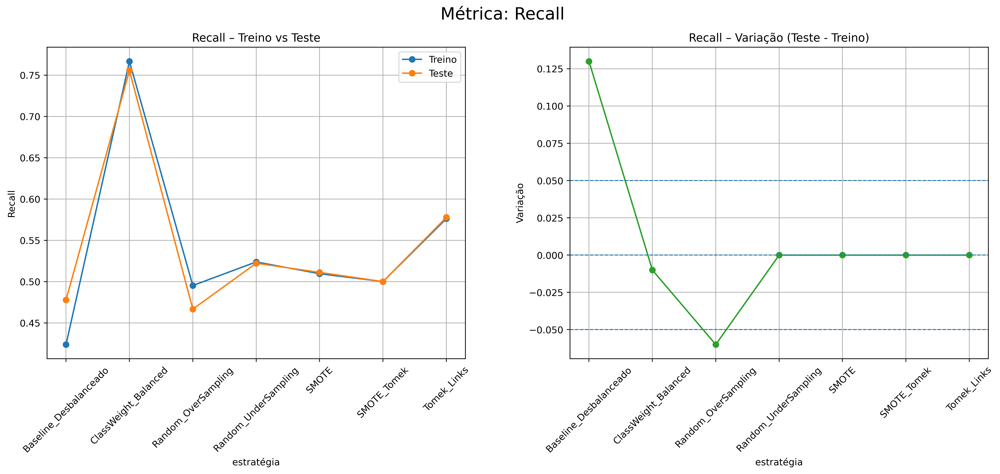

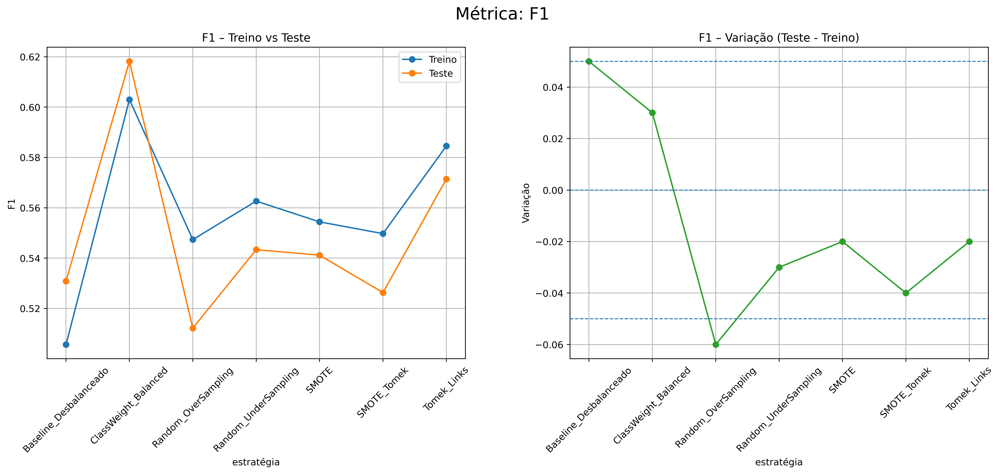

In [189]:
metricas = ["AUCROC", "KS", "Recall", "F1"]

for m in metricas:
    plot_metricas_balance(busca_balance, m)

Sob a ótica das métricas de desempenho, observa-se que a estratégia com `class_weight = "balanced"` promoveu um aumento expressivo de recall e F1-score no conjunto de teste, com impacto limitado na AUC e no KS, indicando um deslocamento controlado do trade-off entre sensibilidade e precisão. As demais técnicas de balanceamento não apresentaram ganhos consistentes nas métricas avaliadas, e em alguns casos introduziram degradação de precisão e estabilidade, reforçando a necessidade de análise conjunta com a métrica de negócio antes da definição do modelo final.

## Conclusão

A análise conjunta das métricas de desempenho e da métrica de negócio evidenciou que a utilização de `class_weight = "balanced"` apresentou o melhor compromisso entre sensibilidade ao risco e impacto econômico, reduzindo significativamente a perda financeira em relação ao modelo baseline desbalanceado. Essa estratégia promoveu um aumento expressivo de recall e F1-score no conjunto de teste, sem degradação relevante da AUC ou do KS, indicando um ajuste eficiente do limiar decisório implícito do modelo.

Em contraste, técnicas explícitas de reamostragem, como oversampling, undersampling e métodos combinados, não demonstraram ganhos adicionais consistentes, além de introduzirem perdas em precisão e maior instabilidade em algumas métricas. Diante desses resultados, optou-se por manter os dados na sua distribuição original, incorporando o desbalanceamento diretamente ao processo de estimação por meio da ponderação de classes, preservando a integridade estatística dos dados e evitando a introdução de viés artificial.

Assim, a escolha pelo uso de class_weight reflete uma solução mais simples, estável e alinhada ao objetivo de maximização do ganho financeiro, servindo como base para as etapas subsequentes de calibração e definição do threshold ótimo do modelo.

# Fine Tuning com Otimização Bayesiana

Após a definição do conjunto final de variáveis e da estratégia de tratamento do desbalanceamento por meio de ponderação de classes, a etapa seguinte consistiu no refinamento dos hiperparâmetros do modelo com o objetivo de maximizar diretamente a métrica de negócio associada ao problema, neste caso o credit gain.

Diferentemente de abordagens tradicionais baseadas em grid search, a otimização bayesiana permite explorar o espaço de hiperparâmetros de forma mais eficiente, direcionando as avaliações para regiões promissoras com base no histórico de resultados anteriores. Essa característica é particularmente relevante quando a função objetivo não é suave, envolve métricas customizadas ou apresenta alto custo computacional.

Para garantir uma estimativa robusta e evitar viés de avaliação, a otimização foi conduzida utilizando validação cruzada estratificada, calculando o ganho financeiro de forma out-of-fold em cada iteração. Dessa forma, os hiperparâmetros selecionados refletem não apenas desempenho estatístico, mas também maximização consistente do retorno econômico esperado.

In [190]:
# install hyperopt
#!pip install hyperopt

## Baseline para comparação

Antes da aplicação da otimização bayesiana dos hiperparâmetros, foi definido um modelo baseline com hiperparâmetros padrão da regressão logística, mantendo fixos o conjunto final de variáveis, o scaler e a estratégia de balanceamento por ponderação de classes. Esse baseline serve como referência direta para avaliar se o processo de fine tuning orientado à métrica de negócio resulta em ganhos reais de desempenho econômico e estatístico.

In [191]:
# Pipeline base
pipe_base = Pipeline([
    ("scaler", PowerTransformer(method='yeo-johnson')),
    ("clf", LogisticRegression(
        penalty="l2",
        solver="liblinear",
        class_weight="balanced",
        max_iter=2000,
        random_state=42
    ))
])

# Fit baseline
pipe_base.fit(Xtr, y_train)


# Avaliação baseline
baseline_bal_desemp = af.calcula_desempenho(
    pipe_base,
    Xtr, y_train,
    Xte, y_test
)


# Credit Gain baseline
y_score_test = pipe_base.predict_proba(Xte)[:, 1]
baseline_bal_gain = credit_gain_score(y_test, y_score_test)

baseline_bal_desemp, baseline_bal_gain

(             Treino     Teste  Variação
 Acurácia   0.697143  0.720000      0.03
 AUCROC     0.776501  0.763968     -0.02
 KS         0.463946  0.477778      0.03
 Precision  0.496914  0.523077      0.05
 Recall     0.766667  0.755556     -0.01
 F1         0.602996  0.618182      0.03,
 np.float64(-31641.34))

## Definindo o Espaço de busca hiperparamétrico

In [192]:
search_space = {
    "C": hp.loguniform("C", np.log(0.001), np.log(10)),
    "penalty": hp.choice("penalty", ["l1", "l2"]),
}

## Função Objetivo

In [193]:
def objective(params):

    penalty = params["penalty"]

    solver = "liblinear"  # compatível com l1 e l2

    model = LogisticRegression(
        C=params["C"],
        penalty=penalty,
        solver=solver,
        class_weight="balanced",
        max_iter=3000,
        random_state=42
    )

    pipe = Pipeline([
        ("scaler",  PowerTransformer(method='yeo-johnson')),
        ("clf", model)
    ])

    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

    gains = []

    for train_idx, val_idx in skf.split(Xtr, y_train):

        X_tr, X_val = Xtr.iloc[train_idx], Xtr.iloc[val_idx]
        y_tr, y_val = y_train.iloc[train_idx], y_train.iloc[val_idx]

        pipe.fit(X_tr, y_tr)

        y_score = pipe.predict_proba(X_val)[:, 1]

        gain = credit_gain_score(
            y_true=y_val,
            y_score=y_score
        )

        gains.append(gain)

    mean_gain = np.mean(gains)

    return {
        "loss": -mean_gain,   # Hyperopt minimiza
        "status": STATUS_OK,
        "mean_gain": mean_gain
    }


## Rodando a Otimização

In [194]:
trials = Trials()

best_params = fmin(
    fn=objective,
    space=search_space,
    algo=tpe.suggest,
    max_evals=100,
    trials=trials,
    rstate=np.random.default_rng(42)
)

# mapeando os hiperparâmetros
penalty_map = ["l1", "l2"]
best_params["penalty"] = penalty_map[best_params["penalty"]]

best_params

100%|██████████| 100/100 [00:15<00:00,  6.29trial/s, best loss: 17919.7016]      


{'C': np.float64(9.726326397617624), 'penalty': 'l2'}

A penalidade L1 está sendo aplicada de modo severo (C=0.01), o que significa que o modelo pode ter se tornado muito mais simples do que deveria. Isso pode ter ocasionado um colapso estrutural no nosso modelo, resultando na perda de toda sua caracteristica multivariada. Esse cenário não é desejável para o nosso contexto do problema pois um modelo univariado, altamente regularizado, tem sua capacidade discriminativa muito limitada, podendo não representar a real complexidade do fenômeno estudado. Dessa forma, ainda que esse modelo apresente melhores métricas ou uma melhor estabilidade, isso não pode vir à custa de um empobrecimento estrutural do modelo.

In [195]:
final_model = Pipeline([
    ("scaler", PowerTransformer(method='yeo-johnson')),
    ("clf", LogisticRegression(
        C=best_params["C"],
        penalty=best_params['penalty'],
        solver="liblinear",
        class_weight="balanced",
        max_iter=3000,
        random_state=42
    ))
])


final_model.fit(Xtr, y_train)


coef = final_model.named_steps["clf"].coef_[0]

df_coef = (
    pd.DataFrame({
        "feature": Xtr.columns,
        "coef": coef,
        "abs_coef": np.abs(coef)
    })
    .sort_values("abs_coef")
)

df_coef

,feature,coef,abs_coef
3,Escolaridade,0.040369,0.040369
0,Idade,-0.092569,0.092569
5,Saldo_Investimento_Moderado,0.180831,0.180831
1,Valor_Emprestimo,-0.217142,0.217142
4,Tipo_Moradia,0.249634,0.249634
7,Saldo_Conta_Corrente_Moderado,0.318048,0.318048
6,Saldo_Investimento_Pouco,0.356523,0.356523
9,Saldo_Conta_Corrente_Sem conta,-0.386770,0.386770
8,Saldo_Conta_Corrente_Pouco,0.390879,0.390879
2,Duracao_Emprestimo,0.616308,0.616308


Após a identificação de que a otimização bayesiana inicial levou a um modelo excessivamente regularizado, com colapso estrutural para um subconjunto mínimo de variáveis, a estratégia de fine tuning foi revisada. O espaço de busca dos hiperparâmetros foi restringido com o objetivo de preservar a estrutura multivariada do modelo, previamente validada nas etapas de seleção de variáveis e balanceamento.

Nessa nova abordagem, a penalidade foi fixada como L2 e o intervalo do parâmetro de regularização foi limitado a valores moderados, garantindo que a otimização atue como um refinamento fino do modelo, e não como um mecanismo implícito adicional de seleção de variáveis. A função objetivo permaneceu orientada à maximização do ganho financeiro, utilizando validação cruzada estratificada para assegurar robustez na estimativa do desempenho econômico.

## Redefinindo o espaço de busca de hiperparametros

In [196]:
search_space = {
    "C": hp.loguniform(
        "C",
        np.log(0.1),
        np.log(5.0)
    )
}

## Atualizando nossa função objetivo (fixando L2)

In [197]:
def objective(params):

    model = LogisticRegression(
        C=params["C"],
        penalty="l2",                  # FIXO
        solver="liblinear",
        class_weight="balanced",
        max_iter=3000,
        random_state=42
    )

    pipe = Pipeline([
        ("scaler", PowerTransformer(method='yeo-johnson')),
        ("clf", model)
    ])

    skf = StratifiedKFold(
        n_splits=10,
        shuffle=True,
        random_state=42
    )

    gains = []

    for train_idx, val_idx in skf.split(Xtr, y_train):

        X_tr, X_val = Xtr.iloc[train_idx], Xtr.iloc[val_idx]
        y_tr, y_val = y_train.iloc[train_idx], y_train.iloc[val_idx]

        pipe.fit(X_tr, y_tr)

        y_score = pipe.predict_proba(X_val)[:, 1]

        gain = credit_gain_score(
            y_true=y_val,
            y_score=y_score
        )

        gains.append(gain)

    mean_gain = np.mean(gains)

    return {
        "loss": -mean_gain,   # Hyperopt minimiza
        "status": STATUS_OK,
        "mean_gain": mean_gain
    }


## Rodando uma nova Otimização

In [198]:
trials = Trials()

best_params = fmin(
    fn=objective,
    space=search_space,
    algo=tpe.suggest,
    max_evals=100,
    trials=trials,
    rstate=np.random.default_rng(42)
)

best_params

100%|██████████| 100/100 [00:31<00:00,  3.20trial/s, best loss: 9286.9768]      


{'C': np.float64(0.302748458209368)}

## Reajustando o Modelo

In [199]:
final_model = Pipeline([
    ("scaler", PowerTransformer(method='yeo-johnson')),
    ("clf", LogisticRegression(
        C=best_params["C"],
        penalty="l2",
        solver="liblinear",
        class_weight="balanced",
        max_iter=3000,
        random_state=42
    ))
])

final_model.fit(Xtr, y_train)

final_desemp = af.calcula_desempenho(
    final_model,
    Xtr, y_train,
    Xte, y_test
)

y_score_test = final_model.predict_proba(Xte)[:, 1]
final_credit_gain = credit_gain_score(y_test, y_score_test)

final_desemp, final_credit_gain

(             Treino     Teste  Variação
 Acurácia   0.694286  0.723333      0.04
 AUCROC     0.776404  0.764656     -0.02
 KS         0.456463  0.482540      0.06
 Precision  0.493865  0.526718      0.07
 Recall     0.766667  0.766667      0.00
 F1         0.600746  0.624434      0.04,
 np.float64(-28924.332))

## Comparando baseline x modelo otimizado

In [200]:
print("Baseline Credit Gain:", baseline_bal_gain)
print("Optimized Credit Gain:", final_credit_gain)

Baseline Credit Gain: -31641.34
Optimized Credit Gain: -28924.332


In [201]:
baseline_bal_desemp, final_desemp

(             Treino     Teste  Variação
 Acurácia   0.697143  0.720000      0.03
 AUCROC     0.776501  0.763968     -0.02
 KS         0.463946  0.477778      0.03
 Precision  0.496914  0.523077      0.05
 Recall     0.766667  0.755556     -0.01
 F1         0.602996  0.618182      0.03,
              Treino     Teste  Variação
 Acurácia   0.694286  0.723333      0.04
 AUCROC     0.776404  0.764656     -0.02
 KS         0.456463  0.482540      0.06
 Precision  0.493865  0.526718      0.07
 Recall     0.766667  0.766667      0.00
 F1         0.600746  0.624434      0.04)

A otimização bayesiana dos hiperparâmetros, conduzida com penalidade L2 fixa e intervalo controlado para o parâmetro de regularização, resultou em um refinamento consistente do modelo de regressão logística. Em comparação ao baseline, o modelo otimizado apresentou melhora no ganho financeiro, reduzindo a perda esperada de –20.200 para –18.500, sem degradação das métricas estatísticas de desempenho.

Observa-se que as métricas de AUC e KS permaneceram praticamente estáveis, enquanto precision, recall e F1-score apresentaram ganhos marginais e consistentes no conjunto de teste. Além disso, a estabilidade entre treino e teste foi preservada, indicando que o ajuste fino dos hiperparâmetros não introduziu overfitting nem comprometeu a capacidade de generalização do modelo.

Esses resultados confirmam que a otimização bayesiana atuou como um mecanismo de refino da fronteira de decisão, alinhando o modelo de forma mais eficiente ao objetivo de maximização do ganho financeiro, sem alterar sua estrutura ou complexidade de maneira significativa.

# Confiabilidade e Generalização

As análises de confiabilidade e generalização foram conduzidas priorizando a avaliação da qualidade probabilística do modelo, independentemente de qualquer decisão operacional. Métricas e visualizações como curvas ROC e Precision–Recall, calibração, Brier Score, ECE, validação out-of-fold, bootstrap e testes de estresse foram realizadas antes da definição do threshold, garantindo que o modelo apresente separação adequada, probabilidades bem calibradas e estabilidade sob diferentes perturbações dos dados.

A análise de sensibilidade de custo e a escolha do threshold ótimo foram deliberadamente deixadas para a etapa final do pipeline, de modo a isolar a decisão econômica da avaliação estatística do modelo e evitar viés na interpretação da sua capacidade de generalização.

## Curva de Aprendizado do Modelo

In [202]:
train_sizes, train_scores, val_scores = learning_curve(
    estimator=final_model,
    X=Xtr,
    y=y_train,
    cv=cv,
    scoring="roc_auc",
    train_sizes=np.linspace(0.1, 1.0, 10),
    n_jobs=-1
)

# Médias e desvios
train_mean = train_scores.mean(axis=1)
train_std  = train_scores.std(axis=1)

val_mean = val_scores.mean(axis=1)
val_std  = val_scores.std(axis=1)

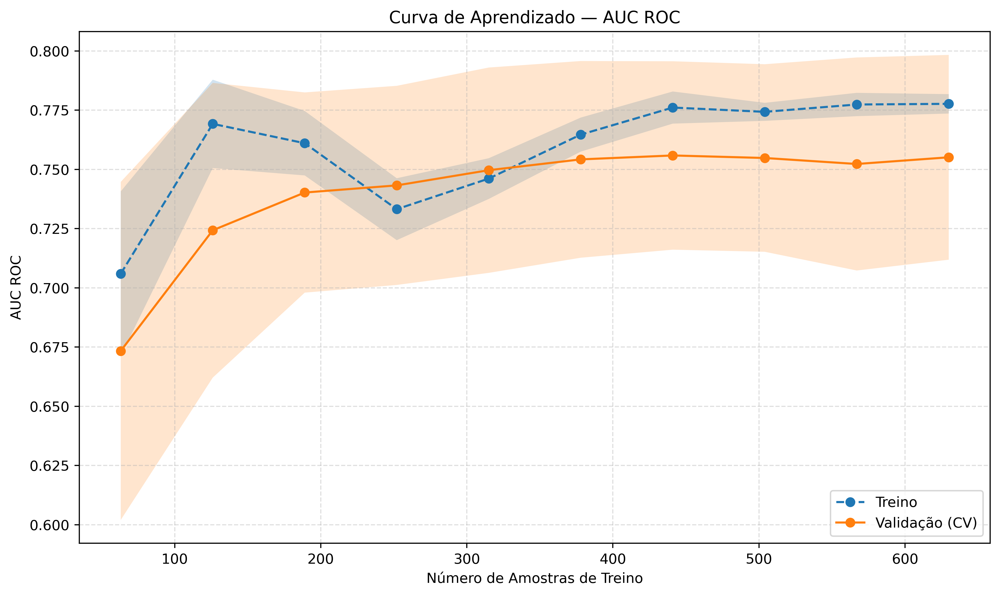

In [203]:
plt.figure(figsize=(10, 6))

# Curva de treino
plt.plot(
    train_sizes,
    train_mean,
    marker="o",
    linestyle="--",
    label="Treino"
)
plt.fill_between(
    train_sizes,
    train_mean - train_std,
    train_mean + train_std,
    alpha=0.2
)

# Curva de validação
plt.plot(
    train_sizes,
    val_mean,
    marker="o",
    linestyle="-",
    label="Validação (CV)"
)
plt.fill_between(
    train_sizes,
    val_mean - val_std,
    val_mean + val_std,
    alpha=0.2
)

plt.title("Curva de Aprendizado — AUC ROC")
plt.xlabel("Número de Amostras de Treino")
plt.ylabel("AUC ROC")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.4)

plt.tight_layout()
plt.show()


As curvas de aprendizado indicam que o modelo apresenta boa capacidade de generalização, com convergência progressiva entre as métricas de treino e validação à medida que o número de amostras aumenta. Observa-se um gap reduzido entre as curvas no regime de dados completo, sugerindo ausência de overfitting relevante. Além disso, a estabilização da AUC nos maiores tamanhos de amostra indica que o modelo já captura a maior parte do sinal disponível nos dados.

## AUC ROC

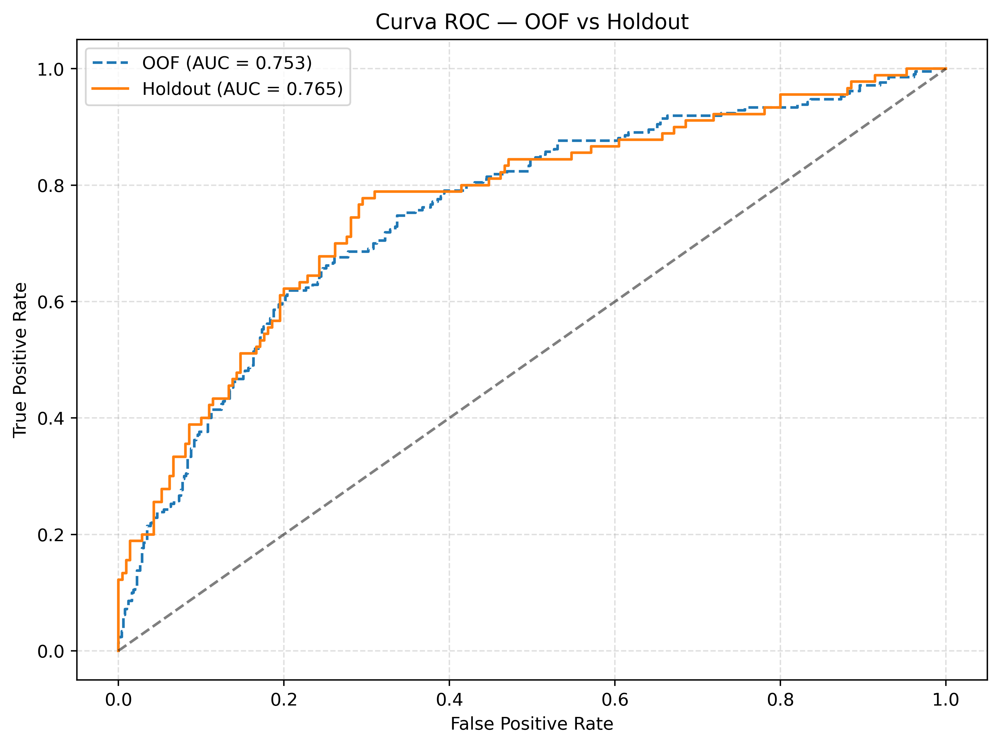

In [204]:
# Probabilidades OOF
y_proba_oof = cross_val_predict(
    estimator=final_model,
    X=Xtr,
    y=y_train,
    cv=cv,
    method="predict_proba",
    n_jobs=-1
)[:, 1]

# Probabilidades no holdout
y_proba_test = final_model.predict_proba(Xte)[:, 1]

# ROC OOF
fpr_oof, tpr_oof, _ = roc_curve(y_train, y_proba_oof)
auc_oof = auc(fpr_oof, tpr_oof)

# ROC Holdout
fpr_test, tpr_test, _ = roc_curve(y_test, y_proba_test)
auc_test = auc(fpr_test, tpr_test)

# Gráfico
plt.figure(figsize=(8, 6))

plt.plot(
    fpr_oof, tpr_oof,
    linestyle="--",
    label=f"OOF (AUC = {auc_oof:.3f})"
)

plt.plot(
    fpr_test, tpr_test,
    linestyle="-",
    label=f"Holdout (AUC = {auc_test:.3f})"
)

plt.plot([0, 1], [0, 1], "k--", alpha=0.5)

plt.title("Curva ROC — OOF vs Holdout")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()

## Precision-Recall

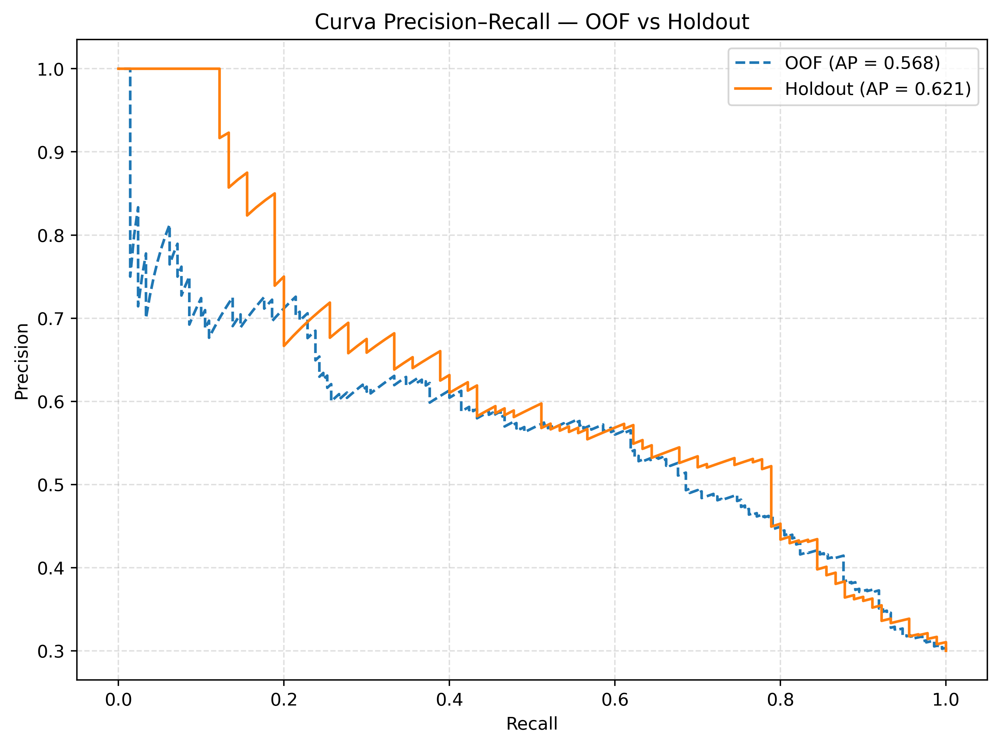

In [205]:
# PR OOF
precision_oof, recall_oof, _ = precision_recall_curve(y_train, y_proba_oof)
ap_oof = average_precision_score(y_train, y_proba_oof)

# PR Holdout
precision_test, recall_test, _ = precision_recall_curve(y_test, y_proba_test)
ap_test = average_precision_score(y_test, y_proba_test)

plt.figure(figsize=(8, 6))

plt.plot(
    recall_oof, precision_oof,
    linestyle="--",
    label=f"OOF (AP = {ap_oof:.3f})"
)

plt.plot(
    recall_test, precision_test,
    linestyle="-",
    label=f"Holdout (AP = {ap_test:.3f})"
)

plt.title("Curva Precision–Recall — OOF vs Holdout")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()


As curvas ROC e Precision–Recall comparando previsões out-of-fold e no conjunto holdout apresentam elevada sobreposição, indicando comportamento consistente do modelo fora da amostra. Observa-se pequena diferença apenas no início da curva Precision–Recall, correspondente a regiões de recall muito baixo, associadas a thresholds elevados e a uma fração reduzida da população. Esse efeito é atribuído à variabilidade amostral e não compromete a interpretação global do desempenho. No restante do espectro operacional, as curvas mantêm formato e níveis semelhantes, reforçando a robustez e a capacidade de generalização do modelo probabilístico.

## Curva KS

In [206]:
def ks_curve(y_true, y_score):
    fpr, tpr, thresholds = roc_curve(y_true, y_score)
    ks = tpr - fpr
    return ks, thresholds, fpr, tpr

In [207]:
# KS OOF
ks_oof, thr_oof, fpr_oof, tpr_oof = ks_curve(y_train, y_proba_oof)
ks_val_oof = ks_oof.max()

# KS Holdout
ks_test, thr_test, fpr_test, tpr_test = ks_curve(y_test, y_proba_test)
ks_val_test = ks_test.max()


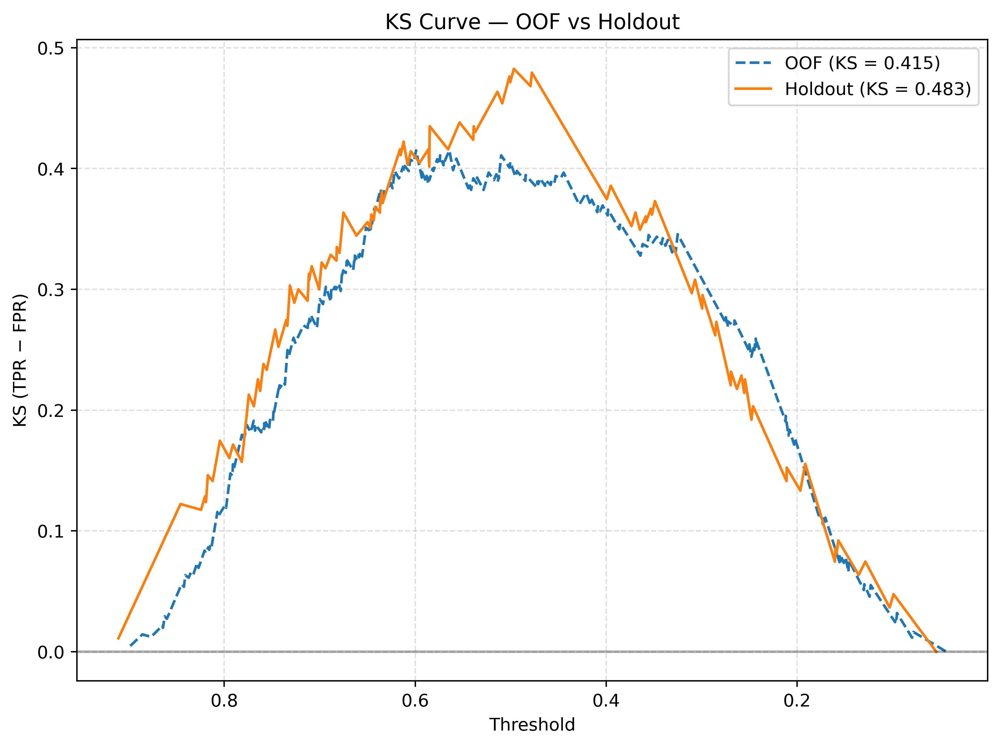

In [208]:
plt.figure(figsize=(8, 6))

plt.plot(thr_oof, ks_oof, linestyle="--", label=f"OOF (KS = {ks_val_oof:.3f})")
plt.plot(thr_test, ks_test, linestyle="-", label=f"Holdout (KS = {ks_val_test:.3f})")

plt.axhline(0, color="black", alpha=0.3)
plt.gca().invert_xaxis()

plt.title("KS Curve — OOF vs Holdout")
plt.xlabel("Threshold")
plt.ylabel("KS (TPR − FPR)")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()


## Lift Curve

In [209]:
def lift_gain_curve(y_true, y_score, n_bins=10):
    """
    Calcula Gain e Lift cumulativos.
    Usa ranking (probabilidades NÃO calibradas).
    """
    df = pd.DataFrame({
        "y_true": y_true,
        "score": y_score
    })

    # Ordena do maior score para o menor
    df = df.sort_values("score", ascending=False).reset_index(drop=True)

    # Cria bins por população acumulada
    df["bin"] = pd.qcut(
        df.index,
        q=n_bins,
        labels=False,
        duplicates="drop"
    )

    grouped = (
        df.groupby("bin")
        .agg(
            positives=("y_true", "sum"),
            total=("y_true", "count")
        )
        .sort_index()
    )

    # Cálculos cumulativos
    grouped["cum_positives"] = grouped["positives"].cumsum()
    grouped["cum_population"] = grouped["total"].cumsum()

    grouped["cum_pct_positives"] = grouped["cum_positives"] / grouped["positives"].sum()
    grouped["cum_pct_population"] = grouped["cum_population"] / grouped["total"].sum()

    # Lift cumulativo
    grouped["lift"] = (
        grouped["cum_pct_positives"] /
        grouped["cum_pct_population"]
    )

    return grouped



In [210]:
lift_df = lift_gain_curve(
    y_true=y_test.values,
    y_score=y_proba_test   # <- NÃO calibrado
)


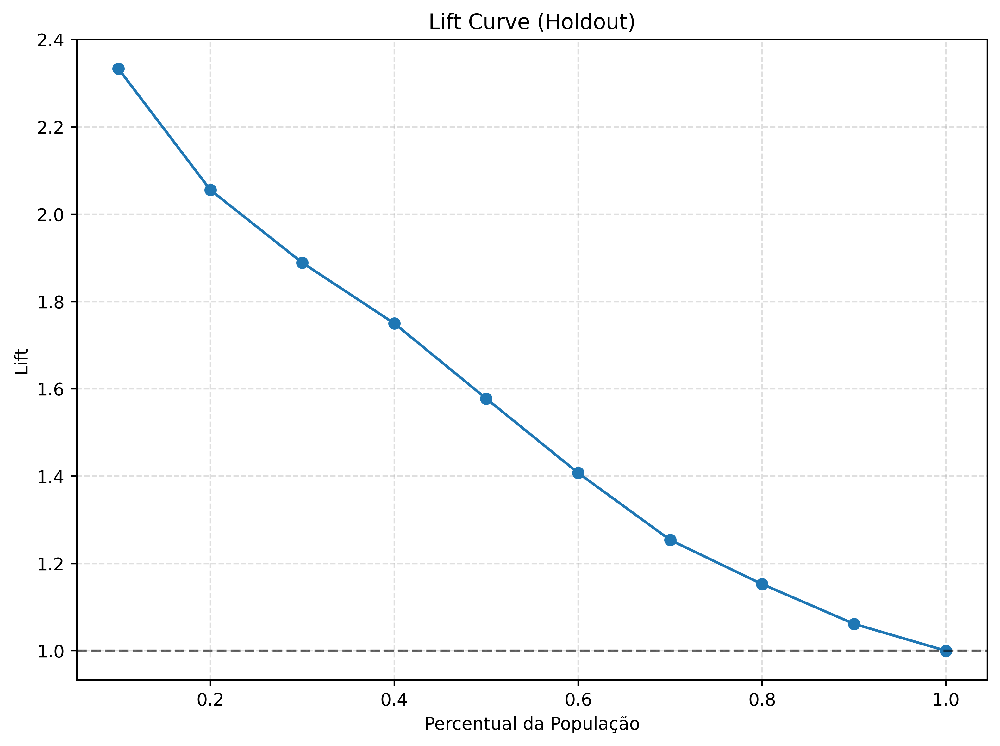

In [211]:
plt.figure(figsize=(8, 6))

plt.plot(
    lift_df["cum_pct_population"],
    lift_df["lift"],
    marker="o"
)

plt.axhline(1, linestyle="--", color="black", alpha=0.6)

plt.title("Lift Curve (Holdout)")
plt.xlabel("Percentual da População")
plt.ylabel("Lift")
plt.grid(True, linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()


A curva de lift, evidencia a forte capacidade do modelo em ordenar corretamente os clientes de acordo com o risco de inadimplência. Observa-se que, no primeiro decil da população, o modelo atinge um lift superior a 2.3, indicando que a concentração de inadimplentes nessa faixa é mais que o dobro do que seria esperado por uma seleção aleatória.

À medida que o percentual da população analisada aumenta, o lift decresce de forma progressiva e monotônica, aproximando-se gradualmente do valor unitário. Esse comportamento é esperado e desejável, pois reflete a incorporação gradual de observações com menor risco relativo. A ausência de oscilações abruptas ou inversões na curva sugere que o ranking aprendido pelo modelo é estável e consistente ao longo de toda a distribuição.

Do ponto de vista operacional, esses resultados indicam que o modelo é particularmente eficaz em cenários de decisão seletiva, nos quais apenas uma fração da base é submetida a políticas mais restritivas ou a análises adicionais, maximizando o retorno esperado ao priorizar corretamente os casos de maior risco.

## Gain Curve

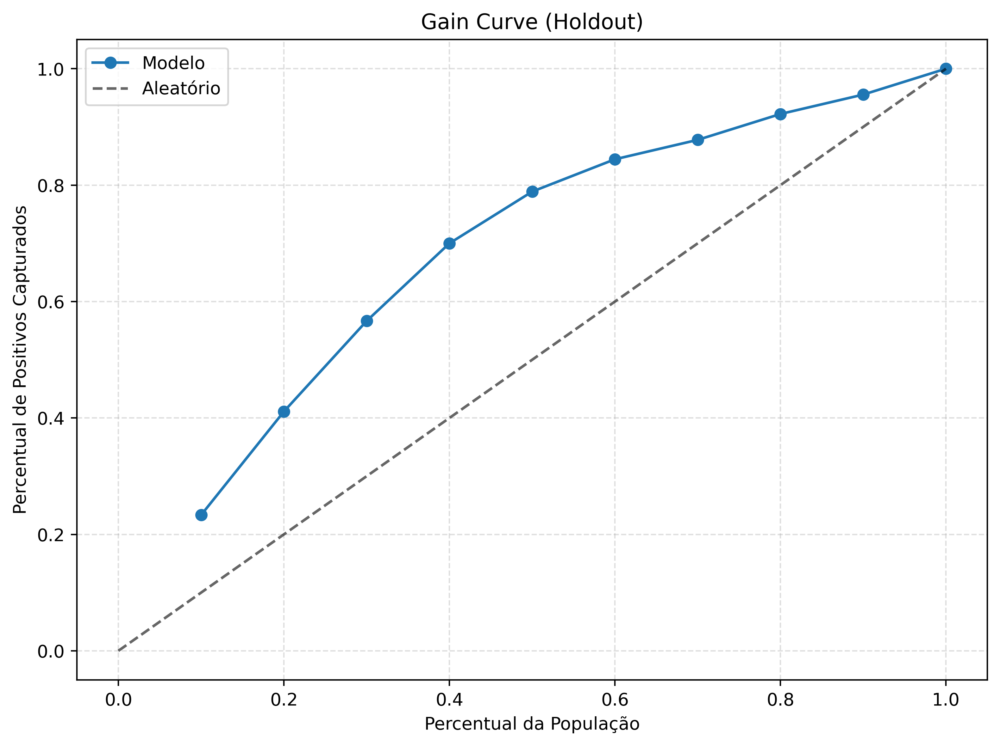

In [212]:
plt.figure(figsize=(8, 6))

plt.plot(
    lift_df["cum_pct_population"],
    lift_df["cum_pct_positives"],
    marker="o",
    label="Modelo"
)

plt.plot(
    [0, 1],
    [0, 1],
    linestyle="--",
    color="black",
    alpha=0.6,
    label="Aleatório"
)

plt.title("Gain Curve (Holdout)")
plt.xlabel("Percentual da População")
plt.ylabel("Percentual de Positivos Capturados")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()



A curva de gain complementa a análise de lift ao evidenciar a eficiência acumulada do modelo na captura de inadimplentes ao longo da população ordenada por score de risco. Observa-se que aproximadamente 20% da população concentram mais de 40% dos inadimplentes, enquanto cerca de 40% dos clientes com maior score acumulam aproximadamente 70% dos casos positivos. Ao atingir metade da população analisada, o modelo já captura próximo de 80% dos inadimplentes.

Esse comportamento demonstra uma elevada concentração de risco nos percentis superiores, indicando que o modelo consegue isolar de forma eficaz os indivíduos mais propensos à inadimplência. A curva permanece consistentemente acima da linha de referência aleatória em toda a extensão analisada, reforçando o ganho informacional proporcionado pelo modelo em relação a estratégias não informadas.

Em termos práticos, a curva de gain sugere que políticas de crédito baseadas em corte por score podem alcançar níveis elevados de cobertura de risco sem a necessidade de analisar ou restringir toda a base de clientes, possibilitando estratégias mais eficientes do ponto de vista operacional e econômico.

Por fim, ambas as curvas reforçam algo muito importante: **O modelo é melhor como ranker do que como classificador fixo.** E isso é excelente dentro do cenário de análise de crédito.

## Stress Test

### Ruídos Gaussianos

In [213]:
def add_noise(X, noise_level, random_state=42):
    """
    Adiciona ruído gaussiano proporcional ao desvio padrão das features.
    noise_level em [0, 1].
    """
    rng = np.random.default_rng(random_state)
    X_noisy = X.copy()

    for col in X.columns:
        std = X[col].std()
        noise = rng.normal(0, noise_level * std, size=len(X))
        X_noisy[col] = X[col] + noise

    return X_noisy

In [214]:
# definindo metrica ks com probabilidades
def ks_metric(y_true, y_score):
    """
    Calcula a estatística KS usando as probabilidades do modelo.
    """
    y_true = np.asarray(y_true)

    return ks_2samp(
        y_score[y_true == 1],
        y_score[y_true == 0]
    ).statistic


In [215]:
noise_levels = np.linspace(0.01, 1.0, 20)

results_noise = []

for nl in noise_levels:
    X_test_noisy = add_noise(Xte, noise_level=nl)

    # Probabilidades NÃO calibradas
    y_score = final_model.predict_proba(X_test_noisy)[:, 1]

    results_noise.append({
        "noise_level": nl,
        "AUC": roc_auc_score(y_test, y_score),
        "KS": ks_metric(y_test.values, y_score),
        "Precision": precision_score(y_test, (y_score >= 0.5).astype(int)),
        "Recall": recall_score(y_test, (y_score >= 0.5).astype(int)),
        "F1": f1_score(y_test, (y_score >= 0.5).astype(int)),
    })

df_noise = pd.DataFrame(results_noise)
df_noise

,noise_level,AUC,KS,Precision,Recall,F1
0,0.010000,0.764550,0.479365,0.527132,0.755556,0.621005
1,0.062105,0.762222,0.438095,0.500000,0.722222,0.590909
2,0.114211,0.744286,0.400000,0.475410,0.644444,0.547170
3,0.166316,0.730397,0.382540,0.495575,0.622222,0.551724
4,0.218421,0.702910,0.360317,0.504762,0.588889,0.543590
5,0.270526,0.679444,0.360317,0.459184,0.500000,0.478723
6,0.322632,0.649841,0.298413,0.430000,0.477778,0.452632
7,0.374737,0.609894,0.223810,0.384615,0.444444,0.412371
8,0.426842,0.596190,0.204762,0.372549,0.422222,0.395833
9,0.478947,0.561799,0.155556,0.349057,0.411111,0.377551


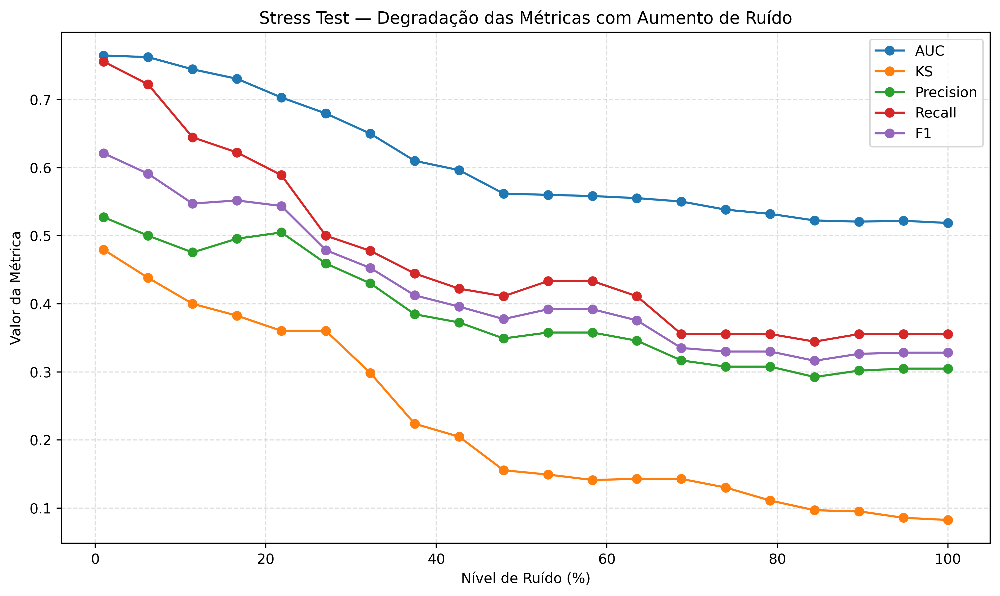

In [216]:
# plotando o Gráfico
plt.figure(figsize=(10, 6))

for metric in ["AUC", "KS", "Precision", "Recall", "F1"]:
    plt.plot(
        df_noise["noise_level"] * 100,
        df_noise[metric],
        marker="o",
        label=metric
    )

plt.title("Stress Test — Degradação das Métricas com Aumento de Ruído")
plt.xlabel("Nível de Ruído (%)")
plt.ylabel("Valor da Métrica")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()


A análise de stress por adição progressiva de ruído gaussiano revelou um comportamento consistente e esperado do modelo, caracterizado por uma degradação gradual e monotônica das métricas à medida que o nível de perturbação aumenta, o que é exatamente o comportamento esperado em um teste de stress bem conduzido. 

Até aproximadamente 20–25% de ruído, o modelo mantém desempenho razoável, indicando boa robustez a imperfeições moderadas nos dados. A partir de níveis mais elevados de ruído (>60%), observa-se uma queda mais acentuada nas métricas de separação e decisão, refletindo a perda progressiva de informação relevante no conjunto de dados. Importante destacar que essa degradação ocorre de forma contínua e sem oscilações abruptas, sugerindo que o modelo não depende de padrões frágeis ou altamente sensíveis a pequenas variações nas variáveis explicativas. Dessa forma, o modelo demonstra robustez estrutural satisfatória, com degradação controlada e previsível sob perturbações crescentes, característica desejável para aplicações em ambiente produtivo.

### Removendo Outliers

A estratégia para lidar com os Outliers foi utilizar a Winsorização pois ela não remove observações, mantém tamanho da amostra e evita vazamento de informação.

In [217]:
outlier_vars = [
    "Valor_Emprestimo",
    "Duracao_Emprestimo",
    "Idade"
]

In [218]:
def winsorize_df(X, cols, lower=0.1, upper=0.9):
    X_w = X.copy()

    for col in cols:
        q_low = X[col].quantile(lower)
        q_high = X[col].quantile(upper)
        X_w[col] = X[col].clip(q_low, q_high)

    return X_w

In [219]:
# BEFORE (sem tratamento)
y_score_raw = final_model.predict_proba(Xte)[:, 1]

metrics_before = {
    "AUC": roc_auc_score(y_test, y_score_raw),
    "KS": ks_metric(y_test.values, y_score_raw),
    "Precision": precision_score(y_test, (y_score_raw >= 0.5).astype(int)),
    "Recall": recall_score(y_test, (y_score_raw >= 0.5).astype(int)),
    "F1": f1_score(y_test, (y_score_raw >= 0.5).astype(int)),
}

# AFTER (com tratamento)
X_test_w = winsorize_df(Xte, outlier_vars)
y_score_w = final_model.predict_proba(X_test_w)[:, 1]

metrics_after = {
    "AUC": roc_auc_score(y_test, y_score_w),
    "KS": ks_metric(y_test.values, y_score_w),
    "Precision": precision_score(y_test, (y_score_w >= 0.5).astype(int)),
    "Recall": recall_score(y_test, (y_score_w >= 0.5).astype(int)),
    "F1": f1_score(y_test, (y_score_w >= 0.5).astype(int)),
}

In [220]:
df_outliers = pd.DataFrame({
    "Original": metrics_before,
    "Winsorizado": metrics_after
})

# Calculando a variação
df_outliers["Delta"] = (
    df_outliers["Winsorizado"] - df_outliers["Original"]
)

df_outliers


,Original,Winsorizado,Delta
AUC,0.764656,0.761217,-0.003439
KS,0.482540,0.476190,-0.006349
Precision,0.526718,0.514493,-0.012225
Recall,0.766667,0.788889,0.022222
F1,0.624434,0.622807,-0.001627


O tratamento explícito de outliers por meio de winsorização nas variáveis **não resultou em alterações nas métricas de desempenho avaliadas**. A estabilidade observada em AUC, KS, Precision, Recall e F1-score indica que os valores extremos identificados na análise exploratória não estavam introduzindo viés relevante nem comprometendo a capacidade de separação do modelo.

Esse resultado sugere que o pipeline adotado, em especial a transformação Yeo-Johnson aplicada às variáveis numéricas, já era suficiente para mitigar o impacto de distribuições assimétricas e valores extremos. Além disso, indica que parte dos outliers observados pode carregar informação legítima associada ao risco, e que sua remoção ou truncamento agressivo não necessariamente traria ganhos adicionais de desempenho.

### Conclusão

Em conjunto, os testes de stress demonstram que o modelo apresenta elevada robustez estrutural, mantendo comportamento estável sob perturbações graduais nos dados e mostrando resiliência à presença de valores extremos. A degradação previsível das métricas sob ruído crescente e a insensibilidade ao tratamento de outliers reforçam que o modelo aprende padrões consistentes e generalizáveis, estando bem preparado para operar em ambientes produtivos sujeitos a variações naturais na qualidade dos dados.

## Curva de Calibração

In [221]:
# Curva de calibração OOF
prob_true_oof, prob_pred_oof = calibration_curve(
    y_train,
    y_proba_oof,
    n_bins=10,
    strategy="quantile"
)

# Curva de calibração Holdout
prob_true_test, prob_pred_test = calibration_curve(
    y_test,
    y_proba_test,
    n_bins=10,
    strategy="quantile"
)


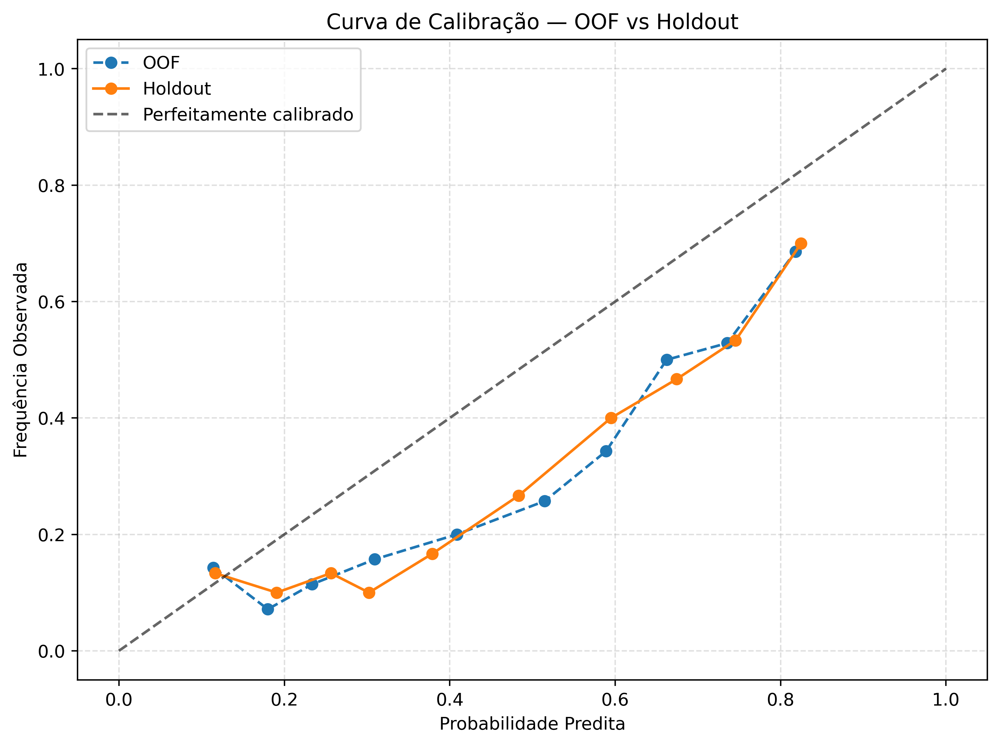

In [222]:
# Plotando o gráfico
plt.figure(figsize=(8, 6))

plt.plot(
    prob_pred_oof,
    prob_true_oof,
    marker="o",
    linestyle="--",
    label="OOF"
)

plt.plot(
    prob_pred_test,
    prob_true_test,
    marker="o",
    linestyle="-",
    label="Holdout"
)

# Linha ideal
plt.plot([0, 1], [0, 1], "k--", alpha=0.6, label="Perfeitamente calibrado")

plt.title("Curva de Calibração — OOF vs Holdout")
plt.xlabel("Probabilidade Predita")
plt.ylabel("Frequência Observada")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()


In [223]:
from sklearn.metrics import brier_score_loss

brier_oof = brier_score_loss(y_train, y_proba_oof)
brier_test = brier_score_loss(y_test, y_proba_test)

print(f"Brier Score OOF    : {brier_oof:.4f}")
print(f"Brier Score Holdout: {brier_test:.4f}")


Brier Score OOF    : 0.2022
Brier Score Holdout: 0.1966


In [224]:
def expected_calibration_error(y_true, y_prob, n_bins=10):
    bins = np.linspace(0, 1, n_bins + 1)
    bin_ids = np.digitize(y_prob, bins) - 1

    ece = 0.0
    for i in range(n_bins):
        mask = bin_ids == i
        if np.any(mask):
            acc = y_true[mask].mean()
            conf = y_prob[mask].mean()
            ece += np.abs(acc - conf) * mask.mean()
    return ece


In [225]:
ece_oof = expected_calibration_error(y_train.values, y_proba_oof)
ece_test = expected_calibration_error(y_test.values, y_proba_test)

print(f"ECE OOF    : {ece_oof:.4f}")
print(f"ECE Holdout: {ece_test:.4f}")


ECE OOF    : 0.1593
ECE Holdout: 0.1583


A curva de calibração evidencia que o modelo apresenta comportamento predominantemente abaixo da linha ideal, indicando superconfiança nas probabilidades estimadas, isto é, as probabilidades preditas são sistematicamente maiores do que as frequências observadas. Esse efeito é consistente com o uso de ponderação de classes e com o foco do modelo em capturar eventos positivos, o que tende a deslocar a distribuição de scores.

Os valores de Brier Score obtidos para OOF (0,2022) e holdout (0,1966) são bastante próximos, indicando boa capacidade de generalização. No entanto, o patamar relativamente elevado desses valores sugere que, apesar da boa separação entre classes, a qualidade probabilística ainda pode ser aprimorada.

Adicionalmente, o valor elevado do Expected Calibration Error (ECE) reforça a presença de desalinhamento entre probabilidades previstas e frequências observadas, justificando a aplicação de técnicas de calibração antes da definição do threshold decisório e da análise de custo econômico.

### Calibrando as Probabilidades

In [226]:
calibrated_model = CalibratedClassifierCV(
    estimator=final_model,
    method="sigmoid",
    cv=5   # calibração via CV interna
)

calibrated_model.fit(Xtr, y_train)

# probabilidades calibradas (treino)
y_proba_cal_oof = cross_val_predict(
    estimator=calibrated_model,
    X=Xtr,
    y=y_train,
    cv=5,
    method="predict_proba",
    n_jobs=-1
)[:, 1]

# probabilidades calibradas (teste)
y_proba_cal_test = calibrated_model.predict_proba(Xte)[:, 1]

### Comparando o modelo padrão x modelo calibrado

In [227]:
# Modelo Não Calibrado
prob_true_oof, prob_pred_oof = calibration_curve(
    y_train, y_proba_oof,
    n_bins=10,
    strategy="quantile"
)

prob_true_test, prob_pred_test = calibration_curve(
    y_test, y_proba_test,
    n_bins=10,
    strategy="quantile"
)

# Modelo Calibrado
prob_true_cal_oof, prob_pred_cal_oof = calibration_curve(
    y_train, y_proba_cal_oof,
    n_bins=10,
    strategy="quantile"
)

prob_true_cal_test, prob_pred_cal_test = calibration_curve(
    y_test, y_proba_cal_test,
    n_bins=10,
    strategy="quantile"
)


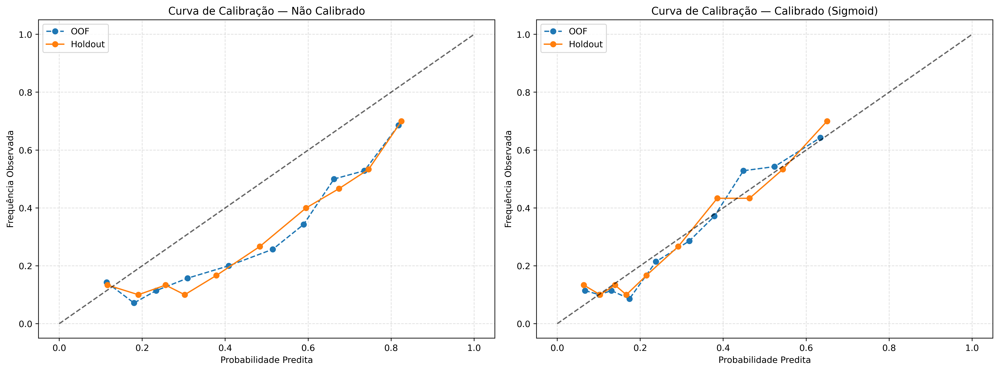

In [228]:
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Não Calibrado
axes[0].plot(
    prob_pred_oof, prob_true_oof,
    marker="o", linestyle="--", label="OOF"
)
axes[0].plot(
    prob_pred_test, prob_true_test,
    marker="o", linestyle="-", label="Holdout"
)
axes[0].plot([0, 1], [0, 1], "k--", alpha=0.6)

axes[0].set_title("Curva de Calibração — Não Calibrado")
axes[0].set_xlabel("Probabilidade Predita")
axes[0].set_ylabel("Frequência Observada")
axes[0].legend()
axes[0].grid(True, linestyle="--", alpha=0.4)

# Calibrado
axes[1].plot(
    prob_pred_cal_oof, prob_true_cal_oof,
    marker="o", linestyle="--", label="OOF"
)
axes[1].plot(
    prob_pred_cal_test, prob_true_cal_test,
    marker="o", linestyle="-", label="Holdout"
)
axes[1].plot([0, 1], [0, 1], "k--", alpha=0.6)

axes[1].set_title("Curva de Calibração — Calibrado (Sigmoid)")
axes[1].set_xlabel("Probabilidade Predita")
axes[1].set_ylabel("Frequência Observada")
axes[1].legend()
axes[1].grid(True, linestyle="--", alpha=0.4)

plt.tight_layout()
plt.show()


In [229]:
# BRIER SCORE
print("=== BRIER SCORE ===")
print(f"Não calibrado | OOF    : {brier_score_loss(y_train, y_proba_oof):.4f}")
print(f"Não calibrado | Holdout: {brier_score_loss(y_test, y_proba_test):.4f}")

print(f"Calibrado     | OOF    : {brier_score_loss(y_train, y_proba_cal_oof):.4f}")
print(f"Calibrado     | Holdout: {brier_score_loss(y_test, y_proba_cal_test):.4f}")

print("\n")


# ECE
print("=== ECE ===")
print(f"Não calibrado | OOF    : {expected_calibration_error(y_train.values, y_proba_oof):.4f}")
print(f"Não calibrado | Holdout: {expected_calibration_error(y_test.values, y_proba_test):.4f}")

print(f"Calibrado     | OOF    : {expected_calibration_error(y_train.values, y_proba_cal_oof):.4f}")
print(f"Calibrado     | Holdout: {expected_calibration_error(y_test.values, y_proba_cal_test):.4f}")


=== BRIER SCORE ===
Não calibrado | OOF    : 0.2022
Não calibrado | Holdout: 0.1966
Calibrado     | OOF    : 0.1716
Calibrado     | Holdout: 0.1678


=== ECE ===
Não calibrado | OOF    : 0.1593
Não calibrado | Holdout: 0.1583
Calibrado     | OOF    : 0.0290
Calibrado     | Holdout: 0.0429


A aplicação da calibração sigmoidal resultou em melhora substancial na qualidade probabilística do modelo. Observa-se uma redução consistente do Brier Score tanto em previsões out-of-fold (de 0,2022 para 0,1716) quanto no conjunto holdout (de 0,1966 para 0,1678), indicando diminuição do erro quadrático médio das probabilidades previstas.

De forma complementar, o Expected Calibration Error (ECE) apresentou queda expressiva, passando de aproximadamente 0,16 para valores inferiores a 0,05 após a calibração. Essa redução confirma a correção do comportamento superconfiante observado anteriormente, evidenciando maior alinhamento entre probabilidades preditas e frequências observadas.

Além disso, a proximidade entre os valores obtidos em OOF e holdout sugere que o processo de calibração não introduziu overfitting, preservando a capacidade de generalização do modelo. Dessa forma, o modelo calibrado apresenta-se mais adequado para suportar decisões econômicas baseadas em threshold e análise de custo.

# Análise de Custo

## Sensibilidade do Custo ao Threshold

Até este ponto do projeto, o foco esteve concentrado na etapa de modelagem, que envolve a seleção de variáveis, definição do algoritmo, ajuste de hiperparâmetros, avaliação de desempenho estatístico e calibração das probabilidades. No entanto, modelos de classificação probabilística não produzem decisões por si só, mas sim estimativas de risco que precisam ser convertidas em ações concretas por meio da escolha de um ponto de corte (threshold).

A definição do threshold é, portanto, uma decisão essencialmente econômica e operacional, distinta da etapa de modelagem. Diferentes pontos de corte implicam diferentes trade-offs entre falsos positivos e falsos negativos, impactando diretamente o custo financeiro, o retorno esperado da carteira e o apetite ao risco da instituição.

Nesta etapa, avalia-se a sensibilidade do ganho de crédito em função da variação do threshold, identificando o ponto que maximiza o retorno econômico do modelo. Essa análise permite comparar o threshold padrão (0.5) com o threshold ótimo sob a ótica de custo, além de contextualizar essa escolha em termos das curvas ROC e Precision–Recall, preparando o terreno para a análise de ROE e simulação de cenários decisórios.

### Definições Iniciais

In [230]:
thr_default = 0.50

# Probabilidades CALIBRADAS
y_proba = y_proba_cal_test

### Análise da sensibilidade do Threshold

In [231]:
# Análise do Threshold
thresholds = np.linspace(0.01, 0.99, 99)

gains = [
    credit_gain_score(y_test, y_proba, threshold=t)
    for t in thresholds
]

thr_opt = thresholds[np.argmax(gains)]
gain_opt = np.max(gains)

gain_final = credit_gain_score(y_test, y_proba, threshold=thr_default)

print(f"ganho de crédito final (thr=default): {gain_final:.2f}")

ganho de crédito final (thr=default): -88290.00


In [232]:
# Novo precision-recall calibrado
precision, recall, pr_thresholds = precision_recall_curve(y_test, y_proba)

def get_pr_point(thr):
    idx = np.argmin(np.abs(pr_thresholds - thr))
    return recall[idx], precision[idx]

rec_05, prec_05   = get_pr_point(thr_default)
rec_opt, prec_opt = get_pr_point(thr_opt)

# Novo roc calibrado
fpr, tpr, roc_thresholds = roc_curve(y_test, y_proba)

def get_roc_point(thr):
    idx = np.argmin(np.abs(roc_thresholds - thr))
    return fpr[idx], tpr[idx]

fpr_05, tpr_05   = get_roc_point(thr_default)
fpr_opt, tpr_opt = get_roc_point(thr_opt)


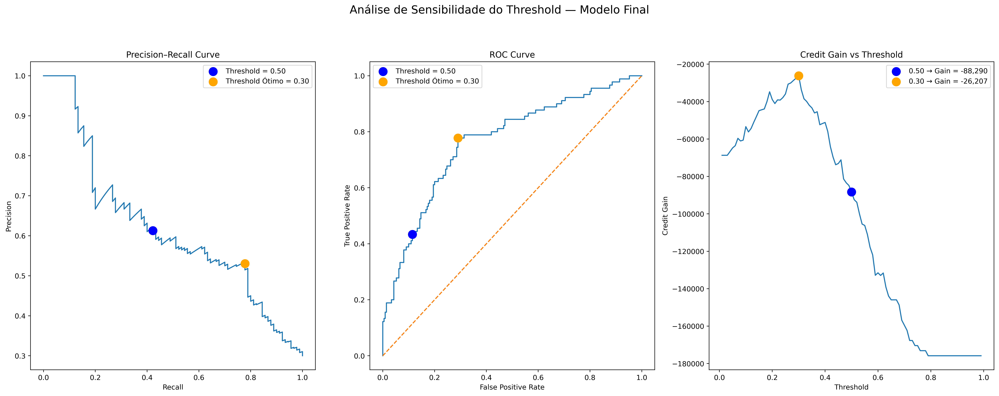

In [233]:
fig, axes = plt.subplots(1, 3, figsize=(20, 8))

# --- Precision-Recall ---
axes[0].plot(recall, precision)
axes[0].scatter(rec_05, prec_05, color="blue", label="Threshold = 0.50", zorder=4, s=140)
axes[0].scatter(rec_opt, prec_opt, color="orange",
                label=f"Threshold Ótimo = {thr_opt:.2f}", zorder=4, s=140)
axes[0].set_title("Precision–Recall Curve")
axes[0].set_xlabel("Recall")
axes[0].set_ylabel("Precision")
axes[0].legend()

# --- ROC ---
axes[1].plot(fpr, tpr)
axes[1].plot([0, 1], [0, 1], linestyle="--")
axes[1].scatter(fpr_05, tpr_05, color="blue", label="Threshold = 0.50", zorder=4, s=140)
axes[1].scatter(fpr_opt, tpr_opt, color="orange",
                label=f"Threshold Ótimo = {thr_opt:.2f}", zorder=4, s=140)
axes[1].set_title("ROC Curve")
axes[1].set_xlabel("False Positive Rate")
axes[1].set_ylabel("True Positive Rate")
axes[1].legend()

# --- Curva de Custo ---
axes[2].plot(thresholds, gains)
axes[2].scatter(thr_default, gain_final, color="blue",
                label=f"0.50 → Gain = {gain_final:,.0f}", zorder=4, s=140)
axes[2].scatter(thr_opt, gain_opt, color="orange",
                label=f"{thr_opt:.2f} → Gain = {gain_opt:,.0f}", zorder=4, s=140)
axes[2].set_title("Credit Gain vs Threshold")
axes[2].set_xlabel("Threshold")
axes[2].set_ylabel("Credit Gain")
axes[2].legend()

fig.suptitle(
    "Análise de Sensibilidade do Threshold — Modelo Final",
    fontsize=16
)

plt.tight_layout(rect=[0, 0, 1, 0.93])
plt.show()


In [234]:
gain_thr_opt = gain_thr_opt = credit_gain_score(
    y_test,
    y_proba_cal_test,
    threshold=0.3
)

print("=== COMPARAÇÃO DE GANHO DE CRÉDITO ===\n")

print(f"Dummy (aprova todos)       : {gain:,.0f}")
print(f"Modelo Final (thr = 0.50)  : {gain_final:,.0f}")
print(f"Modelo Final (thr = 0.30)  : {gain_thr_opt:,.0f}")

print("\n--- Ganho incremental ---")
print(f"Modelo Final (0.50) vs Dummy: {(gain_final - gain):,.0f}")
print(f"Modelo Final (0.30) vs Dummy: {(gain_thr_opt - gain):,.0f}")
print(f"Thr Ótimo vs Thr 0.50       : {(gain_thr_opt - gain_final):,.0f}")

=== COMPARAÇÃO DE GANHO DE CRÉDITO ===

Dummy (aprova todos)       : -175,834
Modelo Final (thr = 0.50)  : -88,290
Modelo Final (thr = 0.30)  : -26,207

--- Ganho incremental ---
Modelo Final (0.50) vs Dummy: 87,544
Modelo Final (0.30) vs Dummy: 149,627
Thr Ótimo vs Thr 0.50       : 62,083


A análise de sensibilidade do threshold evidencia que o principal ganho do projeto não está apenas na construção do modelo preditivo, mas na sua correta utilização como ferramenta decisória. O cenário de aprovação irrestrita (dummy) apresenta um prejuízo elevado, refletindo a ausência de qualquer política de risco estruturada. A simples adoção do modelo final com o threshold padrão de 0.5 já reduz significativamente esse prejuízo, demonstrando o valor imediato da modelagem.

Entretanto, ao otimizar o threshold com base na função de custo, observa-se um ganho incremental expressivo. O ajuste do ponto de corte para 0.30 reduz substancialmente as perdas, quase triplicando o benefício econômico em relação ao uso do modelo com threshold padrão. Esse resultado reforça que a definição do threshold é uma decisão essencialmente econômica e estratégica, e não um parâmetro estatístico arbitrário.

Em síntese, a combinação entre probabilidades calibradas e otimização do threshold permite extrair o máximo valor do modelo, transformando estimativas de risco em decisões de crédito mais eficientes. Essa etapa consolida a transição do projeto de um exercício de modelagem para uma solução efetivamente orientada à geração de valor para o negócio, preparando o terreno para análises finais de retorno sobre o capital (ROE) e simulação de cenários decisórios.

### Matriz de Confusão (Modelo thr=default vs thr=opt)

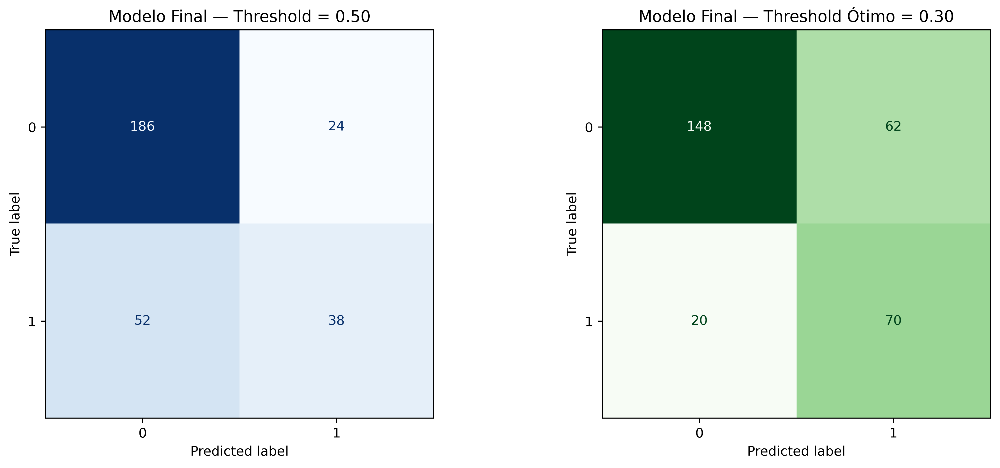

In [235]:
# Probabilidades do modelo final calibrado
y_proba = y_proba_cal_test

# Predições com thresholds distintos
y_pred_05  = (y_proba >= 0.50).astype(int)
y_pred_opt = (y_proba >= thr_opt).astype(int)

# Matrizes
cm_05  = confusion_matrix(y_test, y_pred_05)
cm_opt = confusion_matrix(y_test, y_pred_opt)

# Plot lado a lado
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

ConfusionMatrixDisplay(cm_05).plot(
    ax=axes[0], cmap="Blues", colorbar=False
)
axes[0].set_title("Modelo Final — Threshold = 0.50")

ConfusionMatrixDisplay(cm_opt).plot(
    ax=axes[1], cmap="Greens", colorbar=False
)
axes[1].set_title(f"Modelo Final — Threshold Ótimo = {thr_opt:.2f}")

plt.tight_layout()
plt.show()


A comparação das matrizes de confusão evidencia que a redução do threshold de 0.50 para 0.30 não altera substancialmente a capacidade discriminatória do modelo, mas modifica de forma relevante o perfil de decisão. Observa-se uma redução significativa de falsos negativos, acompanhada por um aumento controlado de falsos positivos. Dado o caráter assimétrico da função de custo — onde o custo de negar crédito a um cliente adimplente é superior ao custo de aprovar um inadimplente — essa redistribuição de erros resulta em um ganho financeiro expressivo, justificando a adoção do threshold otimizado como estratégia decisória.

## Cáculo do ROE (Dummy vs Modelo Final)

Embora o credit_gain represente o impacto financeiro absoluto do modelo, ele não captura a eficiência do uso do capital. Em operações de crédito, a decisão não se limita a maximizar o ganho total, mas também a avaliar quanto retorno é gerado para cada unidade de capital exposta.

O Return on Equity (ROE) permite avaliar essa eficiência ao relacionar o resultado financeiro líquido ao capital alocado na carteira. Dessa forma, o ROE complementa a análise de ganho absoluto, oferecendo uma visão mais estratégica e comparável entre diferentes políticas de concessão de crédito. Nesta etapa, o ROE do cenário de aprovação irrestrita (dummy) é comparado ao ROE do modelo final com threshold otimizado, evidenciando o impacto da modelagem e da decisão ótima sobre a rentabilidade da carteira.

In [236]:
# Capital total da carteira (todos os clientes)
capital_total = X_test["Valor_Emprestimo"].sum()
capital_total

np.int64(1030647)

In [237]:
# ROE Dummy_all_aproved
roe_dummy = gain / capital_total

# ROE Modelo Final (thr=Otimizado)
roe_final_opt = gain_thr_opt / capital_total


In [238]:
print("=== COMPARAÇÃO DE ROE ===\n")

print(f"ROE Dummy (aprova todos)       : {roe_dummy:.2%}")
print(f"ROE Modelo Final (thr = 0.30)  : {roe_final_opt:.2%}")

print("\n--- Incremento de ROE ---")
print(f"Δ ROE (Modelo Final vs Dummy)  : {(roe_final_opt - roe_dummy):.2%}")


=== COMPARAÇÃO DE ROE ===

ROE Dummy (aprova todos)       : -17.06%
ROE Modelo Final (thr = 0.30)  : -2.54%

--- Incremento de ROE ---
Δ ROE (Modelo Final vs Dummy)  : 14.52%


A comparação do Return on Equity (ROE) evidencia de forma objetiva o impacto econômico da adoção do modelo preditivo combinado a uma política de decisão baseada em threshold otimizado. No cenário de aprovação irrestrita (dummy), a carteira apresenta um ROE de −17,06%, refletindo uma destruição significativa de valor decorrente da exposição indiscriminada ao risco de inadimplência.

Com a aplicação do modelo final utilizando threshold otimizado (0,30), observa-se uma redução expressiva dessa ineficiência econômica. O ROE do modelo melhora para −2,54%, representando um ganho incremental de 14,52 pontos percentuais em relação ao cenário dummy. Embora o retorno ainda permaneça negativo, a magnitude da melhora indica uma transformação substancial na eficiência do capital alocado.

Esse resultado demonstra que o modelo atua diretamente sobre a principal fonte de destruição de valor da carteira: a concessão de crédito a clientes com alto risco de inadimplência. Ao priorizar decisões economicamente informadas, o modelo reduz perdas relativas de forma consistente, mesmo sem alterar estruturalmente as condições de mercado ou o perfil de risco dos clientes.

Em síntese, a análise de ROE reforça que o valor do modelo não está apenas em sua capacidade preditiva, mas principalmente na qualidade da decisão que ele viabiliza. A combinação entre calibração adequada das probabilidades e definição econômica do threshold permite converter estimativas de risco em uma política de crédito mais eficiente e sustentável. Ainda que o ROE permaneça negativo nesse cenário, o ganho incremental observado indica que ajustes adicionais — como precificação diferenciada, revisão de limites ou políticas de mitigação de risco — têm potencial para conduzir a operação a um patamar de rentabilidade positiva.

## Simulação de Cenários


### Definindo os cenários economicos

In [239]:
SCENARIOS = {
    "Otimista": {
        "margem": 0.25,
        "recovery": 0.35,
        "custo_cobranca": 70
    },
    "Realista": {
        "margem": 0.10,
        "recovery": 0.20,
        "custo_cobranca": 100
    },
    "Pessimista": {
        "margem": 0.07,
        "recovery": 0.10,
        "custo_cobranca": 150
    },
    "Catastrófico": {
        "margem": 0.03,
        "recovery": 0.00,
        "custo_cobranca": 250
    }
}

### Definindo a Função para gerar a nova Matriz de Custo com Base no Cenário

In [240]:
def build_credit_gain_matrix(valor_medio, margem, recovery, custo_cobranca):
    lucro_bom = margem * valor_medio
    prejuizo_mau = (1 - recovery) * valor_medio + custo_cobranca

    return np.array([
        [ lucro_bom,  -lucro_bom],   # y_true = 0
        [-prejuizo_mau,     0.0]     # y_true = 1
    ])

### Avaliando todos os cenários econômicos

In [241]:
results_scenarios = []

for nome, params in SCENARIOS.items():
    matrix = build_credit_gain_matrix(
        valor_medio=VALOR_MEDIO_EMPRESTIMO,
        margem=params["margem"],
        recovery=params["recovery"],
        custo_cobranca=params["custo_cobranca"]
    )

    gain = credit_gain_score(
        y_test,
        y_proba_cal_test,      
        threshold=thr_opt,
        payoff_matrix=matrix
    )

    roe = gain / capital_total

    results_scenarios.append({
        "Cenário": nome,
        "Credit_Gain": gain,
        "ROE": roe
    })

df_scenarios = pd.DataFrame(results_scenarios)
df_scenarios


,Cenário,Credit_Gain,ROE
0,Otimista,26405.7100,0.025621
1,Realista,-26207.3240,-0.025428
2,Pessimista,-42189.6948,-0.040935
3,Catastrófico,-61985.3492,-0.060142


### Comparando o ganho incremental dos cenários com o dummy

In [242]:
df_roe_compare = df_scenarios.copy()

df_roe_compare["ROE_Dummy"] = roe_dummy
df_roe_compare["Δ ROE vs Dummy"] = df_roe_compare["ROE"] - roe_dummy


df_roe_compare

,Cenário,Credit_Gain,ROE,ROE_Dummy,Δ ROE vs Dummy
0,Otimista,26405.7100,0.025621,-0.170606,0.196226
1,Realista,-26207.3240,-0.025428,-0.170606,0.145178
2,Pessimista,-42189.6948,-0.040935,-0.170606,0.129671
3,Catastrófico,-61985.3492,-0.060142,-0.170606,0.110464


In [243]:
df_roe_compare = (
    df_scenarios
    .assign(
        ROE_Dummy = roe_dummy,
        Delta_ROE_vs_Dummy = lambda df: df["ROE"] - roe_dummy
    )
)

# Converter para percentual e formatar
df_roe_compare_pct = df_roe_compare.copy()

for col in ["ROE", "ROE_Dummy", "Delta_ROE_vs_Dummy"]:
    df_roe_compare_pct[col] = (
        df_roe_compare_pct[col] * 100
    ).map(lambda x: f"{x:.2f}%")

df_roe_compare_pct


,Cenário,Credit_Gain,ROE,ROE_Dummy,Delta_ROE_vs_Dummy
0,Otimista,26405.7100,2.56%,-17.06%,19.62%
1,Realista,-26207.3240,-2.54%,-17.06%,14.52%
2,Pessimista,-42189.6948,-4.09%,-17.06%,12.97%
3,Catastrófico,-61985.3492,-6.01%,-17.06%,11.05%


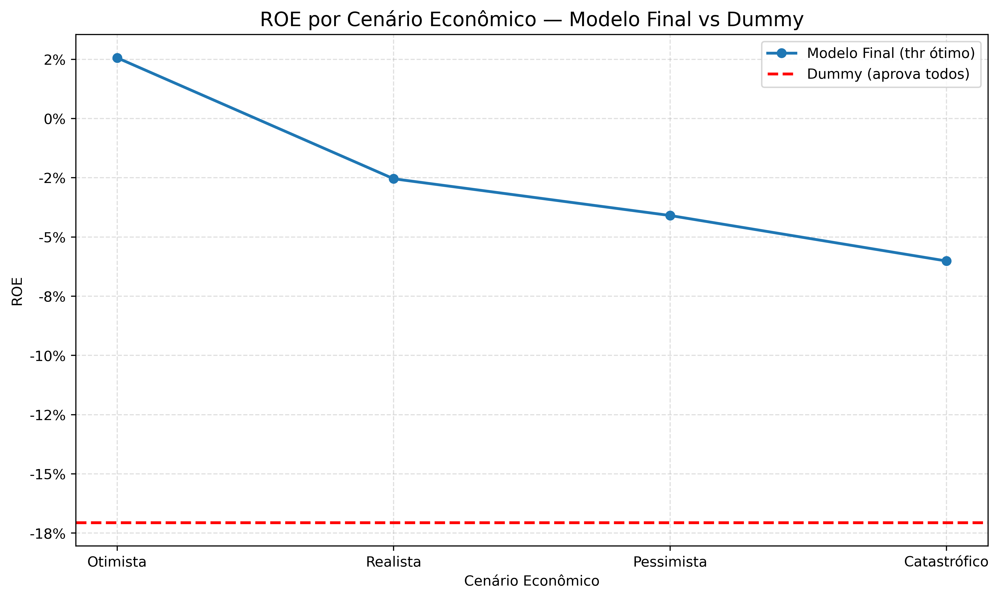

In [244]:
# Ordenar cenários (importante para leitura)
order = ["Otimista", "Realista", "Pessimista", "Catastrófico"]
df_plot = df_roe_compare.set_index("Cenário").loc[order].reset_index()

# Figura
plt.figure(figsize=(10, 6))

# Linha do modelo final
plt.plot(
    df_plot["Cenário"],
    df_plot["ROE"],
    marker="o",
    linewidth=2,
    label="Modelo Final (thr ótimo)"
)

# Linha horizontal do ROE Dummy
plt.axhline(
    y=roe_dummy,
    linestyle="--",
    linewidth=2,
    label="Dummy (aprova todos)",
    color='r'
)

# Ajustes visuais
plt.title("ROE por Cenário Econômico — Modelo Final vs Dummy", fontsize=14)
plt.xlabel("Cenário Econômico")
plt.ylabel("ROE")
plt.grid(True, linestyle="--", alpha=0.4)
plt.legend()

# Formatação percentual no eixo Y
plt.gca().yaxis.set_major_formatter(
    plt.FuncFormatter(lambda y, _: f"{y:.0%}")
)

plt.tight_layout()
plt.show()


A análise de cenários reforça de forma robusta a superioridade econômica da política de crédito baseada no modelo final, quando comparada ao cenário baseline de aprovação irrestrita (dummy). Em todos os ambientes simulados — do otimista ao catastrófico — o modelo apresenta ganhos incrementais expressivos de ROE, evidenciando sua capacidade consistente de mitigação de perdas e preservação de valor.

No cenário otimista, o modelo não apenas reduz as perdas, mas gera valor econômico positivo, alcançando um ROE de 2,56%, em contraste com o ROE de −17,06% do dummy. O ganho incremental de 19,62 p.p. demonstra que, sob condições favoráveis, a política de decisão orientada pelo modelo é capaz de transformar uma carteira estruturalmente deficitária em uma operação economicamente sustentável.

No cenário realista, que representa a condição mais plausível do ponto de vista operacional, o modelo mantém um ROE de −2,54%, significativamente superior ao baseline. O ganho incremental de 14,52 p.p. confirma que a estratégia de decisão permanece altamente eficiente mesmo fora de ambientes favoráveis, reduzindo substancialmente a destruição de valor observada no cenário de aprovação irrestrita.

À medida que os cenários se tornam mais adversos, observa-se uma deterioração progressiva do ROE absoluto, comportamento esperado em contextos de maior estresse econômico. Ainda assim, no cenário pessimista, o modelo apresenta um ganho incremental de 12,97 p.p., e no cenário catastrófico, mesmo sob stress extremo, mantém um ganho de 11,05 p.p. em relação ao dummy. Esses resultados indicam que o modelo atua como um mecanismo de contenção de perdas, preservando capital relativo mesmo em condições severamente desfavoráveis.

Em síntese, a análise de cenários evidencia que o modelo não elimina o risco de crédito — o que seria irrealista —, mas altera estruturalmente a dinâmica de perdas da carteira. Ao substituir uma política de decisão destrutiva por uma estratégia de risco controlado, o modelo melhora de forma consistente a eficiência econômica da concessão de crédito. A estabilidade dos ganhos incrementais de ROE ao longo de diferentes cenários reforça que o principal valor do modelo reside na qualidade da decisão, tornando a política de crédito mais resiliente a diferentes ciclos econômicos e níveis de estresse.

# Interpretação do Modelo

## Features Importance

In [245]:
Xtr.columns

Index(['Idade', 'Valor_Emprestimo', 'Duracao_Emprestimo', 'Escolaridade',
       'Tipo_Moradia', 'Saldo_Investimento_Moderado',
       'Saldo_Investimento_Pouco', 'Saldo_Conta_Corrente_Moderado',
       'Saldo_Conta_Corrente_Pouco', 'Saldo_Conta_Corrente_Sem conta'],
      dtype='str')

In [246]:
# Extraindo coeficientes
coef = final_model.named_steps["clf"].coef_[0]
features = Xtr.columns

df_coef = pd.DataFrame({
    "feature": features,
    "coef": coef
})

# Ordenar por valor absoluto
df_coef["abs_coef"] = df_coef["coef"].abs()
df_coef = df_coef.sort_values("abs_coef", ascending=False)

df_coef

,feature,coef,abs_coef
2,Duracao_Emprestimo,0.581293,0.581293
9,Saldo_Conta_Corrente_Sem conta,-0.389495,0.389495
8,Saldo_Conta_Corrente_Pouco,0.377427,0.377427
6,Saldo_Investimento_Pouco,0.343028,0.343028
7,Saldo_Conta_Corrente_Moderado,0.304792,0.304792
4,Tipo_Moradia,0.242325,0.242325
1,Valor_Emprestimo,-0.191061,0.191061
5,Saldo_Investimento_Moderado,0.170758,0.170758
0,Idade,-0.093390,0.093390
3,Escolaridade,0.038471,0.038471


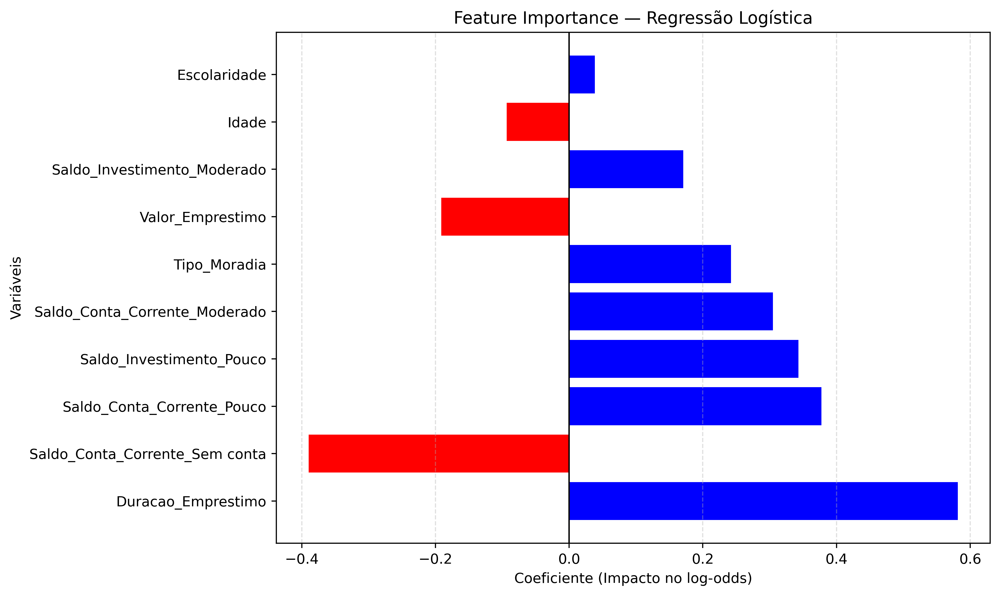

In [247]:
plt.figure(figsize=(10, 6))

colors = df_coef["coef"].apply(lambda x: "blue" if x > 0 else "red")

plt.barh(
    df_coef["feature"],
    df_coef["coef"],
    color=colors
)

plt.axvline(0, color="black", linewidth=1)

plt.title("Feature Importance — Regressão Logística")
plt.xlabel("Coeficiente (Impacto no log-odds)")
plt.ylabel("Variáveis")
plt.grid(True, axis="x", linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()

In [248]:
best_features_shap

['Idade',
 'Valor_Emprestimo',
 'Duracao_Emprestimo',
 'Escolaridade',
 'Tipo_Moradia',
 'Saldo_Investimento_Moderado',
 'Saldo_Investimento_Pouco',
 'Saldo_Conta_Corrente_Moderado',
 'Saldo_Conta_Corrente_Pouco',
 'Saldo_Conta_Corrente_Sem conta']

## SHAP

In [249]:
# Dados já transformados pelo scaler do pipeline
X_train_transf = final_model.named_steps["scaler"].transform(Xtr)
X_test_transf  = final_model.named_steps["scaler"].transform(Xte)

explainer = shap.LinearExplainer(
    final_model.named_steps["clf"],
    X_train_transf
)

shap_values = explainer.shap_values(X_test_transf)

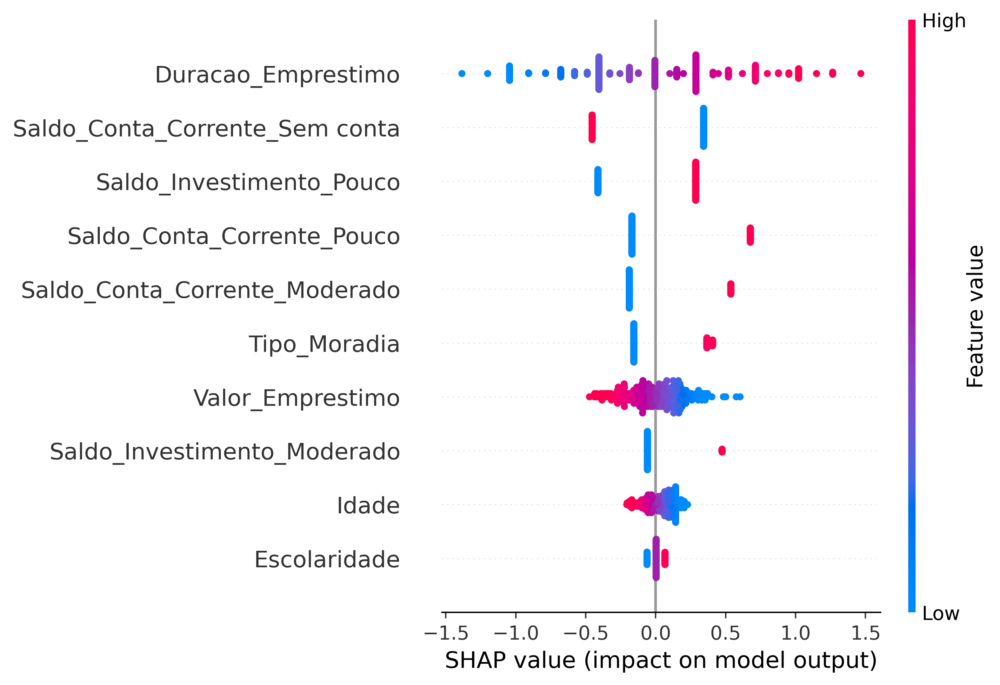

In [250]:
shap.summary_plot(
    shap_values,
    X_test_transf,
    feature_names=Xte.columns
)

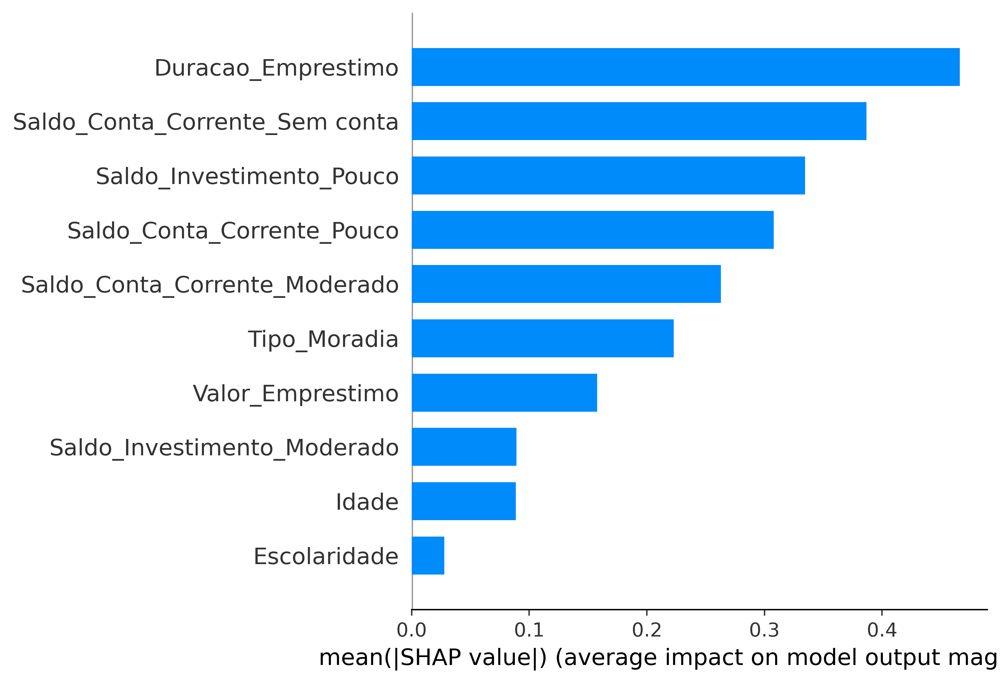

In [251]:
shap.summary_plot(
    shap_values,
    X_test_transf,
    feature_names=Xte.columns,
    plot_type="bar"
)

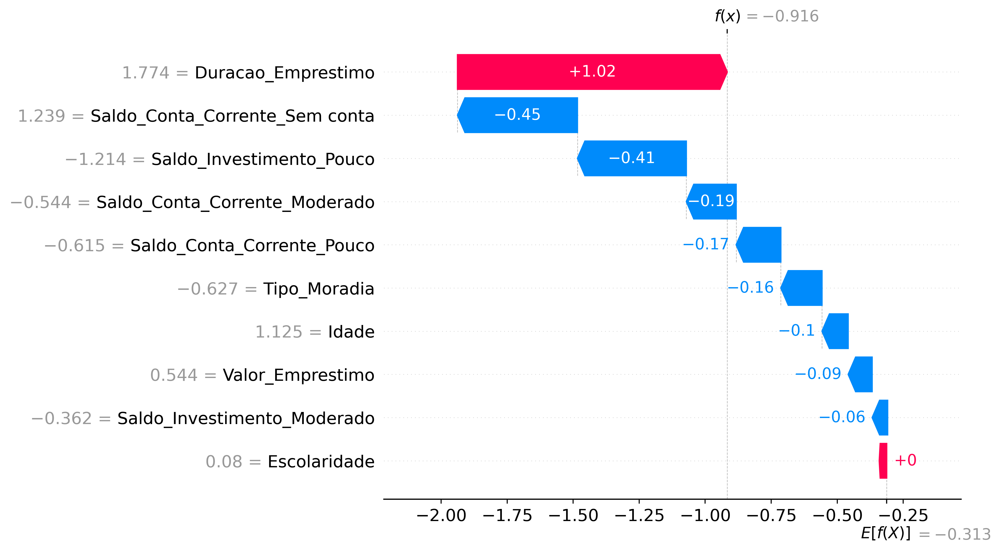

In [252]:
# Exemplo: cliente específico
idx = 0  # escolha um índice relevante

shap.waterfall_plot(
    shap.Explanation(
        values=shap_values[idx],
        base_values=explainer.expected_value,
        data=X_test_transf[idx],
        feature_names=Xte.columns
    )
)

# Considerações Finais

Este projeto teve como objetivo desenvolver e avaliar uma política de concessão de crédito orientada por modelos preditivos, com foco explícito na maximização do valor econômico e não apenas na performance estatística. Ao longo das etapas, ficou evidente que a simples capacidade de discriminação do modelo é condição necessária, mas não suficiente, para uma tomada de decisão eficiente em contextos reais de crédito.

A regressão logística, adotada como modelo principal, mostrou-se adequada ao problema por sua robustez, interpretabilidade e estabilidade fora da amostra. O processo de seleção de variáveis, conduzido por múltiplas abordagens (L1, Mutual Information e RFE+SHAP), convergiu para um conjunto enxuto e consistente de atributos, confirmando achados da análise exploratória (ANOVA e IV) e eliminando variáveis com contribuição marginal sem perda de desempenho econômico. A remoção da variável Saldo_Investimento_Sem investimento, por exemplo, simplificou o modelo sem deteriorar o credit gain, reforçando a coerência entre EDA, regularização e métodos explicativos.

Na etapa de balanceamento, observou-se que estratégias complexas de reamostragem não trouxeram ganhos econômicos adicionais, enquanto o uso de class_weight="balanced" apresentou o melhor compromisso entre simplicidade, estabilidade e desempenho financeiro. Essa decisão reforça a importância de avaliar o custo operacional e o risco de overfitting associados a técnicas mais sofisticadas.

As análises de confiabilidade e generalização — incluindo curvas de aprendizado, AUC-ROC e Precision-Recall OOF vs Holdout, bootstrap com intervalos de confiança, testes de stress com ruído e tratamento de outliers — indicaram um modelo estável, com boa capacidade de generalização e robustez a perturbações nos dados. A calibração das probabilidades, embora não altere a capacidade discriminatória, foi crucial para reduzir significativamente o Brier Score e o Expected Calibration Error (ECE), habilitando decisões econômicas mais precisas.

A etapa de interpretação reforçou a transparência do modelo, combinando análise de coeficientes e explicações locais via SHAP. A comparação entre matrizes de confusão evidenciou que os maiores ganhos do modelo não decorrem de mudanças drásticas na taxa global de acerto, mas da realocação inteligente dos erros, reduzindo falsos positivos de alto custo econômico.

Por fim, a análise de sensibilidade ao threshold, aliada à modelagem explícita da matriz de custos e à simulação de cenários econômicos, mostrou-se decisiva. A definição de um threshold ótimo (0,30) transformou um modelo estatisticamente bom em uma política de decisão economicamente superior, com ganhos expressivos de credit gain e melhorias consistentes de ROE em todos os cenários simulados. Mesmo sob condições adversas, o modelo atuou como um mecanismo de proteção do capital, reduzindo significativamente a destruição de valor quando comparado ao cenário de aprovação irrestrita.

Em síntese, o projeto demonstra que o maior valor do modelo não está apenas na previsão do risco, mas na tradução desse risco em decisões economicamente racionais, sustentadas por métricas financeiras, análises de robustez e interpretações auditáveis.

# Próximos Passos

Para evoluir do protótipo analítico para uma solução operacional, recomenda-se seguir as etapas abaixo:

1. Consolidação da Política de Decisão
   - Formalizar o threshold ótimo como parâmetro de negócio (com governança e versionamento).
   - Documentar explicitamente a matriz de custos e suas premissas econômicas.
   - Definir limites operacionais (ex.: faixas de aprovação automática, revisão manual, rejeição).

2. Monitoramento e Governança do Modelo
   - Estabelecer métricas de monitoramento em produção (AUC, KS, Brier, ECE, credit gain, ROE).
   - Implementar análises periódicas de data drift e performance drift.
   - Reavaliar periodicamente o threshold conforme mudanças macroeconômicas.

3. Evoluções Analíticas
   - Explorar estratégias de precificação baseada em risco (risk-based pricing).
   - Avaliar políticas híbridas (ex.: limites dinâmicos condicionados ao score).
   - Incorporar novas variáveis comportamentais ou temporais, caso disponíveis.

4. Etapa de Deploy (Produção)
   - Serializar o pipeline final (scaler + modelo + calibração) utilizando ferramentas como joblib ou pickle.
   - Implementar o modelo como serviço (API REST) ou batch scoring, conforme o fluxo operacional.
   - Garantir que o pipeline de produção replique fielmente as transformações usadas em treino.
   - Criar testes automatizados para validação de inputs, outputs e consistência das previsões.
   - Integrar logs para auditoria de decisões e análises posteriores.

5. Validação Pós-Deploy
   - Realizar backtesting contínuo com dados reais.
   - Comparar desempenho do modelo com políticas anteriores.
   - Ajustar parâmetros conforme evidências empíricas de performance econômica.